In [ ]:
import torch
import torch.nn as nn
import torch.nn.functional as F
from torch.utils.data import DataLoader

import torchvision.transforms as transforms
import torchvision.utils
from torchvision.utils import make_grid

import torchvision.datasets

import matplotlib.pyplot as plt 
plt.rcParams["figure.figsize"] = (10,6)

from tqdm import tqdm 

device = torch.device("cuda:0" if torch.cuda.is_available() else "cpu")


# Introduction to GANs

In this notebook you will build a GAN from scratch, grossly following the DCGAN architecture. 

**Goals:**


1.   Build a GAN arhictecture from scratch
2.   Write the GAN loss function and train GAN from scratch
3.   Have experience with some of the instability problems inherent with training GANs.
4.   [Bonus] Extend the unconditional GAN into a conditional GAN. 



## 1. Getting Started

We will work with the [MNIST](http://yann.lecun.com/exdb/mnist/) dataset. It contains 60,000 images size 28x28 of handwritten digits, from 0 to 9.

## 1. Dataloading

### 1.1 Define some hyperparameters and transforms


In [ ]:
batch_size = 128 # Images per batch

# Resize to 32x32 for easier upsampling/downsampling
mytransform = transforms.Compose([transforms.Resize(32),
                                  transforms.ToTensor(),
                                  transforms.Normalize((.5), (.5))]) # normalize between [-1, 1] with tanh activation

mnist_train = torchvision.datasets.MNIST(root='.', download=True, transform=mytransform)

  0%|          | 0/9912422 [00:00<?, ?it/s]

Extracting ./MNIST/raw/train-images-idx3-ubyte.gz to ./MNIST/raw



  0%|          | 0/28881 [00:00<?, ?it/s]

Extracting ./MNIST/raw/train-labels-idx1-ubyte.gz to ./MNIST/raw



  0%|          | 0/1648877 [00:00<?, ?it/s]

Extracting ./MNIST/raw/t10k-images-idx3-ubyte.gz to ./MNIST/raw



  0%|          | 0/4542 [00:00<?, ?it/s]

Extracting ./MNIST/raw/t10k-labels-idx1-ubyte.gz to ./MNIST/raw



In [ ]:
dataloader = DataLoader(dataset=mnist_train, 
                         batch_size=batch_size,
                         shuffle=True)    

In [ ]:
# plot some images
real_batch, real_labels = next(iter(dataloader))

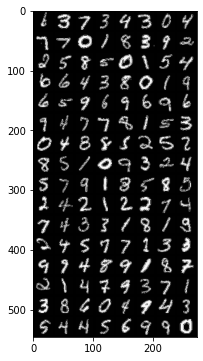

In [ ]:
plt.imshow(transforms.ToPILImage()(make_grid(real_batch)))

## 2. Model Architecture

We will follow the general architecture of a DCGAN - or deep convolutional GAN. This [influential paper](https://arxiv.org/pdf/1511.06434v2.pdf) produced much of the foundation for modern GANs and how to train them.

(GANs are notoriously **hard** to train, we will try to get a feeling why in this notebook.)


Complete the function `get_upscaling_block`. Then, use the function to define our model defined as follows:

Input: Random "noise" $z$ shaped `[n_batch, n_z]`

Output: Generated image size `[n_batch, 1, 32, 32]` in range [-1, 1]

1. Reshape z into `[n_batch, n_z, 1, 1]` to make it into an "image"
2. First upscaling block $\rightarrow$ `[n_batch, ngf*4, 4, 4]`
3. Second upscaling block $\rightarrow$ `[n_batch, ngf*2, 8, 8]`
4. Third upscaling block $\rightarrow$ `[n_batch, ngf, 16, 16]`
5. Fourth (and last) upscaling block $\rightarrow$ `[n_batch, 1, 32, 32]`

## 2.1. The Generator



The generator performs subsequent upsampling blocks, transforming a latent vector shaped [batch_size, latent_size] into an image (values in [-1, 1]).

The generator block will consists of:
- Transpose Convolution
- Batch Norm 
- ReLU

In [ ]:
def get_upscaling_block(channels_in, channels_out, kernel, stride = 0, padding = 0, last_layer=False):
    '''
    Each transpose conv will be followed by BatchNorm and ReLU, 
    except the last block (which is only followed by tanh)
    '''
    if last_layer:
      return nn.Sequential(
                     nn.ConvTranspose2d(channels_in, channels_out, kernel, stride=stride, padding = padding, bias=False),
                     nn.Tanh()
               )
        
    else:
      return nn.Sequential(
                     nn.ConvTranspose2d(channels_in, channels_out, kernel, stride=stride, padding = padding, bias=False),
                     nn.BatchNorm2d(channels_out),
                     nn.ReLU()
               )
      
       

class Generator(nn.Module):
    def __init__(self, nz, ngf, nchannels=1):
        '''
        nz: The latent size (100 in our case)
        ngf: The channel-size before the last layer (32 our case)
        '''
        super().__init__()
        self.model = nn.Sequential(
            get_upscaling_block(nz, ngf*4, 4,stride= 1, padding = 0),
            get_upscaling_block(ngf*4, ngf*2, 4,stride= 2, padding = 1),
            get_upscaling_block(ngf*2, ngf, 4,stride = 2,  padding = 1), 
            get_upscaling_block(ngf, nchannels, 4, stride = 2, padding = 1, last_layer = True)         
        )
        
        ###################
        
    def forward(self, z):
        x = z.unsqueeze(2).unsqueeze(2) # give spatial dimensions to z
        return self.model(x)
        

### 2.1.3. Sanity Tests

In [ ]:
nz = 1000
z = torch.randn(batch_size, nz)

In [ ]:
# G = Generator(nz=nz, ngf=16)
# assert G(z).shape == (batch_size, 1, 32, 32)

G = Generator(nz=nz, ngf=16)
print(G(z).shape == (batch_size, 1, 32, 32))

True


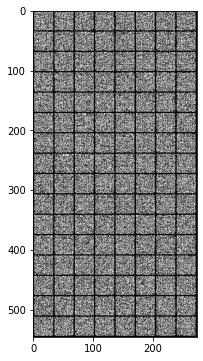

In [ ]:
# visualize the output - at first it should just look like random noise!!
x_fake = G(z)
plt.imshow(transforms.ToPILImage()(make_grid(x_fake, nrow=8)))

## 2.2. The discriminator

The discriminator will be a mirror image of the generator. 

The discriminator will also use a fully convolutional architecutre, with each block consisting of:
- Conv layer
- BatchNorm
- ReLU

Complete the function `get_downscaling_block` and then use it to define the following architecture for the discriminator:

Input: Image shaped `[n_batch, 1, 32, 32]` (in [-1, 1])
Output: Discriminator scores `[n_batch, 1]` in range [0, 1]

1. First downscaling block $\rightarrow$ `[n_batch, ndf, 16, 16]`
2. Second downscaling block $\rightarrow$ `[n_batch, ndf*2, 8, 8]`
3. Third downscaling block $\rightarrow$ `[n_batch, ndf*4, 4, 4]`
4. Last downscaling block $\rightarrow$ `[n_batch, 1]` 

In [ ]:
def get_downscaling_block(channels_in, channels_out, kernel, stride = 0, padding = 0, use_batch_norm=True, is_last=False):
    
    if is_last:
      return nn.Sequential(
                     nn.Conv2d(channels_in, channels_out, kernel, stride=stride, padding = padding, bias=False),
                     nn.Sigmoid()
             )
    
    elif not use_batch_norm:

      return nn.Sequential(
                     nn.Conv2d(channels_in, channels_out, kernel, stride=stride, padding = padding, bias=False),
                     nn.LeakyReLU(0.2)
            )
    
    else:
      return nn.Sequential(
                     nn.Conv2d(channels_in, channels_out, kernel, stride=stride, padding = padding, bias=False),
                     nn.BatchNorm2d(channels_out),
                     nn.LeakyReLU(0.2)
            )
        
class Discriminator(nn.Module):
    def __init__(self, ndf, nchannels=1):
        super().__init__()
        self.model = nn.Sequential(
            get_downscaling_block(nchannels, ndf, 4,stride= 2, padding = 1),
            get_downscaling_block(ndf, ndf*2, 4,stride= 2, padding = 1),
            get_downscaling_block(ndf*2, ndf*4, 4,stride = 2,  padding = 1), 
            get_downscaling_block(ndf*4, nchannels, 4, stride = 1, padding = 0, is_last = True)         
        )
        

    def forward(self, x):
        return self.model(x).squeeze(1).squeeze(1) # remove spatial dimensions

### 2.2.3 Sanity Checking

In [ ]:
real_batch, real_labels = next(iter(dataloader))

In [ ]:
D = Discriminator(ndf=32, nchannels=1)
assert D(real_batch).shape == (real_batch.shape[0], 1)

# 3. Training

## 3.1 Loss 
The essential thing to remember is that the logistic and the non-saturating logistic GAN losses can be written exclusively using the [binary cross entropy loss](https://pytorch.org/docs/stable/generated/torch.nn.BCELoss.html). Our GAN loss will be defined ONLY using the following criterion:



In [ ]:
criterion = nn.BCELoss() # we will build off of this to make our final GAN loss!

## 3.2 Helper functions

We will need a few helper functions. 
1. First, we need to continuously sample z from a Gaussian distribution. 
2. Secondly, we need to make our "ground-truth" labels when using the BCE loss. This should output vectors of either 0s or 1s. 

In [ ]:
def sample_z(batch_size, nz):
    return torch.randn(batch_size, nz, device=device)

# this is for the real ground-truth label
def get_labels_one(batch_size):
    r = torch.ones(batch_size, 1)
    return r.to(device)

# this is for the generated ground-truth label
def get_labels_zero(batch_size):
    r = torch.zeros(batch_size, 1) 
    return r.to(device)


# To initialize the weights of a GAN, the DCGAN paper found that best results are obtained
# with Gaussian initialization with mean=0; std=0.02
def weights_init(m):
    classname = m.__class__.__name__
    if classname.find('Conv') != -1:
        nn.init.normal_(m.weight.data, 0.0, 0.02)
    elif classname.find('BatchNorm') != -1:
        nn.init.normal_(m.weight.data, 1.0, 0.02)
        nn.init.constant_(m.bias.data, 0)
        

# for visualization
to_pil = transforms.ToPILImage()
renorm = transforms.Normalize((-1.), (2.))

## 3.3 Creating the optimizers and hyperparameters

The original DCGAN paper shows that Adam works well in the generator and the discriminator with a learning rate of 0.0002 and Beta1 = 0.5.

Define your optimizers

In [ ]:
nz = 100
ngf = 32
ndf = 32

nchannels= 1 
lr_d = 0.0002
lr_g = 0.0005
beta1= 0.5
display_freq = 200

netD = Discriminator(ndf, nchannels).to(device)
netG = Generator(nz, ngf).to(device)

netD.apply(weights_init)
netG.apply(weights_init)

g_opt = torch.optim.Adam(netG.parameters(), lr=lr_g, betas=(beta1, 0.999))
d_opt = torch.optim.Adam(netD.parameters(), lr=lr_d, betas=(beta1, 0.999))







3.3 Training!

Now for the fun part, training! 
Training a GAN consists in making an update to the discriminator, then the generator.
Training a GAN requires BABYSITTING!! Remember that many things can go wrong when training a GAN:
- The discriminator is too strong for the generator - the generator cannot improve. 
- The generator easily fools the discriminator - cannot learn.
- Mode collapse - generator is not capable of generating diverse images.

it: 0; g_loss: 1.0191298723220825; d_loss: 0.7577965259552002; avg_real_score: 0.4538794755935669; avg_fake_score: 0.3836795687675476: : 0it [00:00, ?it/s]

epoch 0 generated images


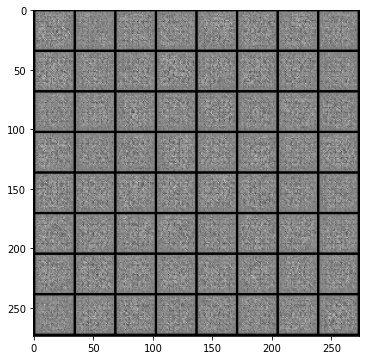

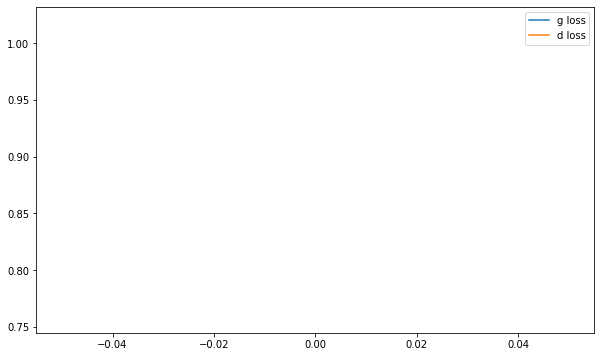

it: 200; g_loss: 1.0192196369171143; d_loss: 0.4111942648887634; avg_real_score: 0.5453622341156006; avg_fake_score: 0.3788815140724182: : 200it [00:10, 20.27it/s] 

epoch 0 generated images


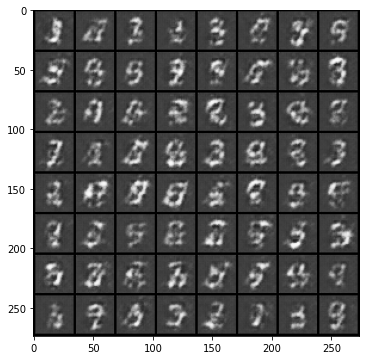

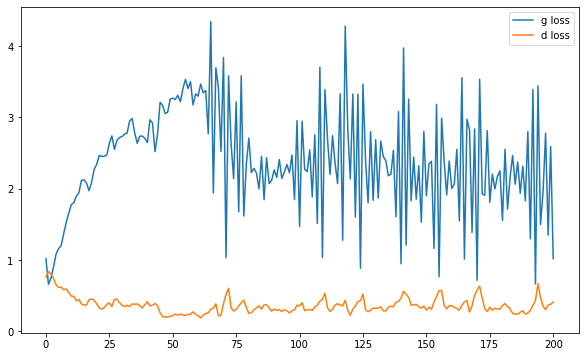

it: 400; g_loss: 1.5156084299087524; d_loss: 0.21301600337028503; avg_real_score: 0.7466289401054382; avg_fake_score: 0.2395254522562027: : 400it [00:21, 19.59it/s]

epoch 0 generated images


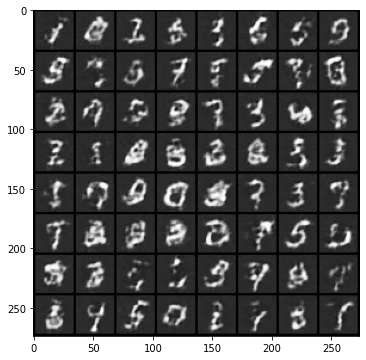

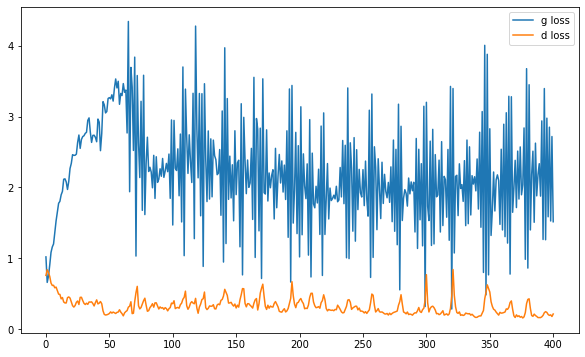

it: 468; g_loss: 1.1701273918151855; d_loss: 0.3096492886543274; avg_real_score: 0.7193529009819031; avg_fake_score: 0.3291512131690979: : 469it [00:25, 18.55it/s]
it: 469; g_loss: 2.6708085536956787; d_loss: 0.37544339895248413; avg_real_score: 0.8575829267501831; avg_fake_score: 0.08098939061164856: : 0it [00:00, ?it/s]

epoch 1 generated images


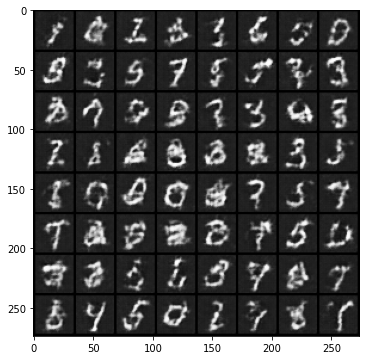

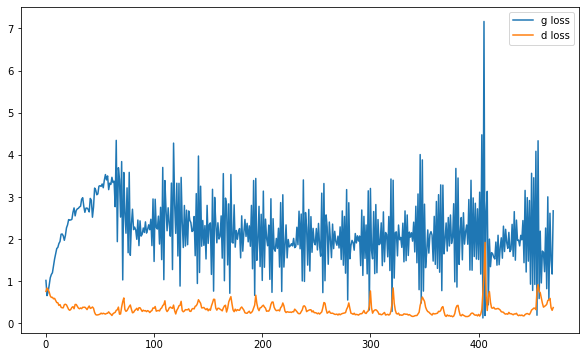

it: 669; g_loss: 2.171722412109375; d_loss: 0.4894176721572876; avg_real_score: 0.8407213687896729; avg_fake_score: 0.13113275170326233: : 199it [00:11, 18.10it/s] 

epoch 1 generated images


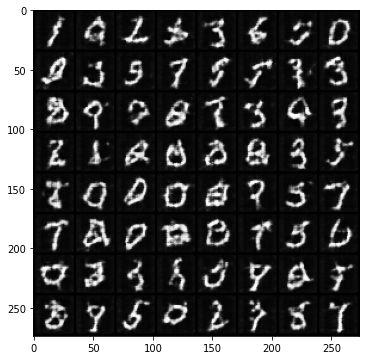

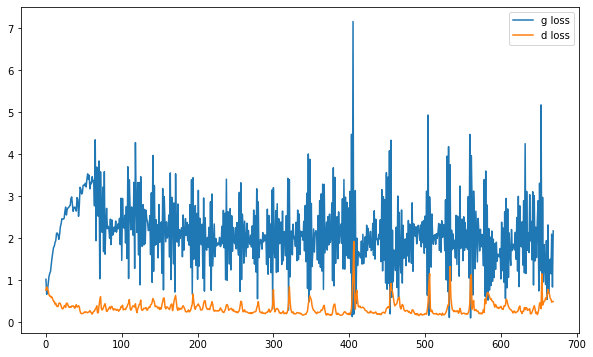

it: 869; g_loss: 0.8237231373786926; d_loss: 0.6224351525306702; avg_real_score: 0.4347001314163208; avg_fake_score: 0.4582105576992035: : 400it [00:23, 18.59it/s]

epoch 1 generated images


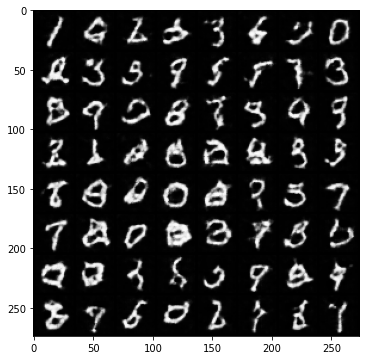

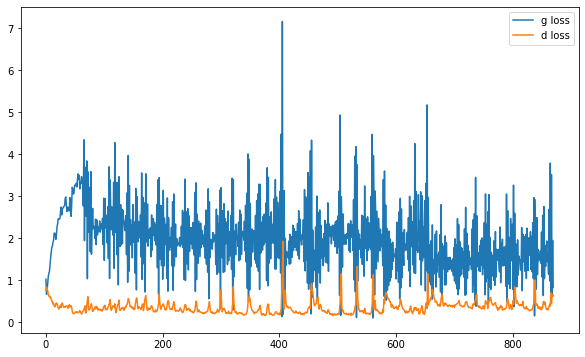

it: 937; g_loss: 2.331852436065674; d_loss: 0.45861804485321045; avg_real_score: 0.8355597257614136; avg_fake_score: 0.11795012652873993: : 469it [00:27, 17.16it/s]
it: 938; g_loss: 0.7371227145195007; d_loss: 0.4423627555370331; avg_real_score: 0.48976394534111023; avg_fake_score: 0.5047019720077515: : 0it [00:00, ?it/s]

epoch 2 generated images


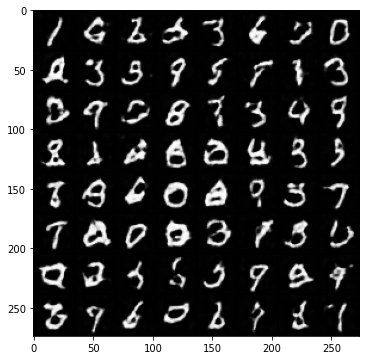

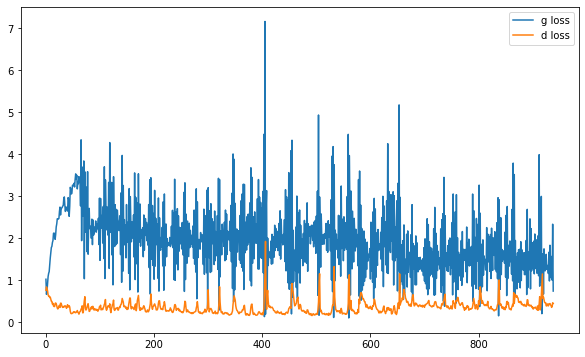

it: 1138; g_loss: 3.0618999004364014; d_loss: 0.40035271644592285; avg_real_score: 0.92869633436203; avg_fake_score: 0.05454634130001068: : 199it [00:11, 17.77it/s] 

epoch 2 generated images


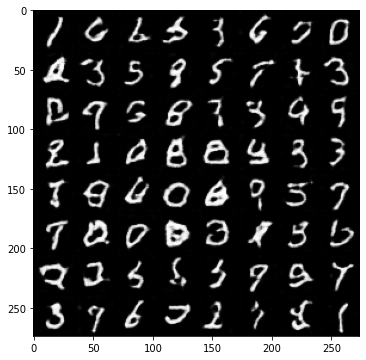

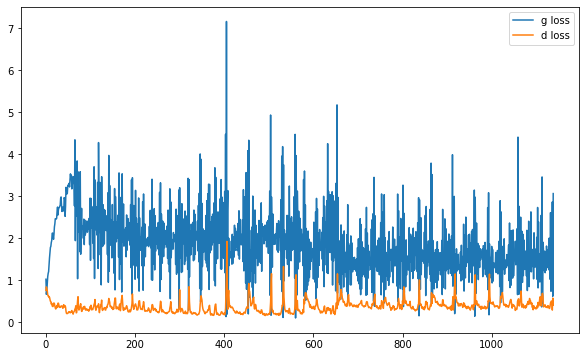

it: 1338; g_loss: 1.9467154741287231; d_loss: 0.3559851050376892; avg_real_score: 0.7850741744041443; avg_fake_score: 0.15686696767807007: : 399it [00:23, 17.62it/s]

epoch 2 generated images


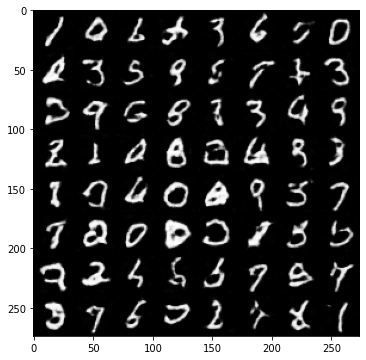

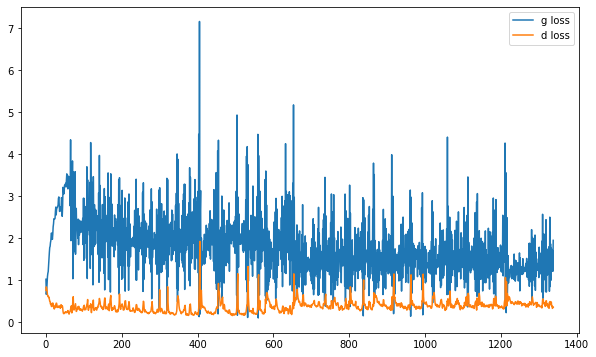

it: 1406; g_loss: 1.4936479330062866; d_loss: 0.3509482741355896; avg_real_score: 0.6821720004081726; avg_fake_score: 0.25063925981521606: : 469it [00:27, 16.87it/s]
it: 1407; g_loss: 1.4612658023834229; d_loss: 0.31120550632476807; avg_real_score: 0.7480540871620178; avg_fake_score: 0.25744205713272095: : 0it [00:00, ?it/s]

epoch 3 generated images


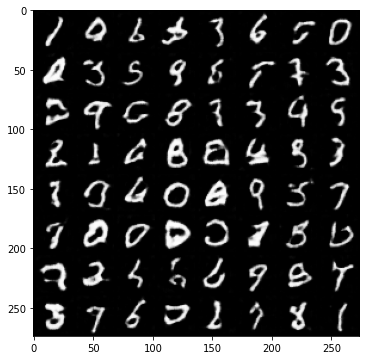

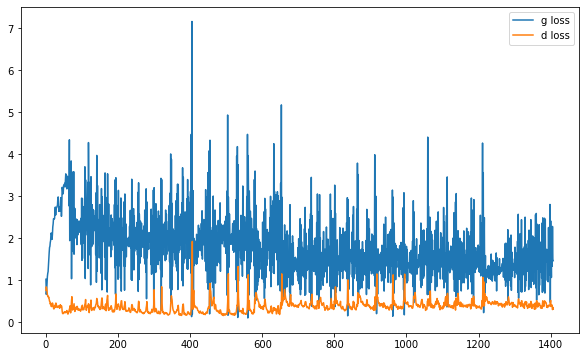

it: 1607; g_loss: 1.8541619777679443; d_loss: 0.3040846884250641; avg_real_score: 0.7585402727127075; avg_fake_score: 0.17584693431854248: : 199it [00:12, 17.18it/s]

epoch 3 generated images


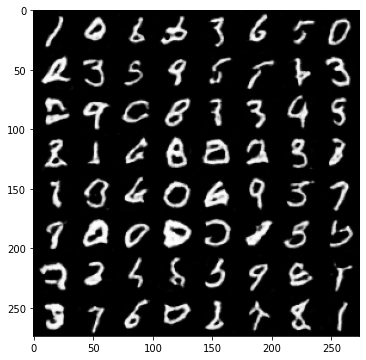

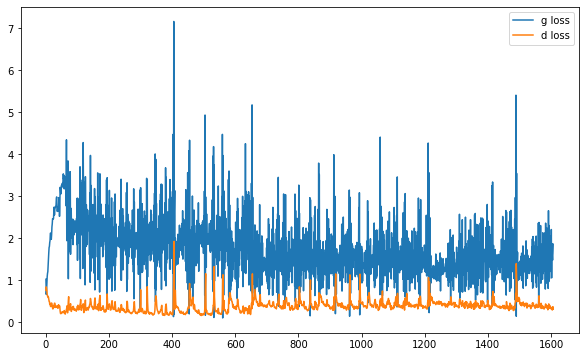

it: 1807; g_loss: 2.5979321002960205; d_loss: 0.3228774666786194; avg_real_score: 0.8599388003349304; avg_fake_score: 0.08817874640226364: : 399it [00:24, 16.91it/s] 

epoch 3 generated images


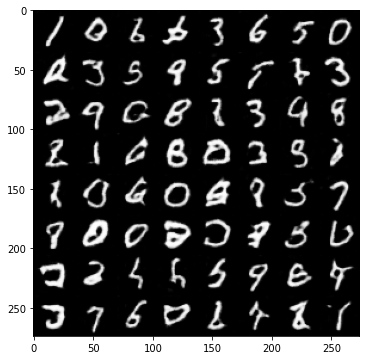

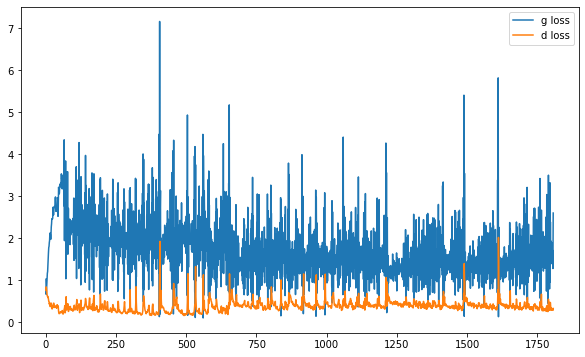

it: 1875; g_loss: 1.2891452312469482; d_loss: 0.3455830216407776; avg_real_score: 0.7009665369987488; avg_fake_score: 0.2976323962211609: : 469it [00:28, 16.23it/s]
it: 1876; g_loss: 1.8790031671524048; d_loss: 0.34281542897224426; avg_real_score: 0.8056790232658386; avg_fake_score: 0.174711674451828: : 0it [00:00, ?it/s]

epoch 4 generated images


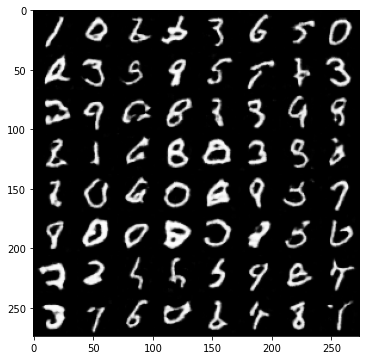

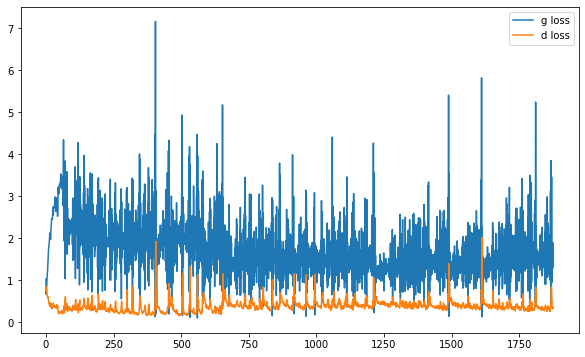

it: 2076; g_loss: 1.3073837757110596; d_loss: 0.3320513665676117; avg_real_score: 0.6903567314147949; avg_fake_score: 0.2989216148853302: : 199it [00:12, 16.70it/s]

epoch 4 generated images


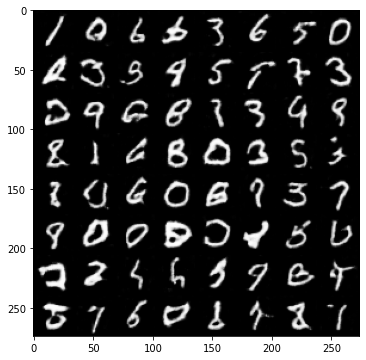

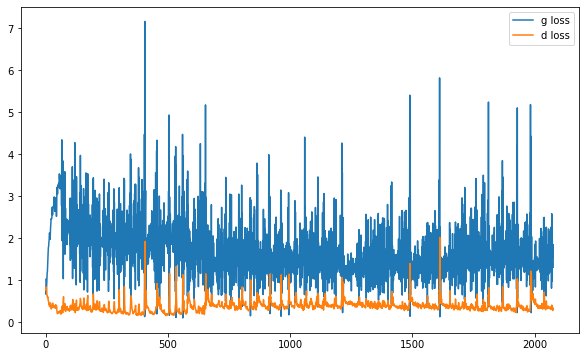

it: 2276; g_loss: 1.7718446254730225; d_loss: 0.2749151885509491; avg_real_score: 0.77473384141922; avg_fake_score: 0.1976483315229416: : 399it [00:24, 16.64it/s]    

epoch 4 generated images


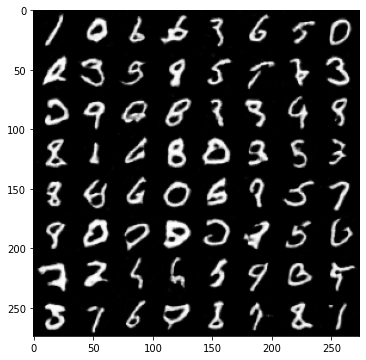

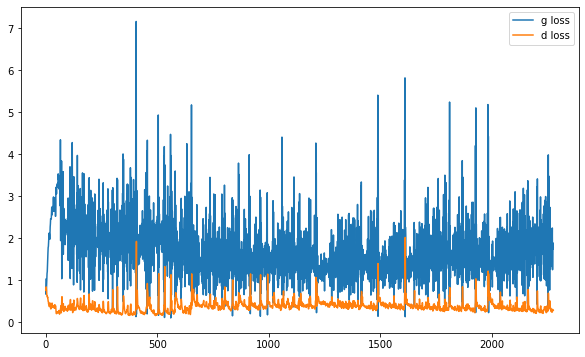

it: 2344; g_loss: 4.4329328536987305; d_loss: 0.5523678660392761; avg_real_score: 0.9636165499687195; avg_fake_score: 0.015512588433921337: : 469it [00:29, 16.12it/s]
it: 2345; g_loss: 0.7251659631729126; d_loss: 0.6505968570709229; avg_real_score: 0.3439098000526428; avg_fake_score: 0.5203090906143188: : 0it [00:00, ?it/s]

epoch 5 generated images


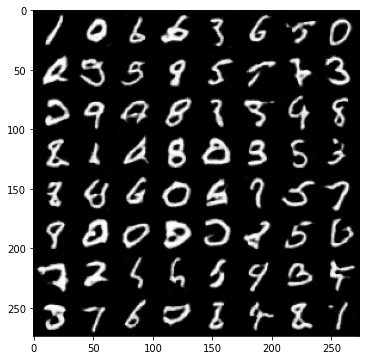

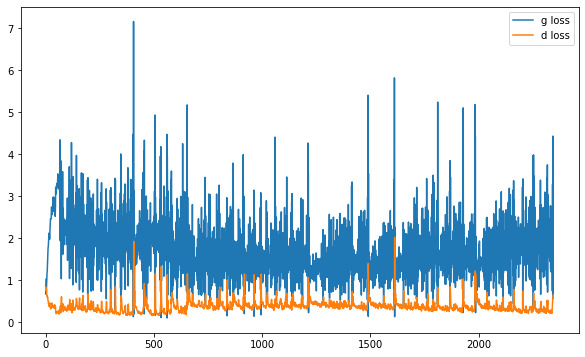

it: 2545; g_loss: 2.7331089973449707; d_loss: 0.19482414424419403; avg_real_score: 0.8122916221618652; avg_fake_score: 0.0818277895450592: : 199it [00:12, 16.47it/s]

epoch 5 generated images


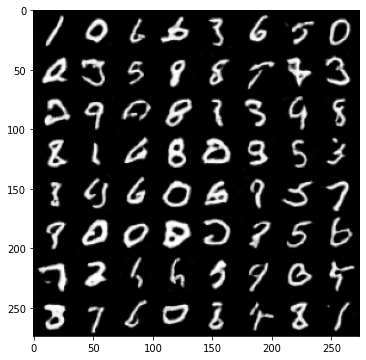

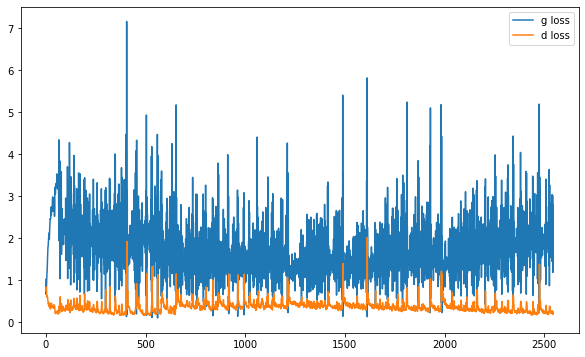

it: 2745; g_loss: 2.075439453125; d_loss: 0.1584814339876175; avg_real_score: 0.826539158821106; avg_fake_score: 0.1462881863117218: : 399it [00:25, 16.79it/s]      

epoch 5 generated images


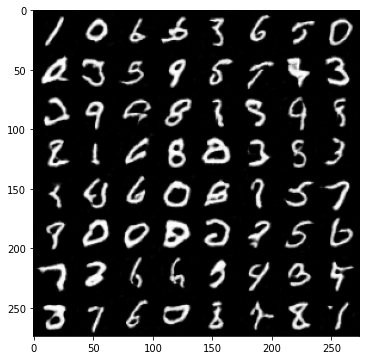

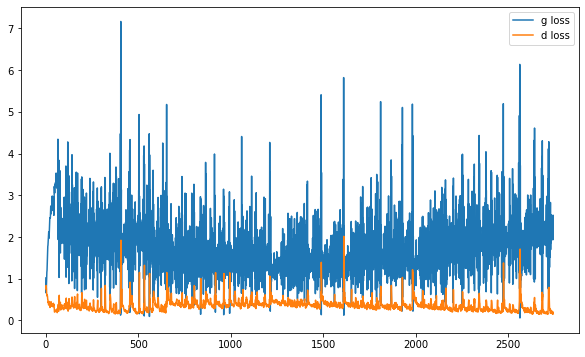

it: 2813; g_loss: 2.2303223609924316; d_loss: 0.13813285529613495; avg_real_score: 0.8485576510429382; avg_fake_score: 0.1259872168302536: : 469it [00:29, 15.89it/s]
it: 2814; g_loss: 2.4417383670806885; d_loss: 0.16679513454437256; avg_real_score: 0.8885213136672974; avg_fake_score: 0.11025664955377579: : 0it [00:00, ?it/s]

epoch 6 generated images


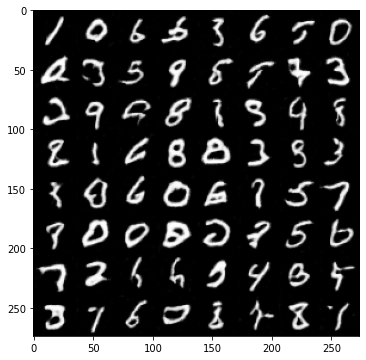

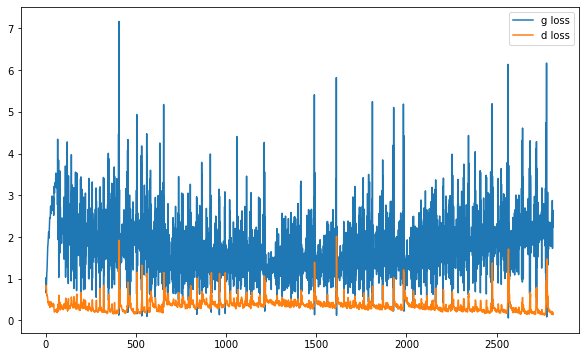

it: 3014; g_loss: 2.517336845397949; d_loss: 0.11186149716377258; avg_real_score: 0.8903992176055908; avg_fake_score: 0.09748736023902893: : 199it [00:12, 15.90it/s] 

epoch 6 generated images


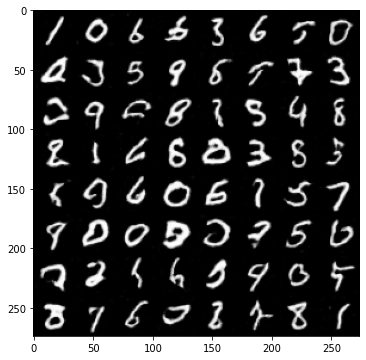

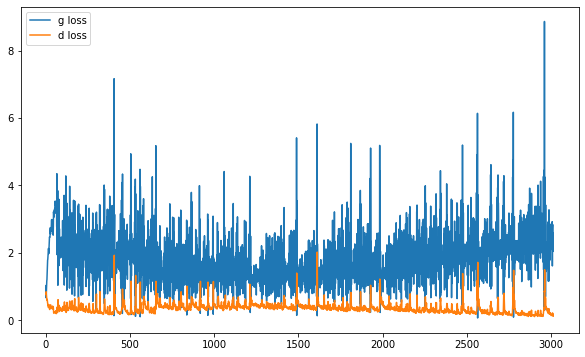

it: 3214; g_loss: 2.320852279663086; d_loss: 0.1383502185344696; avg_real_score: 0.8188521862030029; avg_fake_score: 0.1286786049604416: : 399it [00:25, 17.32it/s]    

epoch 6 generated images


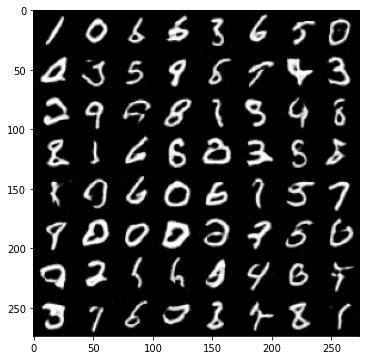

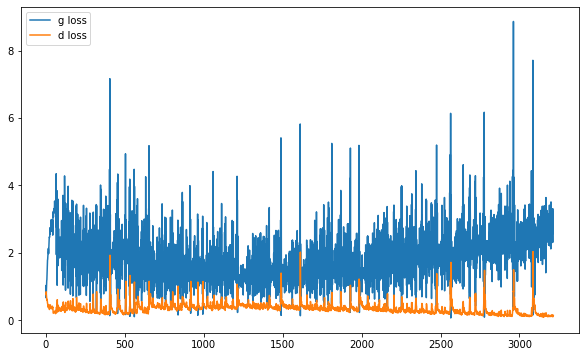

it: 3282; g_loss: 2.16581130027771; d_loss: 0.12976552546024323; avg_real_score: 0.840583324432373; avg_fake_score: 0.13902312517166138: : 469it [00:30, 15.49it/s]
it: 3283; g_loss: 3.0517454147338867; d_loss: 0.14574366807937622; avg_real_score: 0.9409403800964355; avg_fake_score: 0.05953206121921539: : 0it [00:00, ?it/s]

epoch 7 generated images


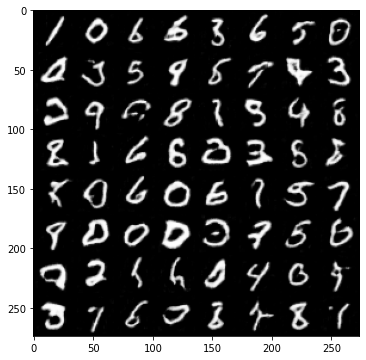

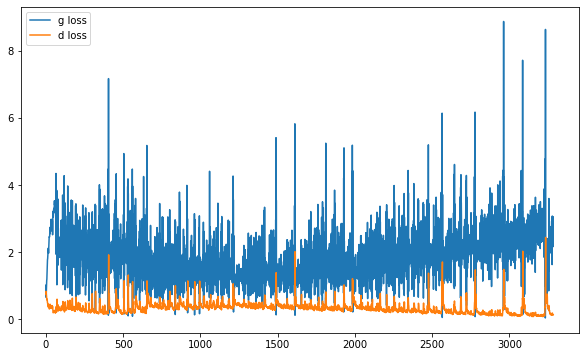

it: 3483; g_loss: 3.200044631958008; d_loss: 0.0850522592663765; avg_real_score: 0.9290456771850586; avg_fake_score: 0.05412928760051727: : 199it [00:12, 16.88it/s] 

epoch 7 generated images


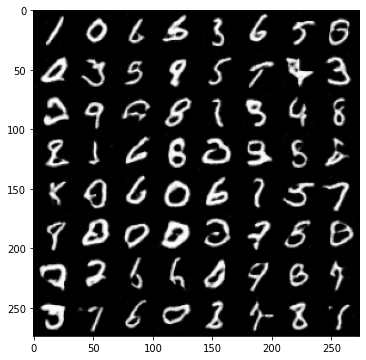

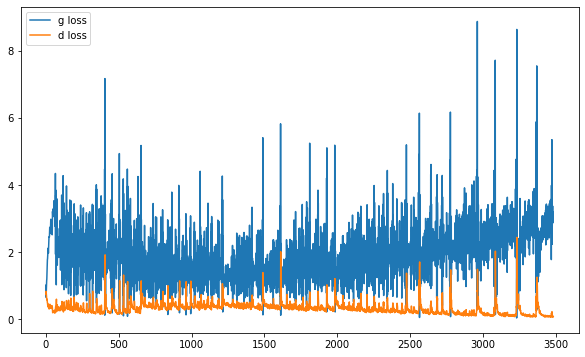

it: 3683; g_loss: 2.2799253463745117; d_loss: 0.07700216770172119; avg_real_score: 0.9158414006233215; avg_fake_score: 0.13490141928195953: : 399it [00:24, 16.89it/s] 

epoch 7 generated images


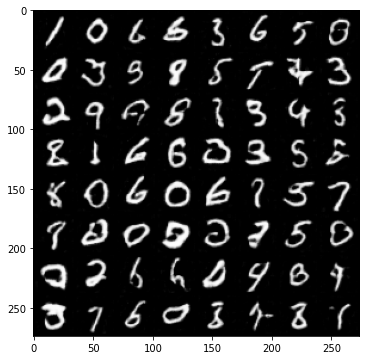

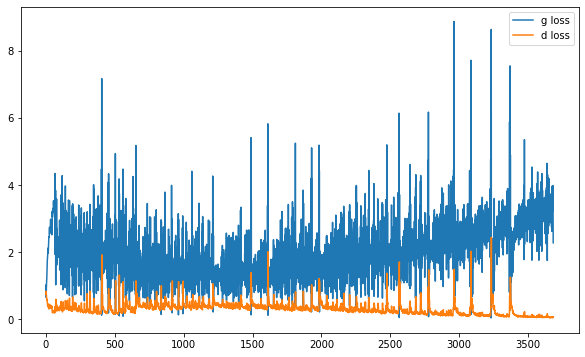

it: 3751; g_loss: 3.1855826377868652; d_loss: 0.3619825541973114; avg_real_score: 0.867963969707489; avg_fake_score: 0.053747206926345825: : 469it [00:29, 16.09it/s]
it: 3752; g_loss: 0.7945494651794434; d_loss: 0.39708858728408813; avg_real_score: 0.5020154714584351; avg_fake_score: 0.4850802421569824: : 0it [00:00, ?it/s]

epoch 8 generated images


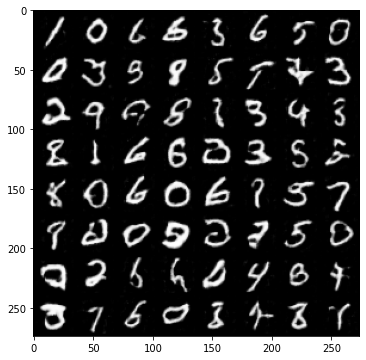

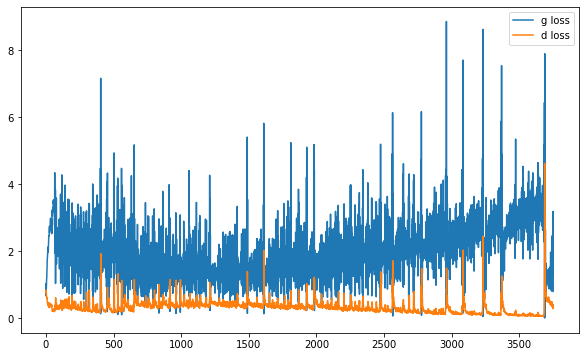

it: 3952; g_loss: 2.0243966579437256; d_loss: 0.14289015531539917; avg_real_score: 0.843037486076355; avg_fake_score: 0.16200387477874756: : 199it [00:12, 17.31it/s] 

epoch 8 generated images


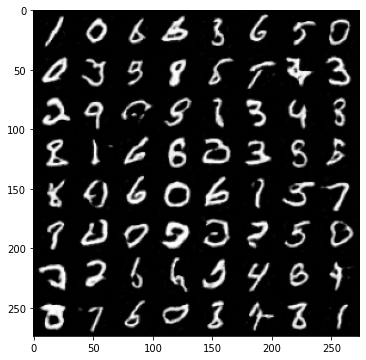

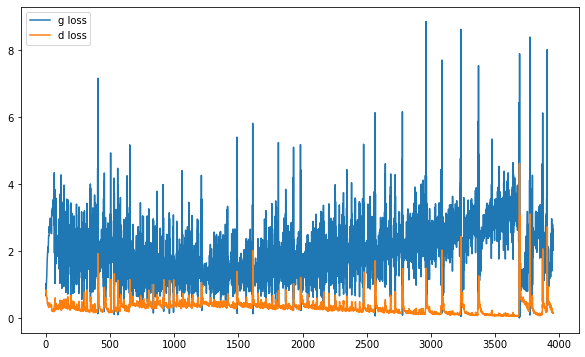

it: 4152; g_loss: 3.135747194290161; d_loss: 0.06768136471509933; avg_real_score: 0.9302912354469299; avg_fake_score: 0.05631014704704285: : 399it [00:24, 16.38it/s]

epoch 8 generated images


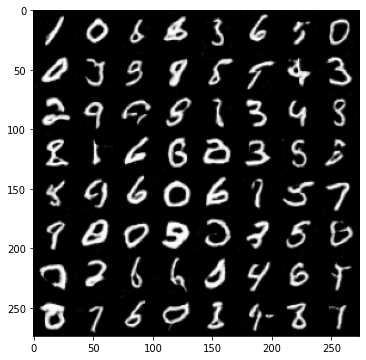

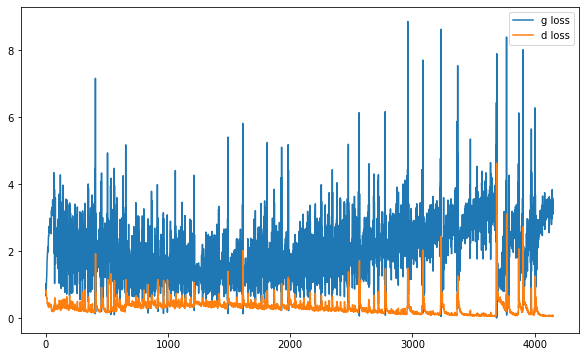

it: 4220; g_loss: 3.704371929168701; d_loss: 0.044090475887060165; avg_real_score: 0.9668614268302917; avg_fake_score: 0.03372438997030258: : 469it [00:29, 16.05it/s]
it: 4221; g_loss: 3.8399338722229004; d_loss: 0.0637243315577507; avg_real_score: 0.9547384977340698; avg_fake_score: 0.029604051262140274: : 0it [00:00, ?it/s]

epoch 9 generated images


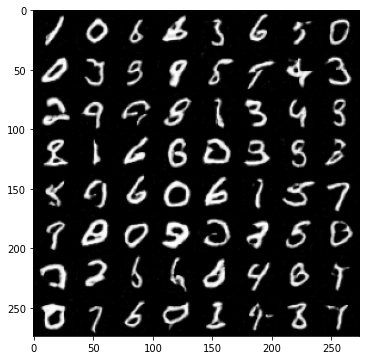

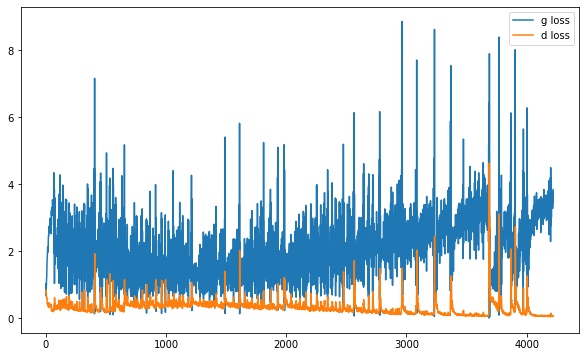

it: 4421; g_loss: 3.240544319152832; d_loss: 0.05369628220796585; avg_real_score: 0.9357534050941467; avg_fake_score: 0.054035112261772156: : 199it [00:12, 17.00it/s]

epoch 9 generated images


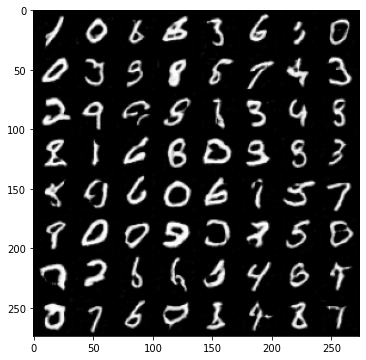

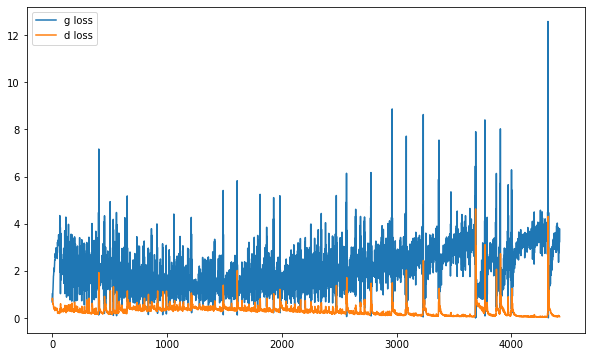

it: 4621; g_loss: 1.5659637451171875; d_loss: 0.2793138325214386; avg_real_score: 0.704041600227356; avg_fake_score: 0.24805177748203278: : 399it [00:25, 16.50it/s] 

epoch 9 generated images


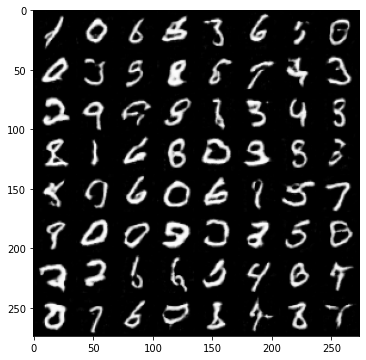

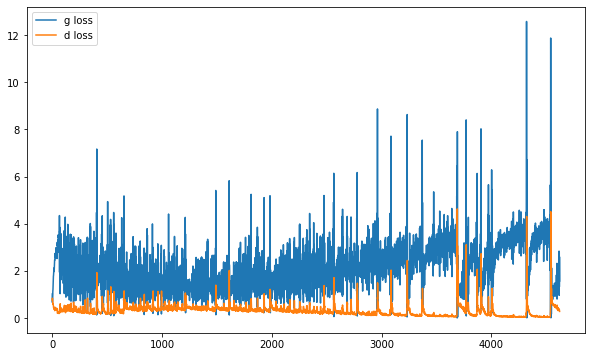

it: 4689; g_loss: 5.152843475341797; d_loss: 0.22846169769763947; avg_real_score: 0.9872897863388062; avg_fake_score: 0.008083771914243698: : 469it [00:29, 15.77it/s]
it: 4690; g_loss: 4.985906600952148; d_loss: 0.3481302261352539; avg_real_score: 0.5420520305633545; avg_fake_score: 0.012894450686872005: : 0it [00:00, ?it/s]

epoch 10 generated images


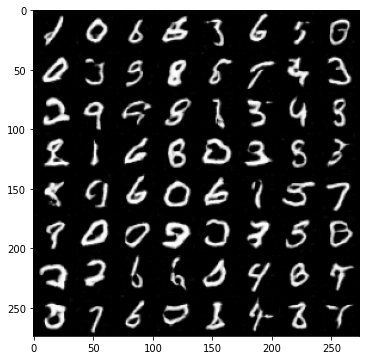

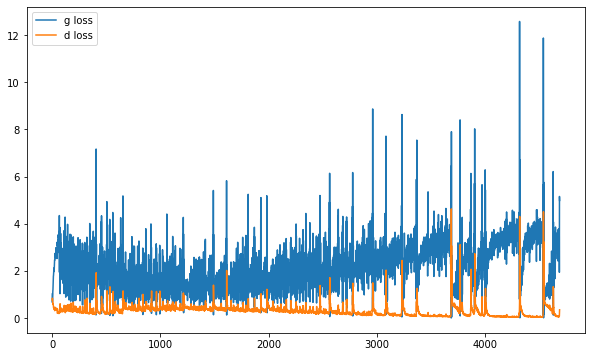

it: 4890; g_loss: 3.7441084384918213; d_loss: 0.04468840733170509; avg_real_score: 0.948544979095459; avg_fake_score: 0.031931739300489426: : 199it [00:12, 17.14it/s] 

epoch 10 generated images


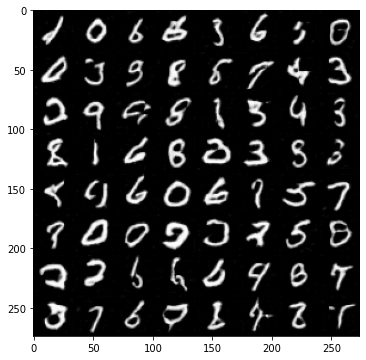

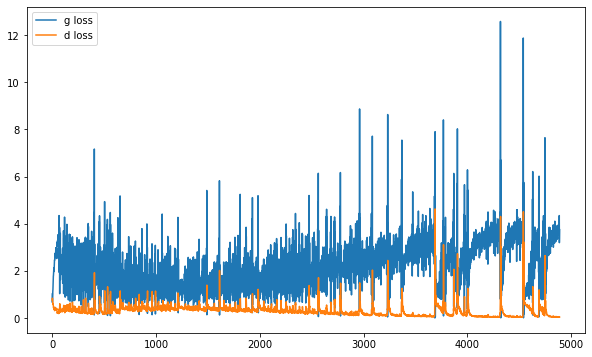

it: 5090; g_loss: 1.4128777980804443; d_loss: 0.3987639248371124; avg_real_score: 0.5996653437614441; avg_fake_score: 0.29274532198905945: : 399it [00:24, 16.80it/s] 

epoch 10 generated images


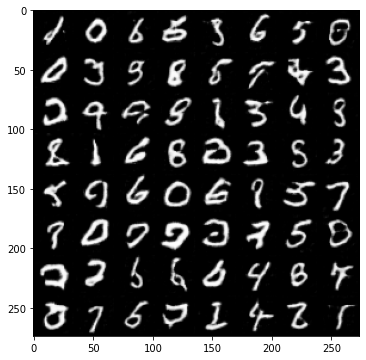

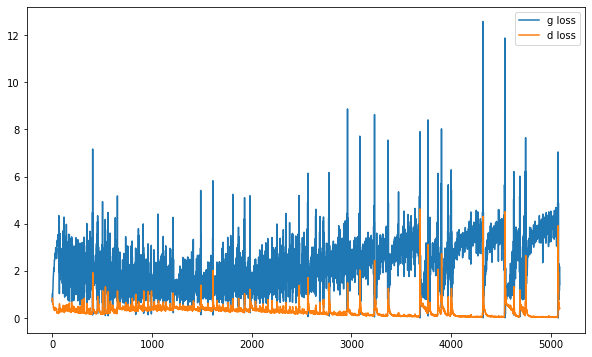

it: 5158; g_loss: 3.7501797676086426; d_loss: 0.03375466540455818; avg_real_score: 0.9674503207206726; avg_fake_score: 0.03258923813700676: : 469it [00:28, 16.18it/s]
it: 5159; g_loss: 3.948090076446533; d_loss: 0.04914408177137375; avg_real_score: 0.9738399982452393; avg_fake_score: 0.026548612862825394: : 0it [00:00, ?it/s]

epoch 11 generated images


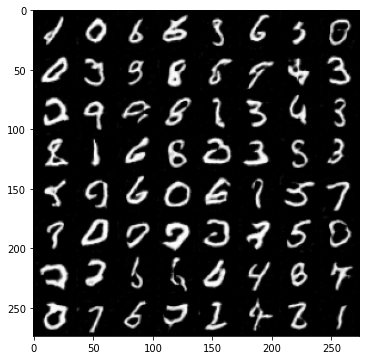

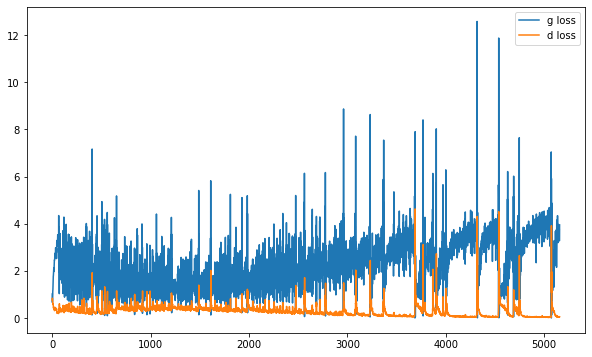

it: 5359; g_loss: 3.921942949295044; d_loss: 0.03428836166858673; avg_real_score: 0.9635863900184631; avg_fake_score: 0.030386609956622124: : 199it [00:12, 17.25it/s]

epoch 11 generated images


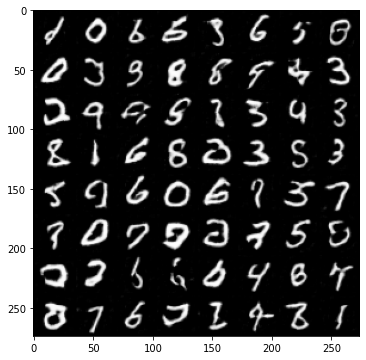

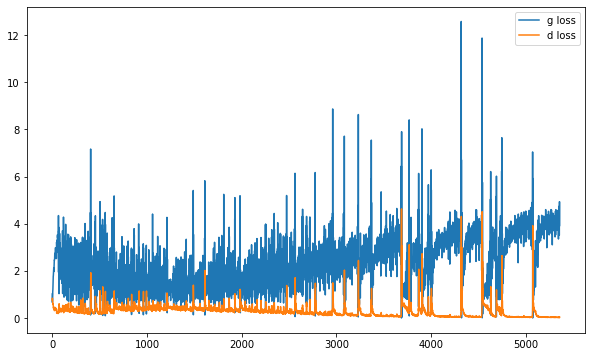

it: 5559; g_loss: 2.2052884101867676; d_loss: 0.27343884110450745; avg_real_score: 0.7857441902160645; avg_fake_score: 0.1424161195755005: : 399it [00:25, 16.45it/s] 

epoch 11 generated images


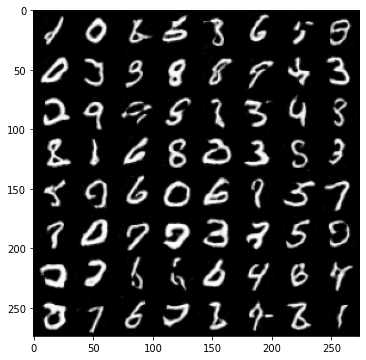

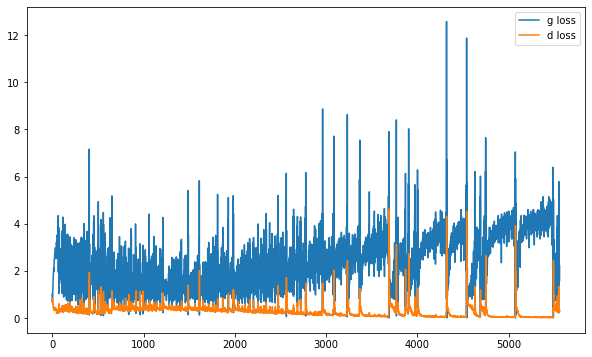

it: 5627; g_loss: 1.41885507106781; d_loss: 0.284110426902771; avg_real_score: 0.6818045377731323; avg_fake_score: 0.2768210768699646: : 469it [00:29, 15.75it/s]
it: 5628; g_loss: 2.7071046829223633; d_loss: 0.2870737612247467; avg_real_score: 0.8920692205429077; avg_fake_score: 0.0892171710729599: : 0it [00:00, ?it/s]

epoch 12 generated images


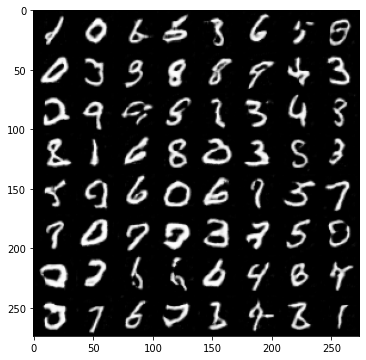

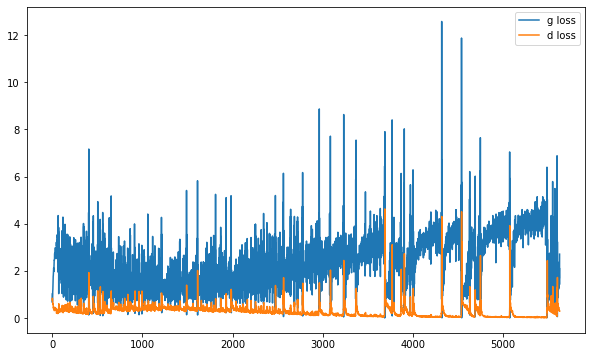

it: 5828; g_loss: 3.217402935028076; d_loss: 0.04548961669206619; avg_real_score: 0.9342019557952881; avg_fake_score: 0.059156447649002075: : 199it [00:12, 17.15it/s] 

epoch 12 generated images


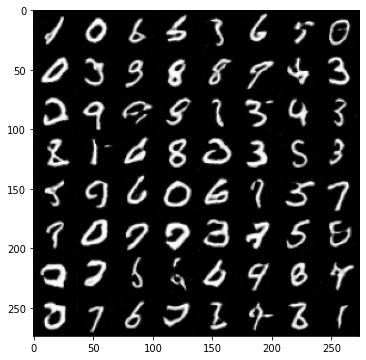

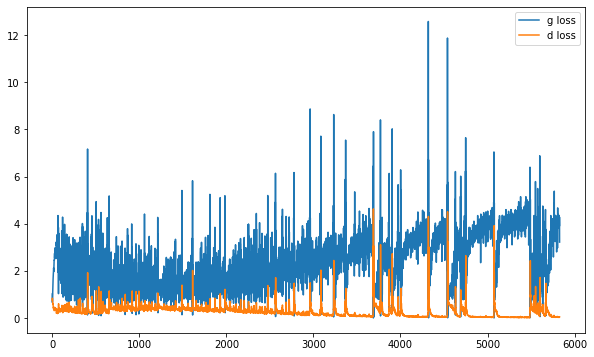

it: 6028; g_loss: 4.661517143249512; d_loss: 0.02019748091697693; avg_real_score: 0.9888489246368408; avg_fake_score: 0.014521014876663685: : 399it [00:24, 17.26it/s] 

epoch 12 generated images


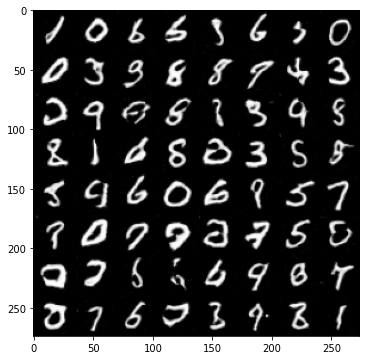

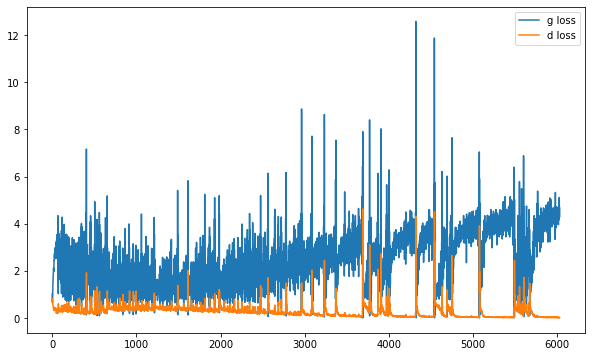

it: 6096; g_loss: 4.8192644119262695; d_loss: 0.017521267756819725; avg_real_score: 0.9773998260498047; avg_fake_score: 0.012353383004665375: : 469it [00:29, 15.96it/s]
it: 6097; g_loss: 4.491110801696777; d_loss: 0.02027212828397751; avg_real_score: 0.9800407290458679; avg_fake_score: 0.018685469403862953: : 0it [00:00, ?it/s]

epoch 13 generated images


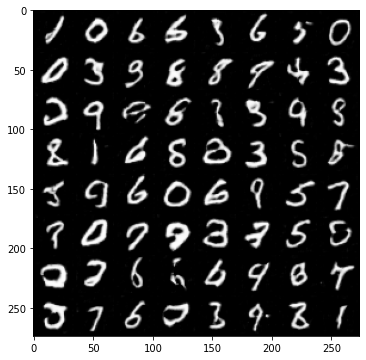

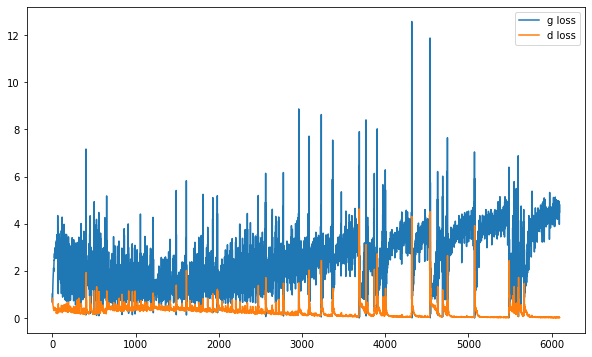

it: 6297; g_loss: 2.9618330001831055; d_loss: 0.08667393028736115; avg_real_score: 0.9275152683258057; avg_fake_score: 0.0710698664188385: : 199it [00:12, 17.40it/s] 

epoch 13 generated images


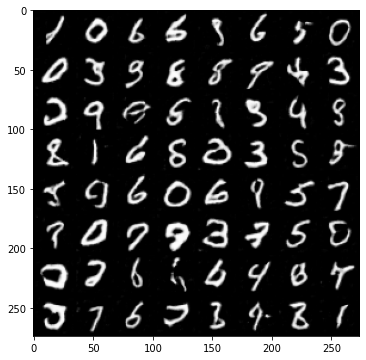

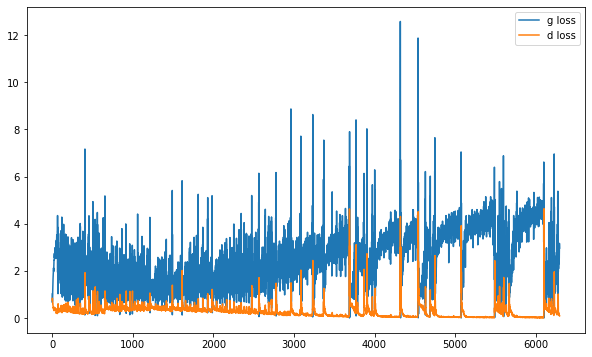

it: 6497; g_loss: 4.495940208435059; d_loss: 0.015985971316695213; avg_real_score: 0.9823229312896729; avg_fake_score: 0.01703350618481636: : 399it [00:24, 17.14it/s]

epoch 13 generated images


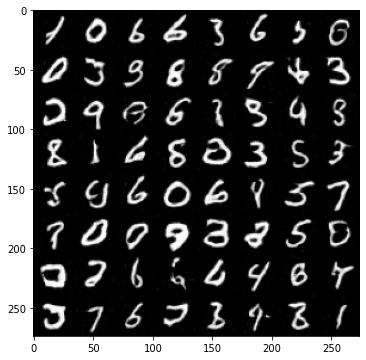

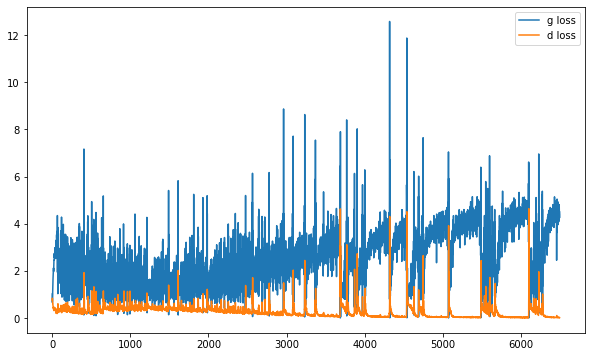

it: 6565; g_loss: 4.913525581359863; d_loss: 0.01636252924799919; avg_real_score: 0.9864329099655151; avg_fake_score: 0.011331405490636826: : 469it [00:29, 15.99it/s]
it: 6566; g_loss: 4.268404960632324; d_loss: 0.02305358275771141; avg_real_score: 0.9636932015419006; avg_fake_score: 0.02065800130367279: : 0it [00:00, ?it/s]

epoch 14 generated images


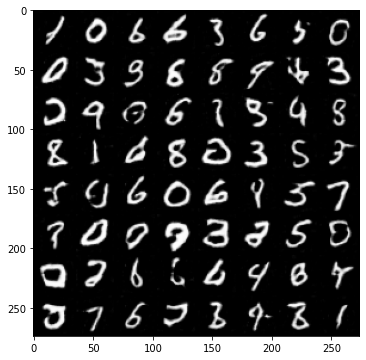

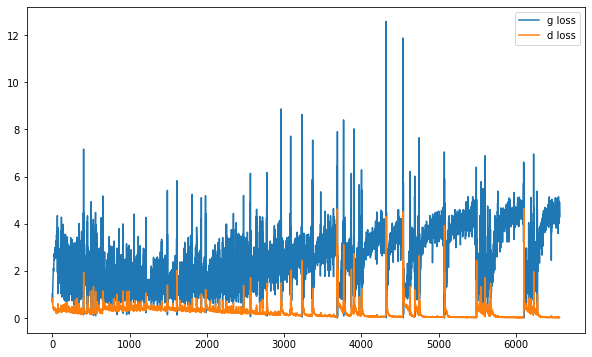

it: 6766; g_loss: 0.20418928563594818; d_loss: 0.6078019738197327; avg_real_score: 0.4153671860694885; avg_fake_score: 0.8271929025650024: : 199it [00:12, 16.78it/s] 

epoch 14 generated images


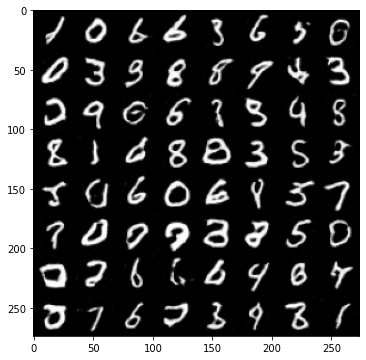

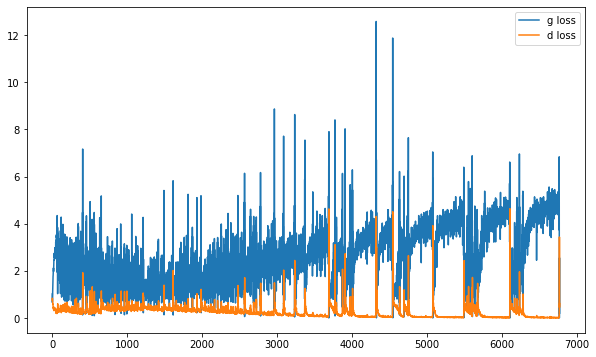

it: 6966; g_loss: 1.9041554927825928; d_loss: 0.29068928956985474; avg_real_score: 0.7801841497421265; avg_fake_score: 0.18063826858997345: : 399it [00:24, 16.46it/s]

epoch 14 generated images


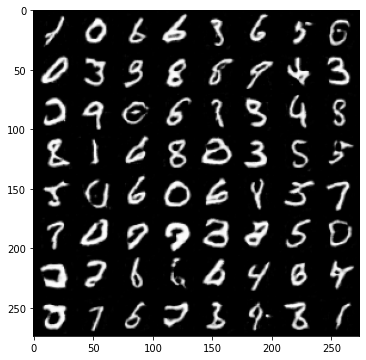

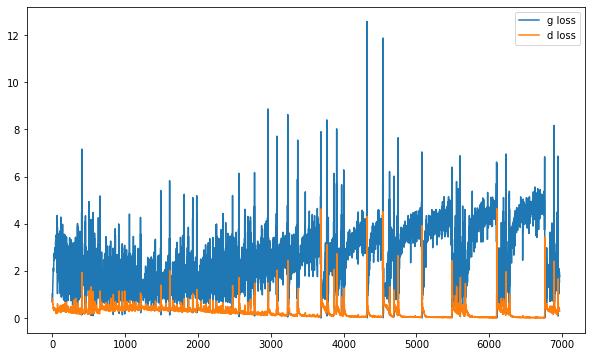

it: 7034; g_loss: 4.181039810180664; d_loss: 0.03387635201215744; avg_real_score: 0.9635724425315857; avg_fake_score: 0.021574145182967186: : 469it [00:29, 16.04it/s]


In [ ]:
nb_epochs = 15

g_losses = []
d_losses = []


nz = 100
ngf = 32
ndf = 32

nchannels= 1 
lr_d = 0.0002
lr_g = 0.0005
beta1= 0.5
display_freq = 200

netD = Discriminator(ndf, nchannels).to(device)
netG = Generator(nz, ngf).to(device)

netD.apply(weights_init)
netG.apply(weights_init)

g_opt = torch.optim.Adam(netG.parameters(), lr=lr_g, betas=(beta1, 0.999))
d_opt = torch.optim.Adam(netD.parameters(), lr=lr_d, betas=(beta1, 0.999))
j = 0


z_test = sample_z(64, nz) # we generate the noise only once for testing

for epoch in range(nb_epochs):
    
    # train
    pbar = tqdm(enumerate(dataloader))
    for i, batch in pbar:
        im, _ = batch # we don't care about the label for unconditional generation
        im = im.to(device)
        
        cur_batch_size = im.shape[0]  
        
        # 1. sample a z vector 
        z = sample_z(cur_batch_size, nz)
        
        # 2. Generate a fake image

        fake_im = netG(z)

        # 3. Classify real image with D
        
        real_logits = netD(im)


        # 4. Classify fake image with D
       
        fake_logits = netD(fake_im.detach())
         
        ###
        ### Discriminator
        ###
        d_loss = criterion(real_logits, get_labels_one(cur_batch_size).to(device))
        d_loss = (d_loss + criterion(fake_logits, get_labels_zero(cur_batch_size).to(device)))/2
        d_opt.zero_grad()
        d_loss.backward() # we need to retain graph=True to be able to calculate the gradient in the g backprop
        d_opt.step()

        
        ###
        ### Generator
        ###
        
        fake_logits = netD(fake_im)
        g_loss = criterion(fake_logits, get_labels_one(cur_batch_size).to(device)) 
        g_opt.zero_grad()
        g_loss.backward()
        g_opt.step()
        
                
        d_losses.append(d_loss.item())
        g_losses.append(g_loss.item())
        
        avg_real_score = torch.mean(real_logits).item()
        avg_fake_score = torch.mean(fake_logits).item()


        pbar.set_description(f"it: {j}; g_loss: {g_loss}; d_loss: {d_loss}; avg_real_score: {avg_real_score}; avg_fake_score: {avg_fake_score}")
        if i % display_freq == 0:

            fake_im = netG(z_test)
            
            un_norm = renorm(fake_im) # for visualization
            
            grid = torchvision.utils.make_grid(un_norm, nrow=8)
            pil_grid = to_pil(grid)  
            
            print("epoch", epoch, "generated images")
            plt.imshow(pil_grid)
            plt.show()
            
            plt.plot(range(len(g_losses)), g_losses, label='g loss')
            plt.plot(range(len(g_losses)), d_losses, label='d loss')
            
            plt.legend()
            plt.show()          
        j += 1

##Modify ngf and ndf

it: 0; g_loss: 1.2860279083251953; d_loss: 0.6125588417053223; avg_real_score: 0.49853137135505676; avg_fake_score: 0.29257190227508545: : 0it [00:00, ?it/s]

epoch 0 generated images


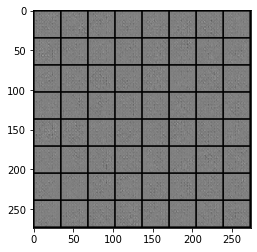

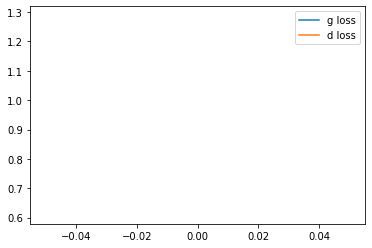

it: 200; g_loss: 5.225974082946777; d_loss: 0.009945448487997055; avg_real_score: 0.9925751686096191; avg_fake_score: 0.0063903238624334335: : 200it [00:16, 13.58it/s]

epoch 0 generated images


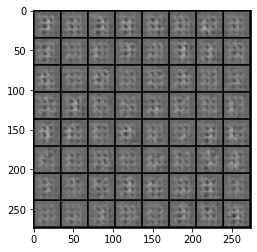

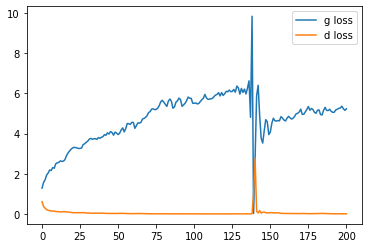

it: 400; g_loss: 3.1732845306396484; d_loss: 0.1437380462884903; avg_real_score: 0.8687416315078735; avg_fake_score: 0.05240374058485031: : 400it [00:31, 12.28it/s]

epoch 0 generated images


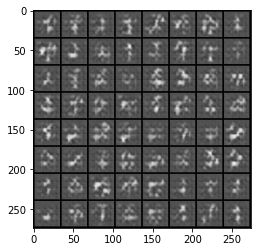

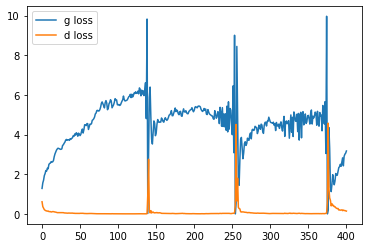

it: 468; g_loss: 3.870985746383667; d_loss: 0.04683870077133179; avg_real_score: 0.9580633044242859; avg_fake_score: 0.02843661978840828: : 469it [00:37, 12.57it/s]
it: 469; g_loss: 3.7099108695983887; d_loss: 0.04752025753259659; avg_real_score: 0.9487360715866089; avg_fake_score: 0.03119301050901413: : 0it [00:00, ?it/s]

epoch 1 generated images


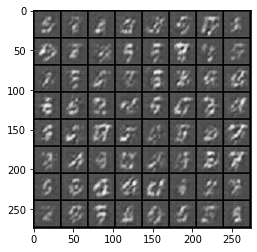

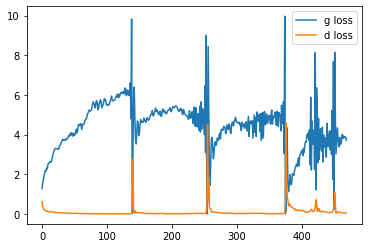

it: 669; g_loss: 4.467970848083496; d_loss: 0.01882619597017765; avg_real_score: 0.9821237325668335; avg_fake_score: 0.0149159487336874: : 199it [00:15, 12.99it/s] 

epoch 1 generated images


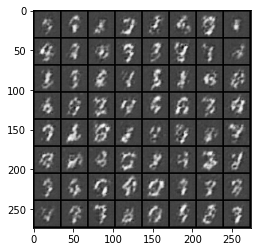

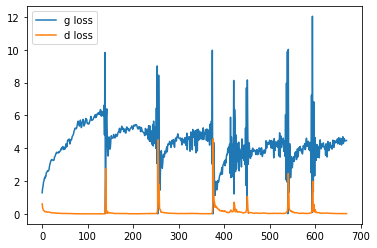

it: 869; g_loss: 1.3223263025283813; d_loss: 0.417033314704895; avg_real_score: 0.5336822271347046; avg_fake_score: 0.30825597047805786: : 399it [00:32, 12.76it/s] 

epoch 1 generated images


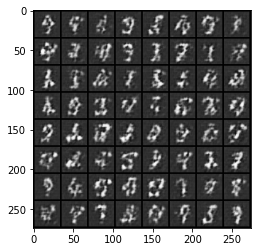

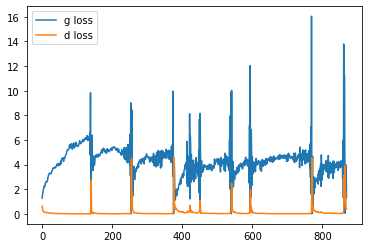

it: 937; g_loss: 3.7217392921447754; d_loss: 0.047598946839571; avg_real_score: 0.9401042461395264; avg_fake_score: 0.03400149941444397: : 469it [00:37, 12.36it/s]
it: 938; g_loss: 3.426884174346924; d_loss: 0.05170387402176857; avg_real_score: 0.9512645602226257; avg_fake_score: 0.044455938041210175: : 0it [00:00, ?it/s]

epoch 2 generated images


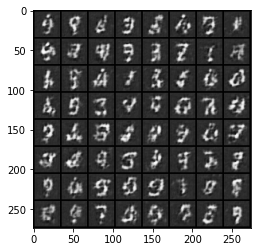

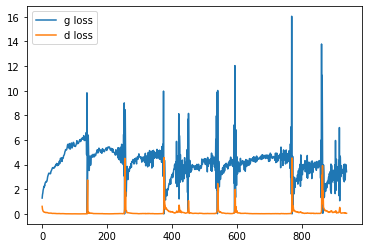

it: 1138; g_loss: 3.0273985862731934; d_loss: 0.07649693638086319; avg_real_score: 0.9139998555183411; avg_fake_score: 0.06565854698419571: : 199it [00:16, 12.09it/s]

epoch 2 generated images


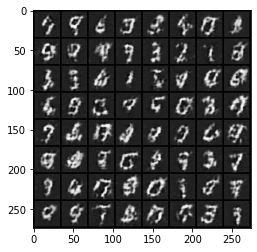

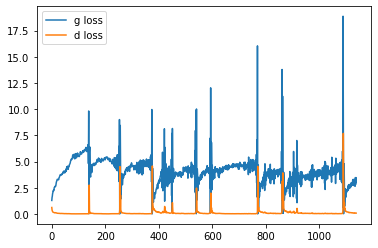

it: 1338; g_loss: 4.101010322570801; d_loss: 0.0343233197927475; avg_real_score: 0.953558087348938; avg_fake_score: 0.022534025833010674: : 399it [00:33, 12.44it/s]

epoch 2 generated images


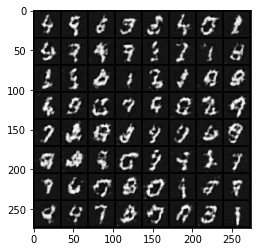

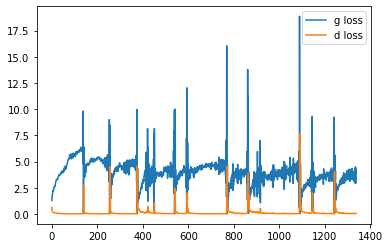

it: 1406; g_loss: 2.4292116165161133; d_loss: 0.09232389181852341; avg_real_score: 0.8933321833610535; avg_fake_score: 0.10722117871046066: : 469it [00:39, 11.93it/s]
it: 1407; g_loss: 3.440918207168579; d_loss: 0.09343375265598297; avg_real_score: 0.9438199996948242; avg_fake_score: 0.044574737548828125: : 0it [00:00, ?it/s]

epoch 3 generated images


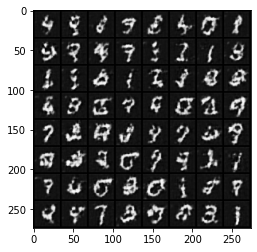

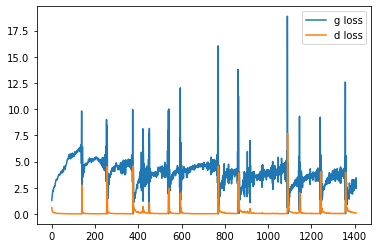

it: 1607; g_loss: 3.1754884719848633; d_loss: 0.18744510412216187; avg_real_score: 0.9172273874282837; avg_fake_score: 0.0541972741484642: : 199it [00:17, 12.07it/s] 

epoch 3 generated images


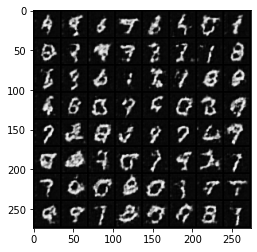

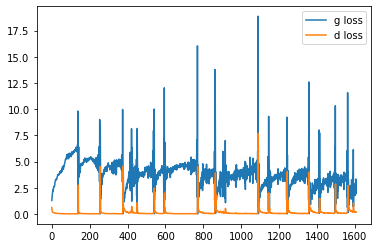

it: 1807; g_loss: 5.842361927032471; d_loss: 0.25415876507759094; avg_real_score: 0.9831411838531494; avg_fake_score: 0.004172944463789463: : 399it [00:34, 11.84it/s]

epoch 3 generated images


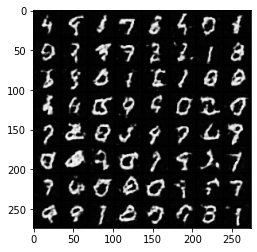

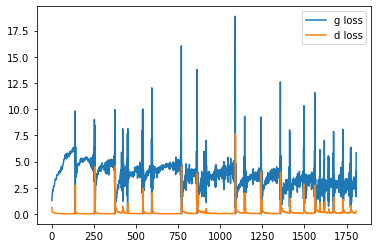

it: 1875; g_loss: 2.8155455589294434; d_loss: 0.11174120754003525; avg_real_score: 0.96234130859375; avg_fake_score: 0.07539480924606323: : 469it [00:40, 11.59it/s]
it: 1876; g_loss: 3.8248510360717773; d_loss: 0.10642300546169281; avg_real_score: 0.9367071390151978; avg_fake_score: 0.03132054954767227: : 0it [00:00, ?it/s]

epoch 4 generated images


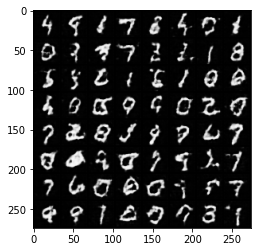

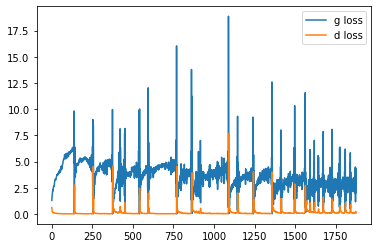

it: 2076; g_loss: 3.4484429359436035; d_loss: 0.06476444005966187; avg_real_score: 0.9555432796478271; avg_fake_score: 0.04321078956127167: : 199it [00:17, 11.99it/s]

epoch 4 generated images


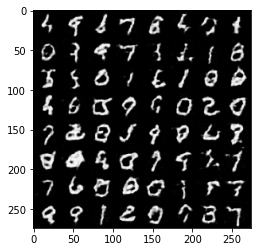

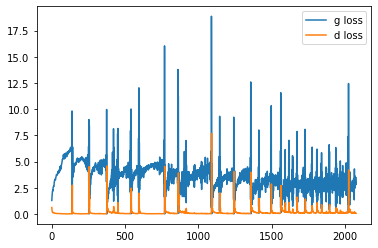

it: 2276; g_loss: 3.43379545211792; d_loss: 0.08949138224124908; avg_real_score: 0.948862612247467; avg_fake_score: 0.04498445987701416: : 399it [00:36, 10.39it/s]  

epoch 4 generated images


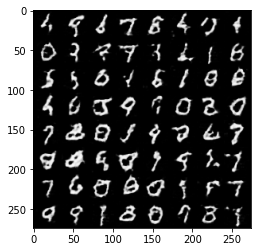

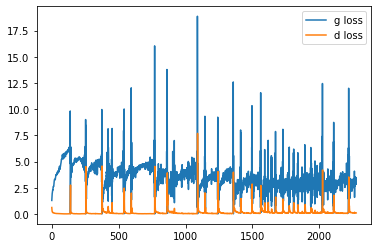

it: 2344; g_loss: 3.5321826934814453; d_loss: 0.052356455475091934; avg_real_score: 0.9618114829063416; avg_fake_score: 0.04205700755119324: : 469it [00:43, 10.82it/s]
it: 2345; g_loss: 3.930002212524414; d_loss: 0.04397787153720856; avg_real_score: 0.9663868546485901; avg_fake_score: 0.028600534424185753: : 0it [00:00, ?it/s]

epoch 5 generated images


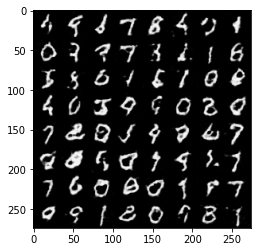

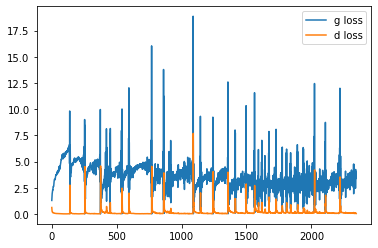

it: 2545; g_loss: 3.213517665863037; d_loss: 0.07806368917226791; avg_real_score: 0.9513411521911621; avg_fake_score: 0.06257542967796326: : 200it [00:19, 10.52it/s]

epoch 5 generated images


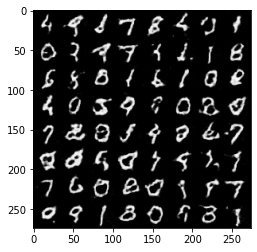

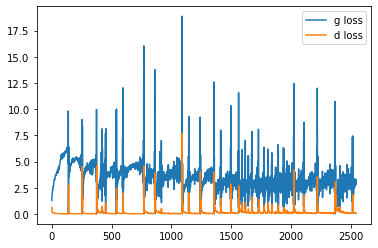

it: 2745; g_loss: 3.933096408843994; d_loss: 0.05621339753270149; avg_real_score: 0.9648613929748535; avg_fake_score: 0.029763221740722656: : 400it [00:39, 10.46it/s]

epoch 5 generated images


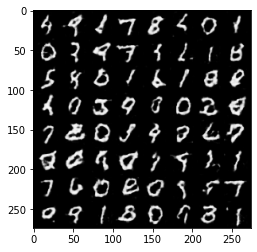

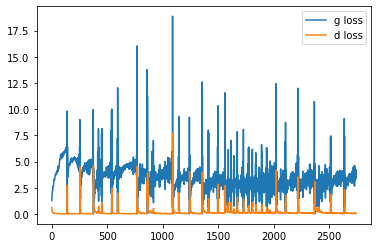

it: 2813; g_loss: 2.6448898315429688; d_loss: 0.06481796503067017; avg_real_score: 0.9047983884811401; avg_fake_score: 0.11003115028142929: : 469it [00:46, 10.15it/s]
it: 2814; g_loss: 4.853536605834961; d_loss: 0.0659433901309967; avg_real_score: 0.9900052547454834; avg_fake_score: 0.013220135122537613: : 0it [00:00, ?it/s]

epoch 6 generated images


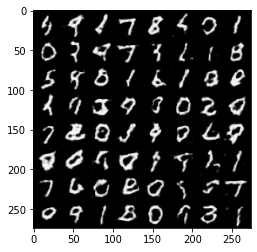

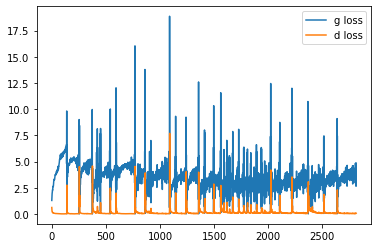

it: 3014; g_loss: 3.396975040435791; d_loss: 0.06897466629743576; avg_real_score: 0.8951681852340698; avg_fake_score: 0.05270121991634369: : 200it [00:20,  9.53it/s] 

epoch 6 generated images


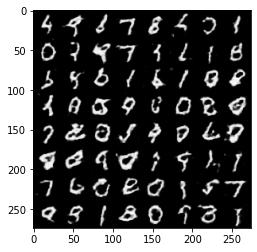

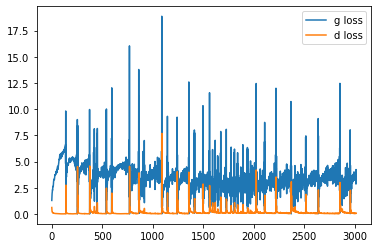

it: 3214; g_loss: 4.013619422912598; d_loss: 0.022219201549887657; avg_real_score: 0.9715824127197266; avg_fake_score: 0.029859796166419983: : 399it [00:40, 10.16it/s]

epoch 6 generated images


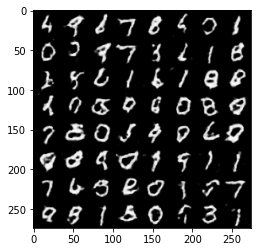

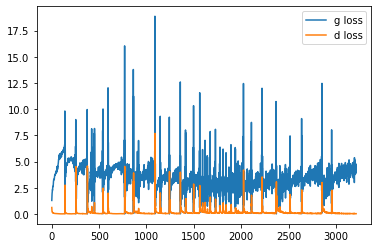

it: 3282; g_loss: 4.314288139343262; d_loss: 0.03283308818936348; avg_real_score: 0.9702849388122559; avg_fake_score: 0.022054094821214676: : 469it [00:47,  9.87it/s]
it: 3283; g_loss: 4.512700080871582; d_loss: 0.020305201411247253; avg_real_score: 0.9738591909408569; avg_fake_score: 0.019832970574498177: : 0it [00:00, ?it/s]

epoch 7 generated images


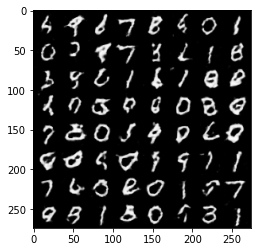

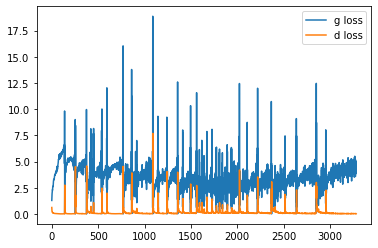

it: 3483; g_loss: 5.05196475982666; d_loss: 0.018417365849018097; avg_real_score: 0.993966817855835; avg_fake_score: 0.011515175923705101: : 200it [00:20,  9.83it/s]

epoch 7 generated images


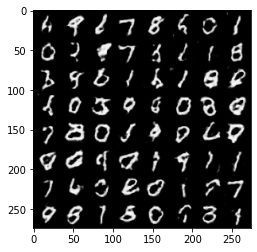

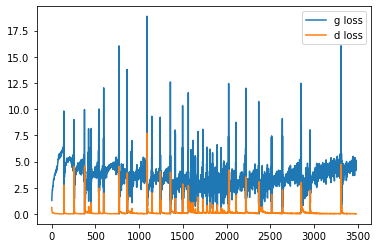

it: 3683; g_loss: 5.768786430358887; d_loss: 0.028196588158607483; avg_real_score: 0.9977038502693176; avg_fake_score: 0.005839746445417404: : 400it [00:41,  9.64it/s]

epoch 7 generated images


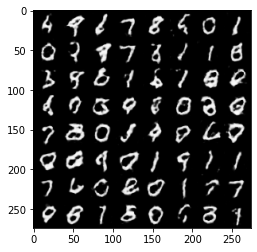

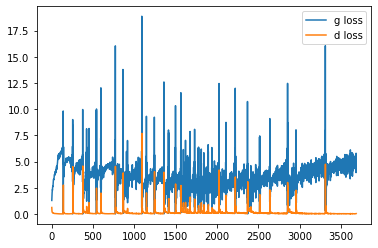

it: 3751; g_loss: 5.099261283874512; d_loss: 0.013443627394735813; avg_real_score: 0.9860171675682068; avg_fake_score: 0.011276815086603165: : 469it [00:49,  9.57it/s]
it: 3752; g_loss: 5.004451751708984; d_loss: 0.013707435689866543; avg_real_score: 0.9856404066085815; avg_fake_score: 0.013745063915848732: : 0it [00:00, ?it/s]

epoch 8 generated images


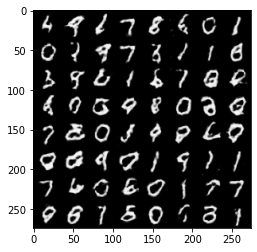

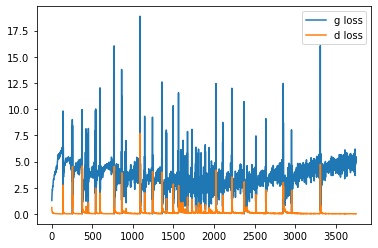

it: 3952; g_loss: 2.659193754196167; d_loss: 0.26874658465385437; avg_real_score: 0.925103485584259; avg_fake_score: 0.09533647447824478: : 200it [00:21,  9.35it/s]

epoch 8 generated images


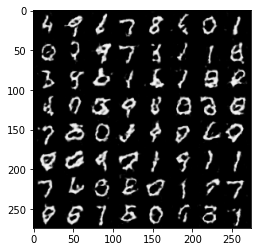

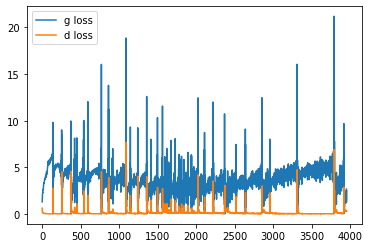

it: 4152; g_loss: 4.602023124694824; d_loss: 0.0224471278488636; avg_real_score: 0.9799062013626099; avg_fake_score: 0.01996813900768757: : 400it [00:42,  9.38it/s]   

epoch 8 generated images


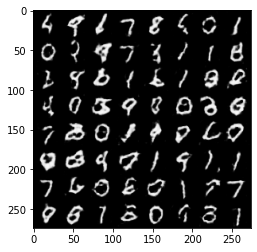

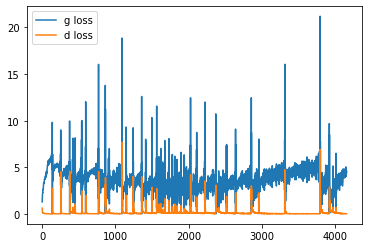

it: 4220; g_loss: 5.472957134246826; d_loss: 0.016469070687890053; avg_real_score: 0.9767441749572754; avg_fake_score: 0.00874786451458931: : 469it [00:50,  9.32it/s]
it: 4221; g_loss: 5.044968605041504; d_loss: 0.013782588765025139; avg_real_score: 0.981852650642395; avg_fake_score: 0.013667111285030842: : 0it [00:00, ?it/s]

epoch 9 generated images


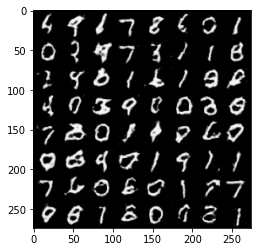

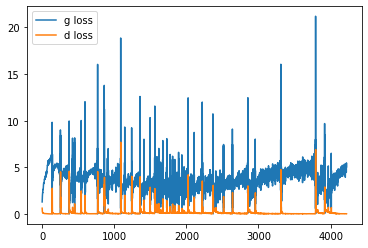

it: 4421; g_loss: 5.886073112487793; d_loss: 0.009314311668276787; avg_real_score: 0.987618088722229; avg_fake_score: 0.006111385766416788: : 199it [00:21,  9.19it/s] 

epoch 9 generated images


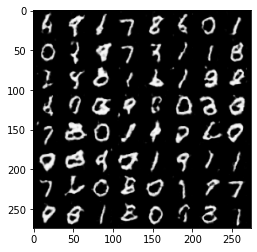

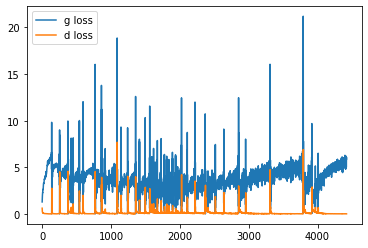

it: 4621; g_loss: 5.986124038696289; d_loss: 0.012475908733904362; avg_real_score: 0.9976267218589783; avg_fake_score: 0.005499218124896288: : 400it [00:43,  9.38it/s]

epoch 9 generated images


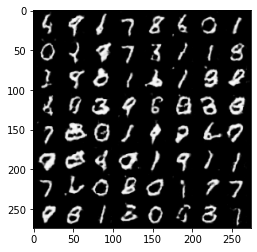

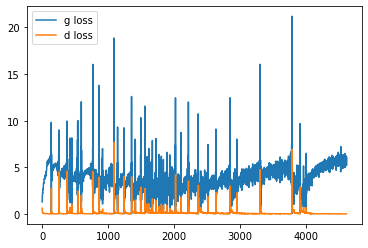

it: 4689; g_loss: 5.794552803039551; d_loss: 0.006648493930697441; avg_real_score: 0.9944822192192078; avg_fake_score: 0.00564631586894393: : 469it [00:50,  9.23it/s]
it: 4690; g_loss: 6.158470153808594; d_loss: 0.008081300184130669; avg_real_score: 0.9935935735702515; avg_fake_score: 0.004834458231925964: : 0it [00:00, ?it/s]

epoch 10 generated images


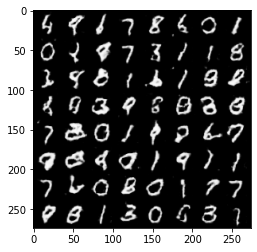

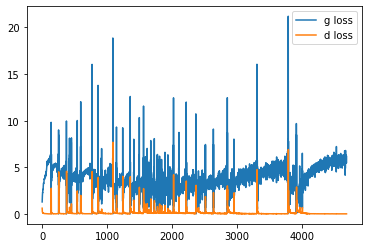

it: 4890; g_loss: 2.79451847076416; d_loss: 0.1568392962217331; avg_real_score: 0.9712375402450562; avg_fake_score: 0.10128070414066315: : 200it [00:21,  9.14it/s] 

epoch 10 generated images


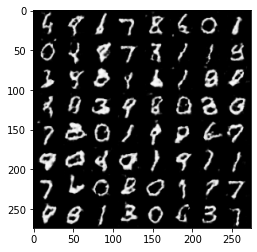

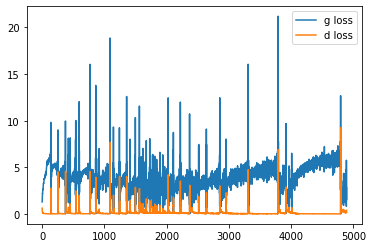

it: 5090; g_loss: 4.950336456298828; d_loss: 0.018855104222893715; avg_real_score: 0.987612247467041; avg_fake_score: 0.014032833278179169: : 400it [00:43,  9.17it/s]

epoch 10 generated images


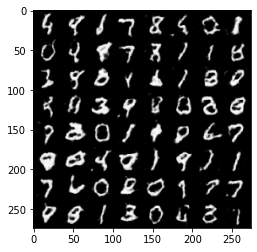

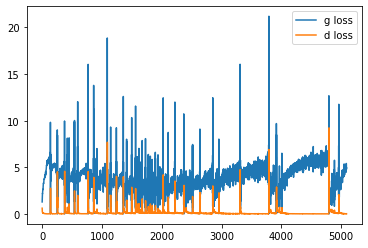

it: 5158; g_loss: 4.863408088684082; d_loss: 0.01959635689854622; avg_real_score: 0.9786951541900635; avg_fake_score: 0.017322538420557976: : 469it [00:51,  9.10it/s]
it: 5159; g_loss: 5.7846808433532715; d_loss: 0.016968518495559692; avg_real_score: 0.9925670623779297; avg_fake_score: 0.009349728003144264: : 0it [00:00, ?it/s]

epoch 11 generated images


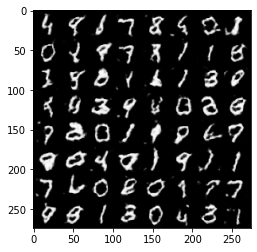

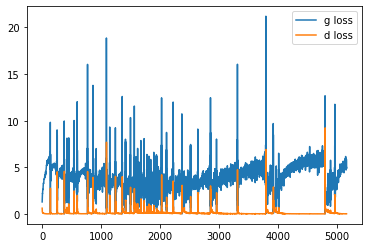

it: 5359; g_loss: 6.63356876373291; d_loss: 0.005899283103644848; avg_real_score: 0.9931228756904602; avg_fake_score: 0.004261355847120285: : 200it [00:22,  9.03it/s] 

epoch 11 generated images


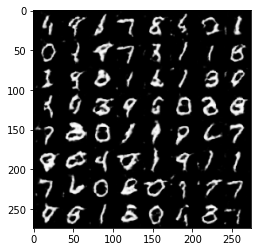

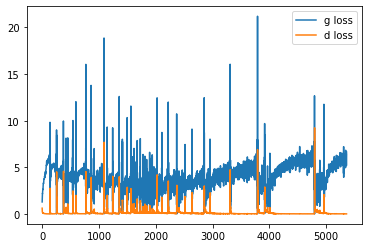

it: 5559; g_loss: 6.56090784072876; d_loss: 0.006506303325295448; avg_real_score: 0.991864025592804; avg_fake_score: 0.004855933599174023: : 400it [00:44,  8.76it/s]    

epoch 11 generated images


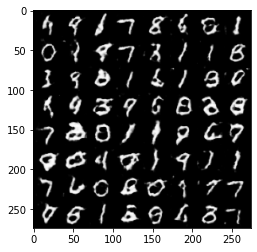

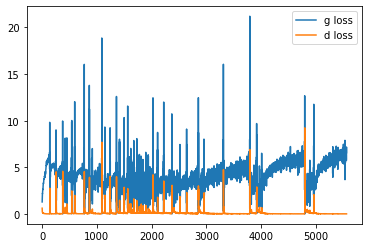

it: 5627; g_loss: 6.973519802093506; d_loss: 0.005776125937700272; avg_real_score: 0.9902655482292175; avg_fake_score: 0.002267384435981512: : 469it [00:52,  8.97it/s]
it: 5628; g_loss: 6.706910133361816; d_loss: 0.0035822978243231773; avg_real_score: 0.9951419830322266; avg_fake_score: 0.0033537056297063828: : 0it [00:00, ?it/s]

epoch 12 generated images


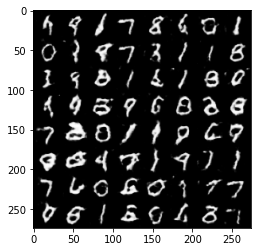

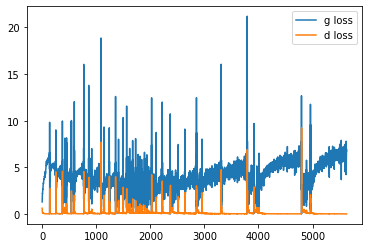

it: 5828; g_loss: 6.799928665161133; d_loss: 0.005038199480623007; avg_real_score: 0.9958975315093994; avg_fake_score: 0.0035519690718501806: : 200it [00:22,  9.09it/s] 

epoch 12 generated images


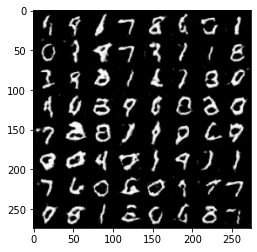

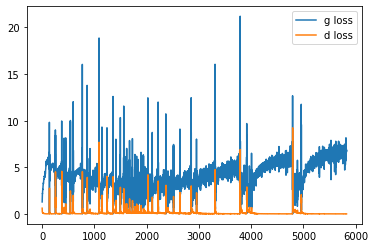

it: 6028; g_loss: 7.404694080352783; d_loss: 0.0015997773734852672; avg_real_score: 0.9981496930122375; avg_fake_score: 0.0016486791428178549: : 400it [00:44,  8.90it/s]

epoch 12 generated images


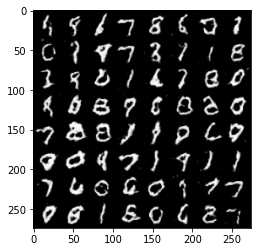

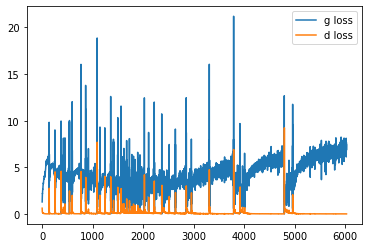

it: 6096; g_loss: 6.907875061035156; d_loss: 0.002880260581150651; avg_real_score: 0.9954861402511597; avg_fake_score: 0.0021957838907837868: : 469it [00:52,  8.87it/s]
it: 6097; g_loss: 7.362405776977539; d_loss: 0.0012837896356359124; avg_real_score: 0.9983966946601868; avg_fake_score: 0.0014236768474802375: : 0it [00:00, ?it/s]

epoch 13 generated images


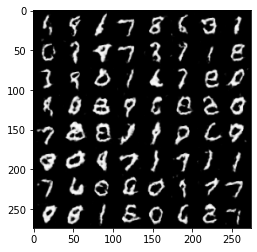

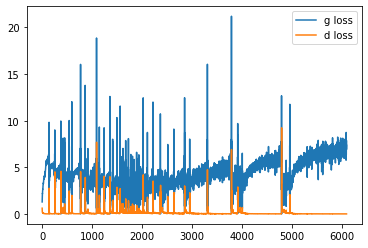

it: 6297; g_loss: 7.711706161499023; d_loss: 0.0015504155308008194; avg_real_score: 0.9986053109169006; avg_fake_score: 0.0015226231189444661: : 200it [00:22,  8.94it/s]

epoch 13 generated images


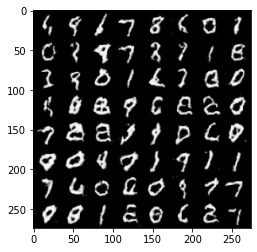

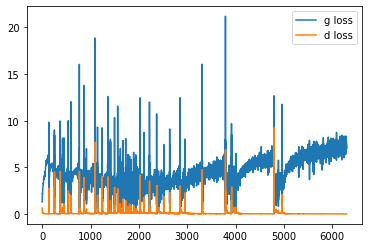

it: 6497; g_loss: 5.852533340454102; d_loss: 0.005232841242104769; avg_real_score: 0.9912340044975281; avg_fake_score: 0.009191330522298813: : 400it [00:45,  8.72it/s]  

epoch 13 generated images


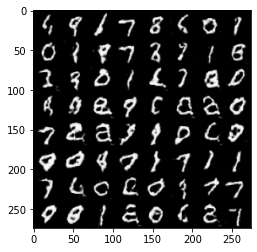

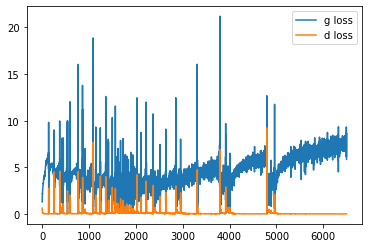

it: 6565; g_loss: 7.741006374359131; d_loss: 0.0013259249972179532; avg_real_score: 0.9994255900382996; avg_fake_score: 0.0011299308389425278: : 469it [00:53,  8.74it/s]
it: 6566; g_loss: 7.417386054992676; d_loss: 0.0021139453165233135; avg_real_score: 0.9970669746398926; avg_fake_score: 0.0015348508022725582: : 0it [00:00, ?it/s]

epoch 14 generated images


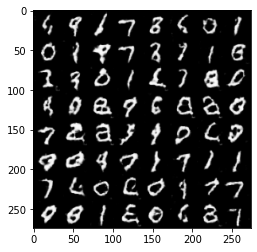

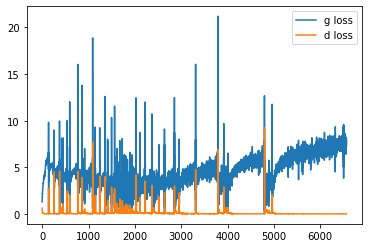

it: 6766; g_loss: 7.727635383605957; d_loss: 0.0013132833410054445; avg_real_score: 0.9982147216796875; avg_fake_score: 0.0011665017809718847: : 200it [00:22,  8.91it/s]

epoch 14 generated images


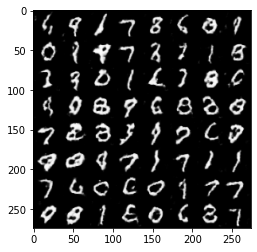

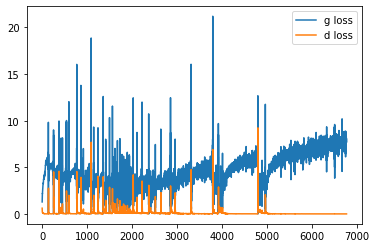

it: 6966; g_loss: 9.887191772460938; d_loss: 0.0013001468032598495; avg_real_score: 0.9976232647895813; avg_fake_score: 0.00015136966248974204: : 400it [00:45,  8.95it/s]

epoch 14 generated images


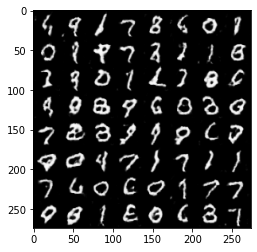

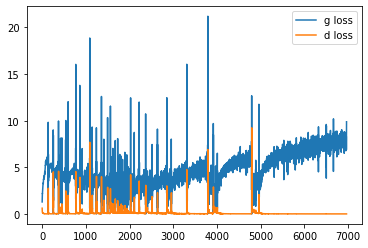

it: 7034; g_loss: 39.931671142578125; d_loss: 19.492862701416016; avg_real_score: 7.368960483315496e-15; avg_fake_score: 5.194096029814015e-16: : 469it [00:53,  8.74it/s]


In [ ]:
nb_epochs = 15

g_losses = []
d_losses = []


nz = 100
ngf = 4
ndf = 32

nchannels= 1 
lr_d = 0.0002
lr_g = 0.0005
beta1= 0.5
display_freq = 200

netD = Discriminator(ndf, nchannels).to(device)
netG = Generator(nz, ngf).to(device)

netD.apply(weights_init)
netG.apply(weights_init)

g_opt = torch.optim.Adam(netG.parameters(), lr=lr_g, betas=(beta1, 0.999))
d_opt = torch.optim.Adam(netD.parameters(), lr=lr_d, betas=(beta1, 0.999))
j = 0


z_test = sample_z(64, nz) # we generate the noise only once for testing

for epoch in range(nb_epochs):
    
    # train
    pbar = tqdm(enumerate(dataloader))
    for i, batch in pbar:
        im, _ = batch # we don't care about the label for unconditional generation
        im = im.to(device)
        
        cur_batch_size = im.shape[0]  
        
        # 1. sample a z vector 
        z = sample_z(cur_batch_size, nz)
        
        # 2. Generate a fake image

        fake_im = netG(z)

        # 3. Classify real image with D
        
        real_logits = netD(im)


        # 4. Classify fake image with D
       
        fake_logits = netD(fake_im.detach())
         
        ###
        ### Discriminator
        ###
        d_loss = criterion(real_logits, get_labels_one(cur_batch_size).to(device))
        d_loss = (d_loss + criterion(fake_logits, get_labels_zero(cur_batch_size).to(device)))/2
        d_opt.zero_grad()
        d_loss.backward() # we need to retain graph=True to be able to calculate the gradient in the g backprop
        d_opt.step()

        
        ###
        ### Generator
        ###
        
        fake_logits = netD(fake_im)
        g_loss = criterion(fake_logits, get_labels_one(cur_batch_size).to(device)) 
        g_opt.zero_grad()
        g_loss.backward()
        g_opt.step()
        
                
        d_losses.append(d_loss.item())
        g_losses.append(g_loss.item())
        
        avg_real_score = torch.mean(real_logits).item()
        avg_fake_score = torch.mean(fake_logits).item()


        pbar.set_description(f"it: {j}; g_loss: {g_loss}; d_loss: {d_loss}; avg_real_score: {avg_real_score}; avg_fake_score: {avg_fake_score}")
        if i % display_freq == 0:

            fake_im = netG(z_test)
            
            un_norm = renorm(fake_im) # for visualization
            
            grid = torchvision.utils.make_grid(un_norm, nrow=8)
            pil_grid = to_pil(grid)  
            
            print("epoch", epoch, "generated images")
            plt.imshow(pil_grid)
            plt.show()
            
            plt.plot(range(len(g_losses)), g_losses, label='g loss')
            plt.plot(range(len(g_losses)), d_losses, label='d loss')
            
            plt.legend()
            plt.show()  
        j += 1

##Replace Custom init weights




it: 0; g_loss: 0.8987840414047241; d_loss: 0.6724537014961243; avg_real_score: 0.5249918699264526; avg_fake_score: 0.4149198830127716: : 0it [00:00, ?it/s]

epoch 0 generated images


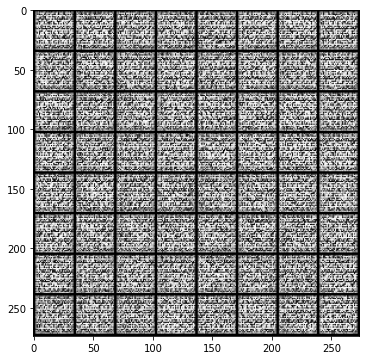

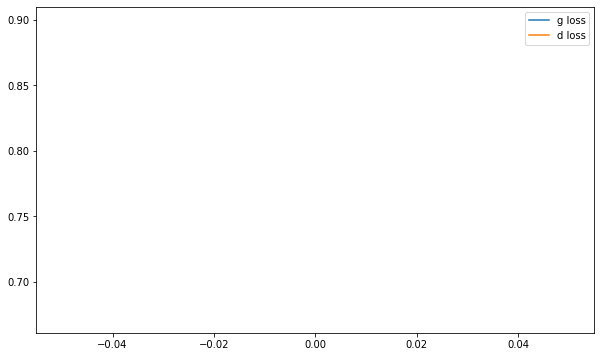

it: 200; g_loss: 1.3476768732070923; d_loss: 0.3952598571777344; avg_real_score: 0.6400716304779053; avg_fake_score: 0.2758095860481262: : 198it [00:11, 19.20it/s]

epoch 0 generated images


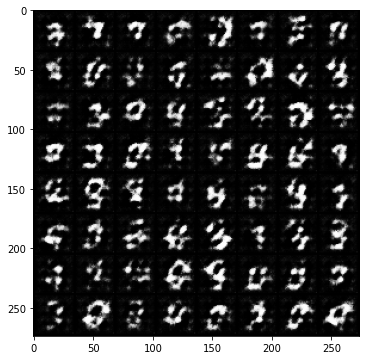

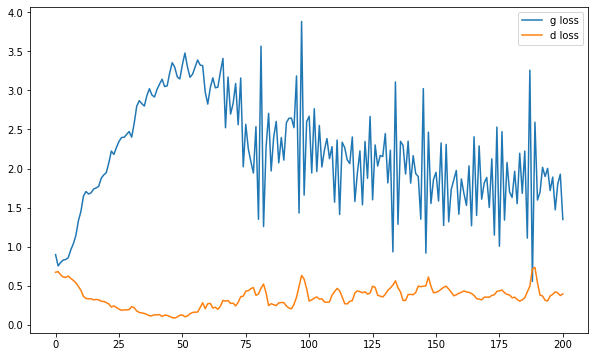

it: 400; g_loss: 1.4723303318023682; d_loss: 0.3558920621871948; avg_real_score: 0.5794616937637329; avg_fake_score: 0.24813254177570343: : 399it [00:21, 19.79it/s]

epoch 0 generated images


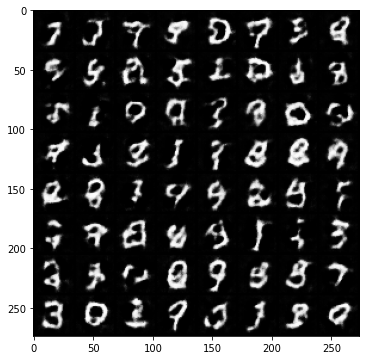

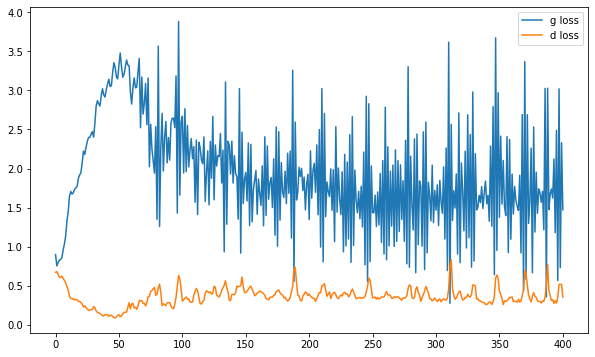

it: 468; g_loss: 1.489431381225586; d_loss: 0.2595004439353943; avg_real_score: 0.7445759773254395; avg_fake_score: 0.24365797638893127: : 469it [00:25, 18.47it/s]
it: 469; g_loss: 1.9097093343734741; d_loss: 0.2892910838127136; avg_real_score: 0.8028193116188049; avg_fake_score: 0.16429340839385986: : 0it [00:00, ?it/s]

epoch 1 generated images


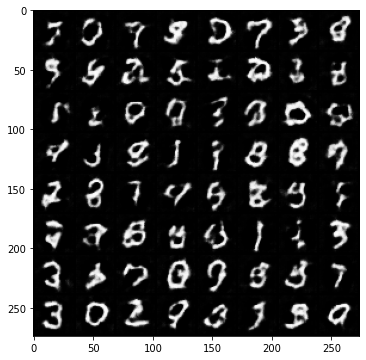

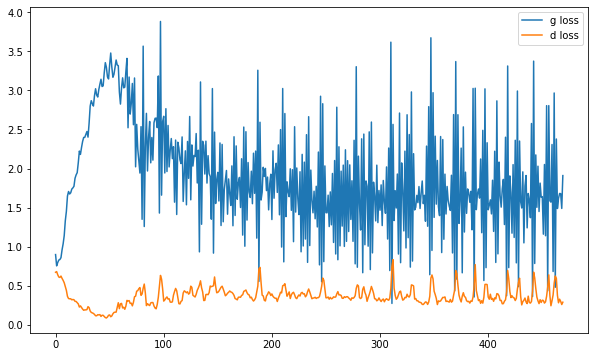

it: 669; g_loss: 1.6918091773986816; d_loss: 0.2732672095298767; avg_real_score: 0.713286280632019; avg_fake_score: 0.2033950388431549: : 199it [00:11, 18.96it/s]   

epoch 1 generated images


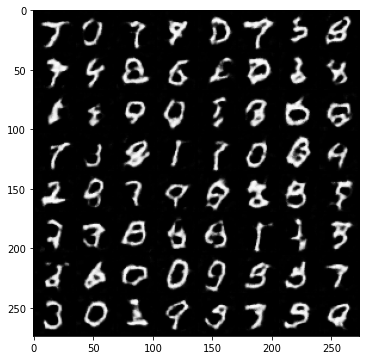

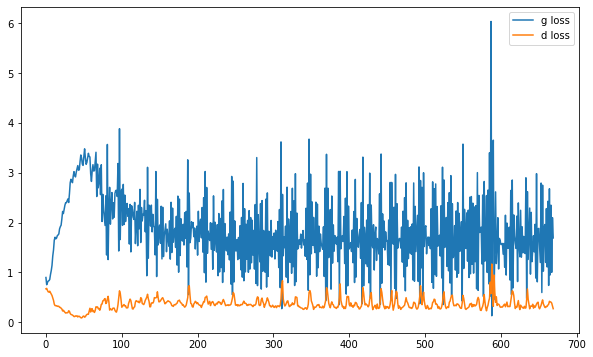

it: 869; g_loss: 0.963392972946167; d_loss: 0.3204704225063324; avg_real_score: 0.6496683359146118; avg_fake_score: 0.4035196900367737: : 399it [00:22, 17.71it/s]  

epoch 1 generated images


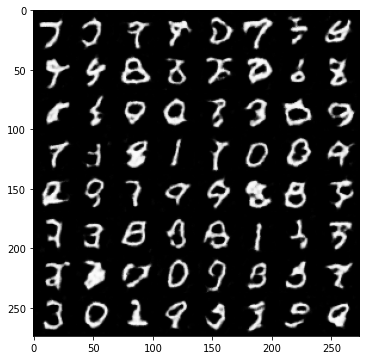

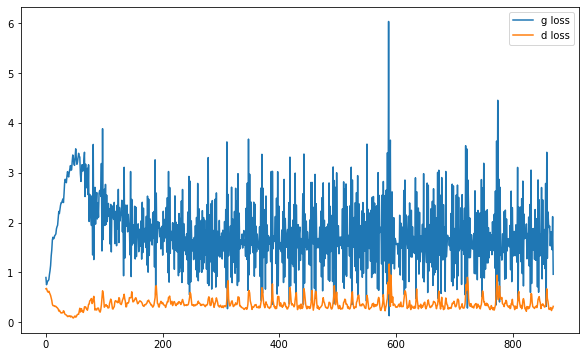

it: 937; g_loss: 2.1989364624023438; d_loss: 0.44126906991004944; avg_real_score: 0.8430754542350769; avg_fake_score: 0.12466015666723251: : 469it [00:26, 17.69it/s]
it: 938; g_loss: 1.3908909559249878; d_loss: 0.34940582513809204; avg_real_score: 0.6114981174468994; avg_fake_score: 0.27052736282348633: : 0it [00:00, ?it/s]

epoch 2 generated images


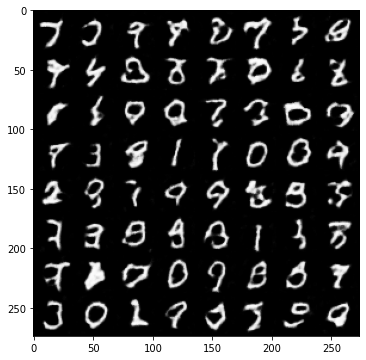

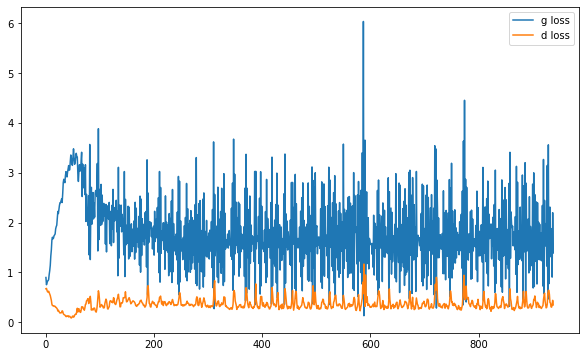

it: 1138; g_loss: 1.3955330848693848; d_loss: 0.31516504287719727; avg_real_score: 0.6940014362335205; avg_fake_score: 0.27469220757484436: : 199it [00:11, 18.71it/s]

epoch 2 generated images


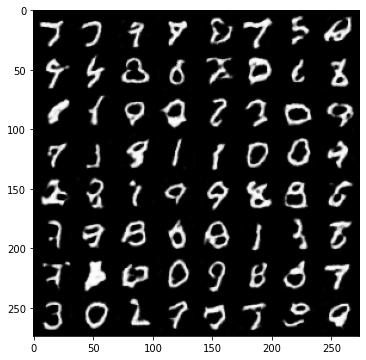

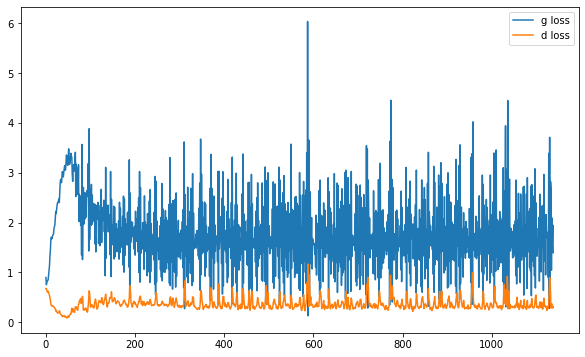

it: 1338; g_loss: 2.617508888244629; d_loss: 0.2594759464263916; avg_real_score: 0.8836349844932556; avg_fake_score: 0.09141278266906738: : 399it [00:22, 18.34it/s] 

epoch 2 generated images


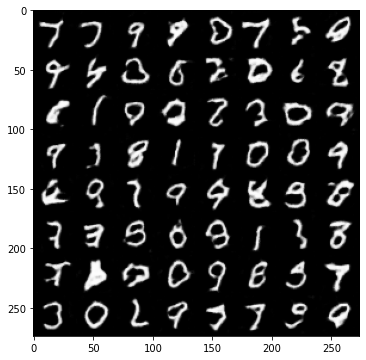

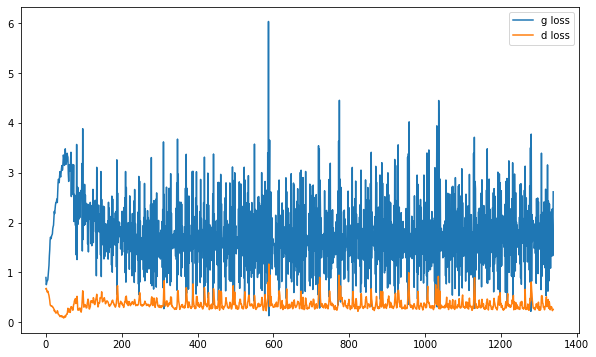

it: 1406; g_loss: 3.0262162685394287; d_loss: 0.2975997030735016; avg_real_score: 0.865444540977478; avg_fake_score: 0.05755528807640076: : 469it [00:26, 17.41it/s]
it: 1407; g_loss: 0.5278058052062988; d_loss: 0.4907326400279999; avg_real_score: 0.44836345314979553; avg_fake_score: 0.6092733144760132: : 0it [00:00, ?it/s]

epoch 3 generated images


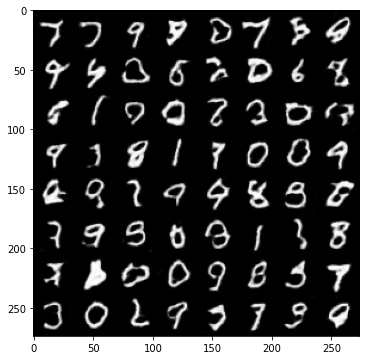

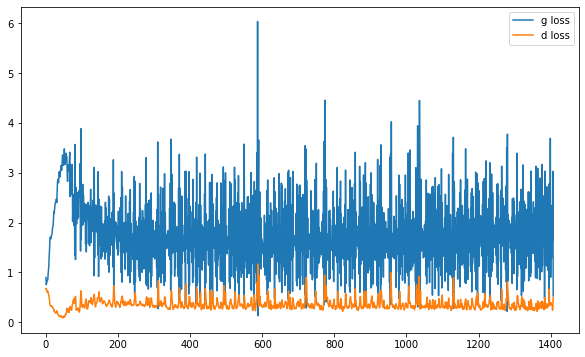

it: 1607; g_loss: 1.2347817420959473; d_loss: 0.23032377660274506; avg_real_score: 0.7259232997894287; avg_fake_score: 0.3216894268989563: : 199it [00:11, 17.86it/s]

epoch 3 generated images


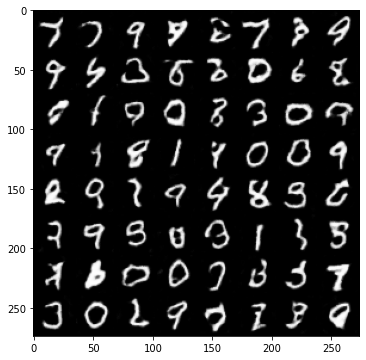

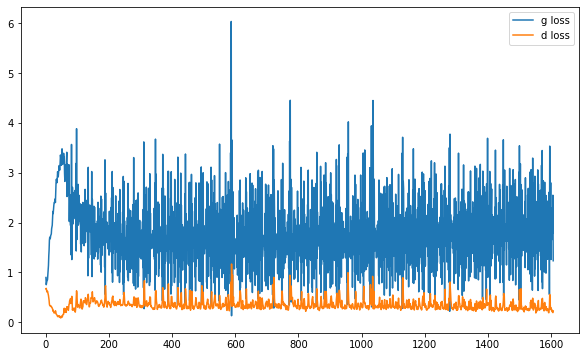

it: 1807; g_loss: 3.731771230697632; d_loss: 0.3802942931652069; avg_real_score: 0.9314092397689819; avg_fake_score: 0.029833320528268814: : 399it [00:23, 17.31it/s] 

epoch 3 generated images


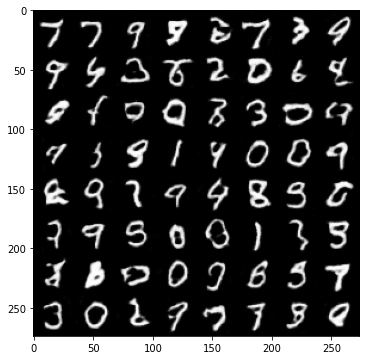

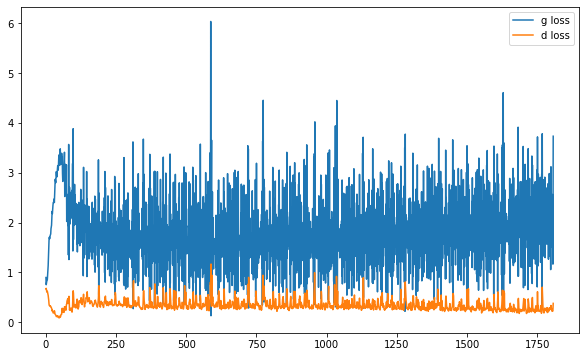

it: 1875; g_loss: 2.527468204498291; d_loss: 0.18010705709457397; avg_real_score: 0.8423842787742615; avg_fake_score: 0.09560643136501312: : 469it [00:27, 16.90it/s]
it: 1876; g_loss: 1.6107933521270752; d_loss: 0.20272837579250336; avg_real_score: 0.7709674835205078; avg_fake_score: 0.2301781326532364: : 0it [00:00, ?it/s]

epoch 4 generated images


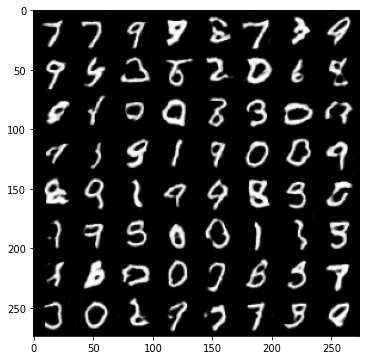

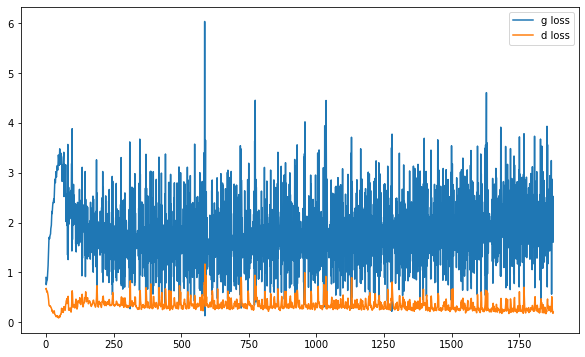

it: 2076; g_loss: 2.454326629638672; d_loss: 0.167918860912323; avg_real_score: 0.8614852428436279; avg_fake_score: 0.10912046581506729: : 199it [00:12, 17.25it/s] 

epoch 4 generated images


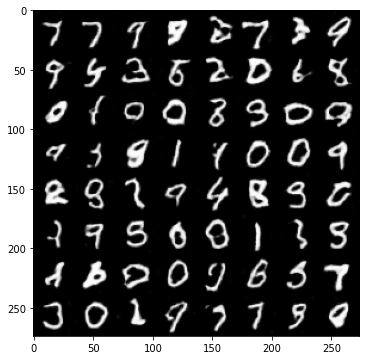

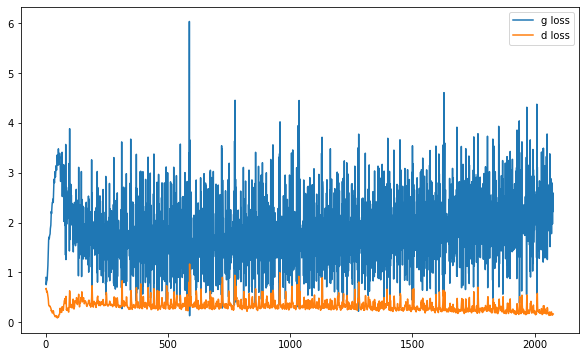

it: 2276; g_loss: 2.1154820919036865; d_loss: 0.13494417071342468; avg_real_score: 0.8305381536483765; avg_fake_score: 0.14753800630569458: : 399it [00:24, 16.51it/s]

epoch 4 generated images


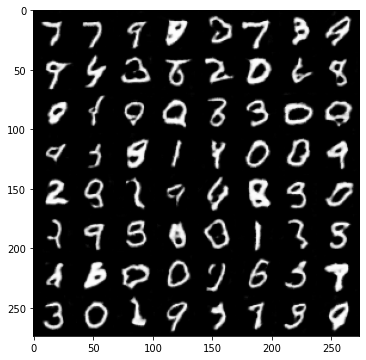

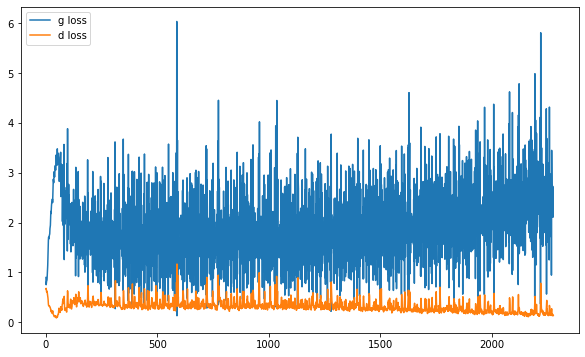

it: 2344; g_loss: 3.2588298320770264; d_loss: 0.14874425530433655; avg_real_score: 0.9445847272872925; avg_fake_score: 0.050797369331121445: : 469it [00:28, 16.37it/s]
it: 2345; g_loss: 2.2758657932281494; d_loss: 0.135898619890213; avg_real_score: 0.8222618699073792; avg_fake_score: 0.12946757674217224: : 0it [00:00, ?it/s]

epoch 5 generated images


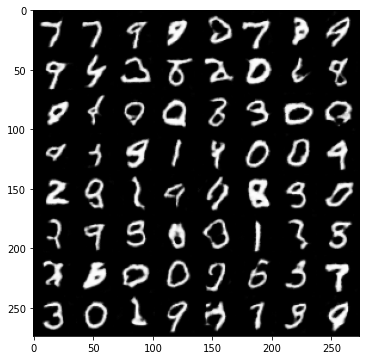

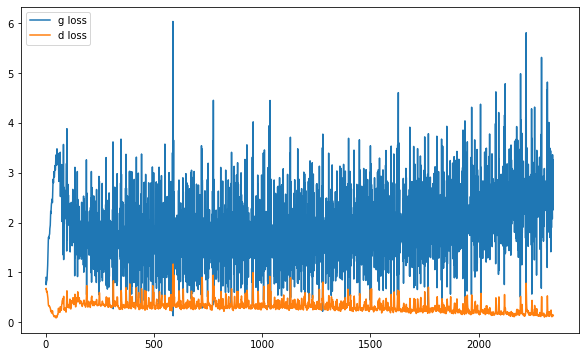

it: 2545; g_loss: 2.932377576828003; d_loss: 0.11692408472299576; avg_real_score: 0.8716179132461548; avg_fake_score: 0.06774241477251053: : 199it [00:12, 16.94it/s] 

epoch 5 generated images


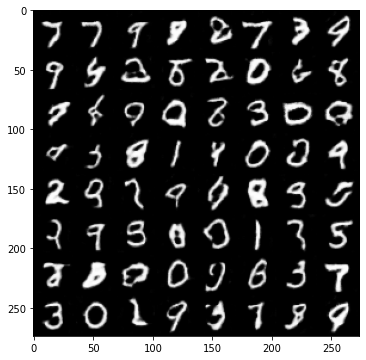

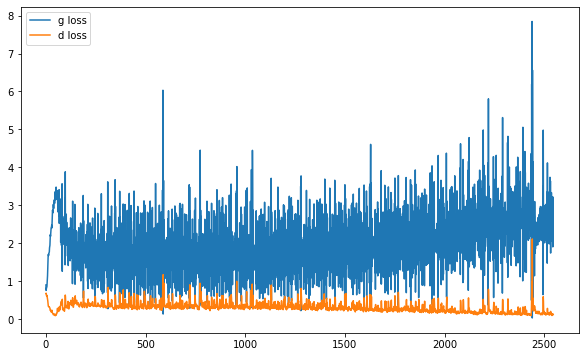

it: 2745; g_loss: 1.8490968942642212; d_loss: 0.34814032912254333; avg_real_score: 0.7285069227218628; avg_fake_score: 0.1865847110748291: : 399it [00:24, 17.05it/s]

epoch 5 generated images


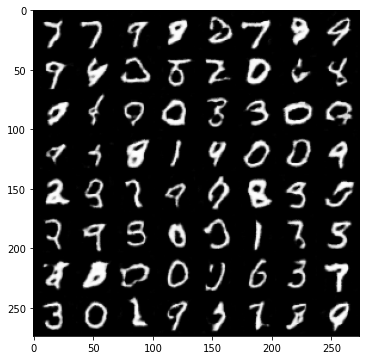

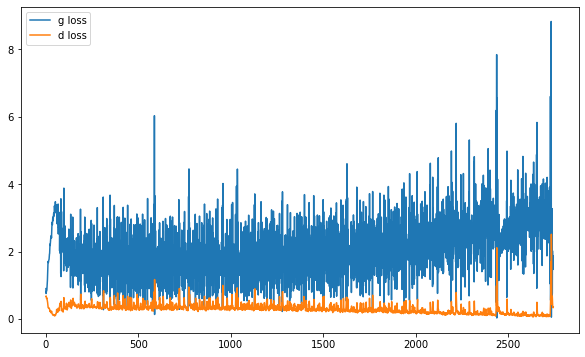

it: 2813; g_loss: 2.609630584716797; d_loss: 0.11167576164007187; avg_real_score: 0.877022922039032; avg_fake_score: 0.09460365027189255: : 469it [00:28, 16.42it/s]
it: 2814; g_loss: 2.3921868801116943; d_loss: 0.09969741106033325; avg_real_score: 0.8951717019081116; avg_fake_score: 0.1158444881439209: : 0it [00:00, ?it/s]

epoch 6 generated images


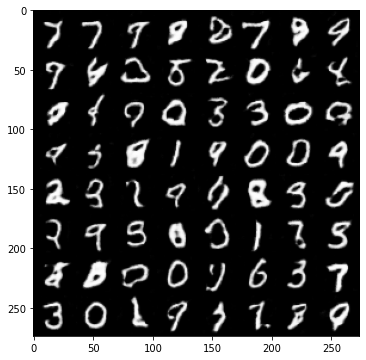

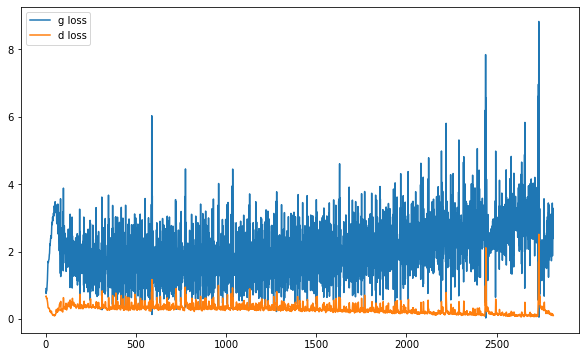

it: 3014; g_loss: 3.4775304794311523; d_loss: 0.10096526890993118; avg_real_score: 0.9722827672958374; avg_fake_score: 0.04470795765519142: : 199it [00:12, 16.88it/s]

epoch 6 generated images


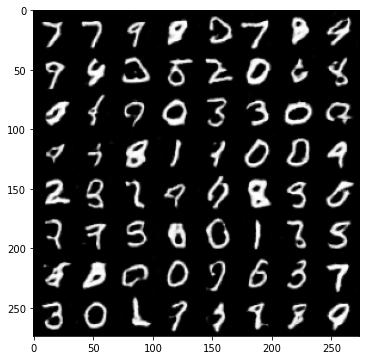

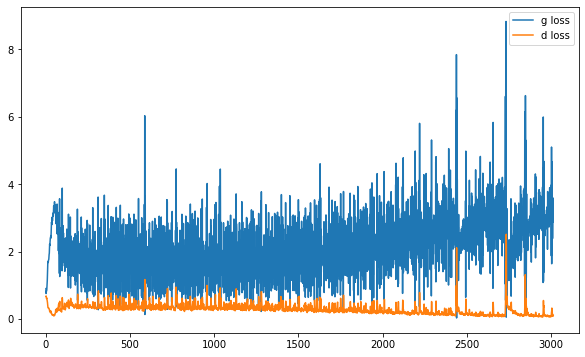

it: 3214; g_loss: 1.5643393993377686; d_loss: 0.12198363244533539; avg_real_score: 0.8195543885231018; avg_fake_score: 0.2585444152355194: : 399it [00:24, 16.60it/s]  

epoch 6 generated images


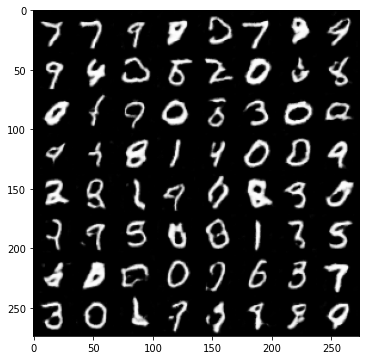

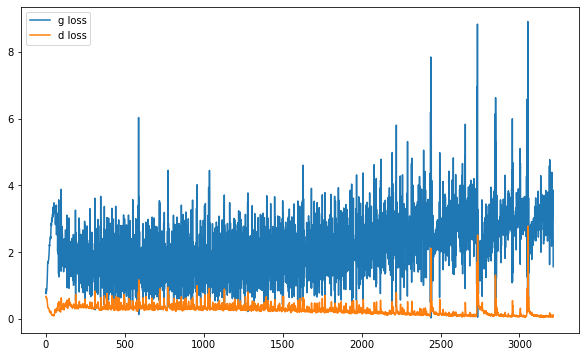

it: 3282; g_loss: 2.718414068222046; d_loss: 0.08546663820743561; avg_real_score: 0.9058815836906433; avg_fake_score: 0.08859199285507202: : 469it [00:29, 16.07it/s]
it: 3283; g_loss: 3.480595111846924; d_loss: 0.07940414547920227; avg_real_score: 0.9617389440536499; avg_fake_score: 0.04122650623321533: : 0it [00:00, ?it/s]

epoch 7 generated images


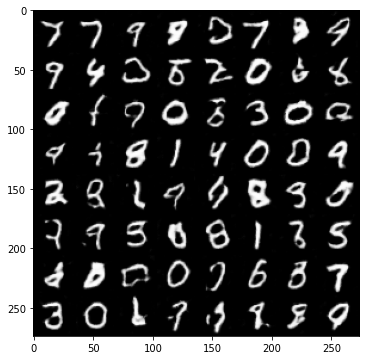

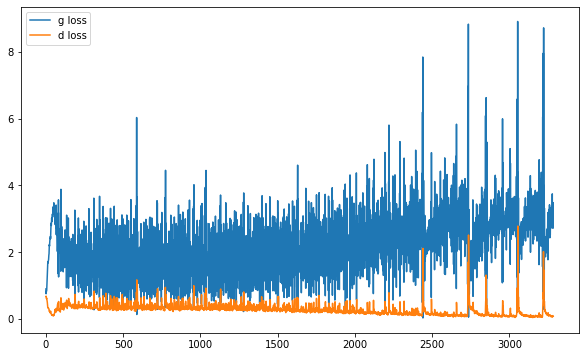

it: 3483; g_loss: 2.905306577682495; d_loss: 0.08097150921821594; avg_real_score: 0.8915880918502808; avg_fake_score: 0.07583382725715637: : 199it [00:12, 16.33it/s]  

epoch 7 generated images


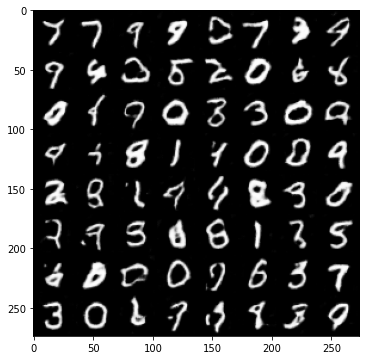

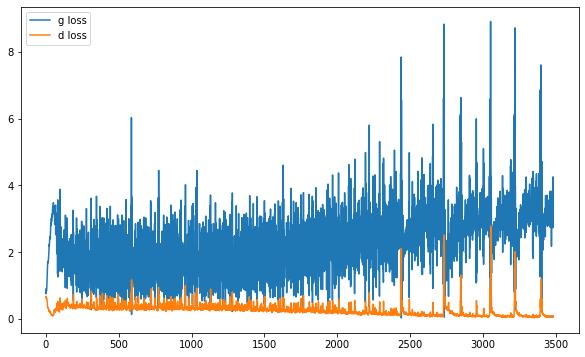

it: 3683; g_loss: 3.9392786026000977; d_loss: 0.08921606093645096; avg_real_score: 0.9621293544769287; avg_fake_score: 0.027399817481637: : 399it [00:24, 17.13it/s]  

epoch 7 generated images


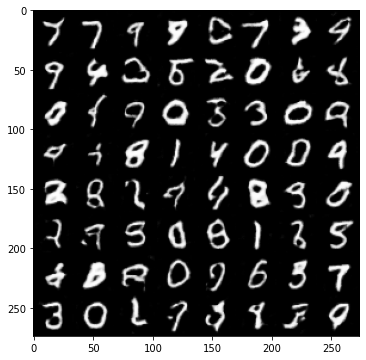

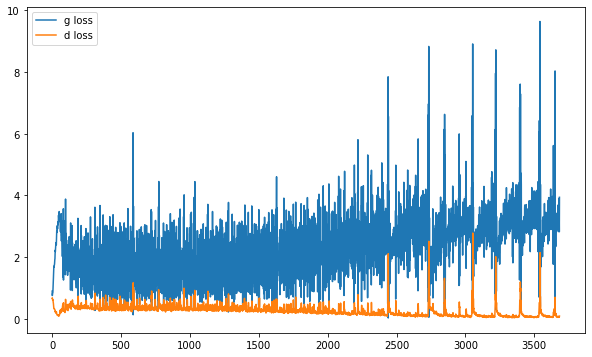

it: 3751; g_loss: 3.1227641105651855; d_loss: 0.05699934437870979; avg_real_score: 0.9466406106948853; avg_fake_score: 0.062172263860702515: : 469it [00:29, 16.12it/s]
it: 3752; g_loss: 4.01310920715332; d_loss: 0.04013243690133095; avg_real_score: 0.9784740805625916; avg_fake_score: 0.026583390310406685: : 0it [00:00, ?it/s]

epoch 8 generated images


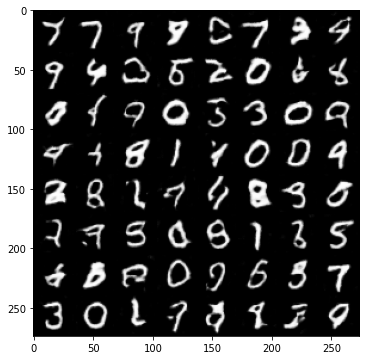

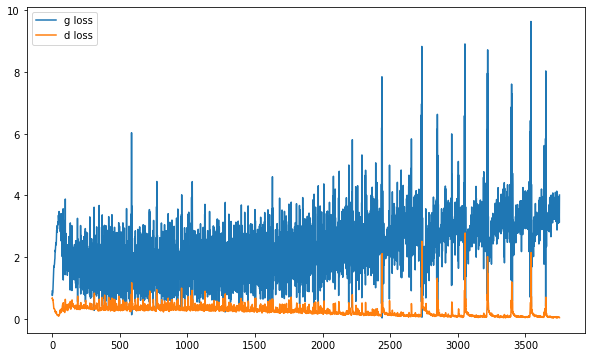

it: 3952; g_loss: 2.545043468475342; d_loss: 0.07819388061761856; avg_real_score: 0.8981090784072876; avg_fake_score: 0.11160488426685333: : 199it [00:12, 17.22it/s] 

epoch 8 generated images


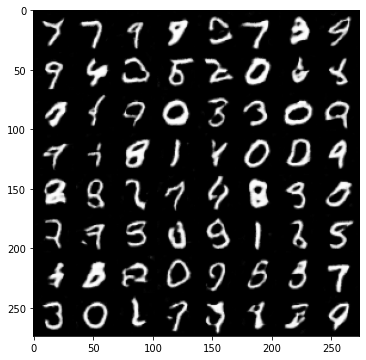

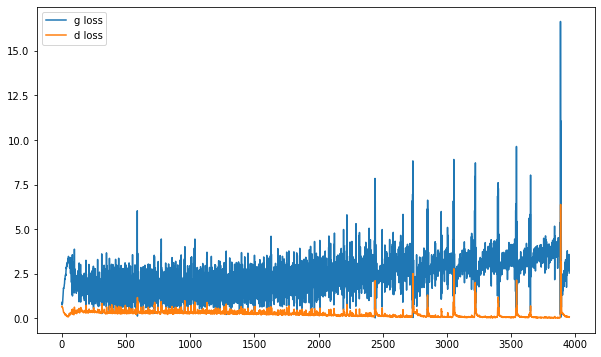

it: 4152; g_loss: 4.57179069519043; d_loss: 0.06243031471967697; avg_real_score: 0.9762018322944641; avg_fake_score: 0.016723282635211945: : 399it [00:24, 16.93it/s]

epoch 8 generated images


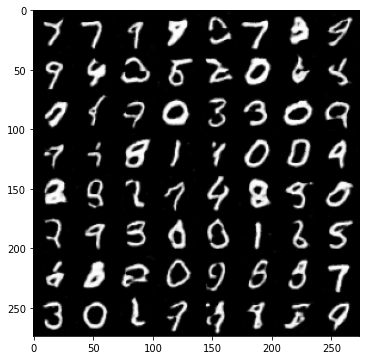

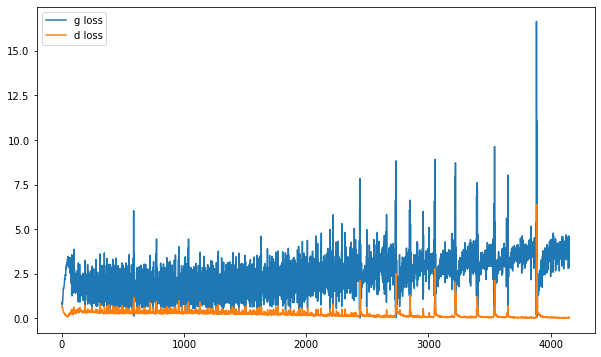

it: 4220; g_loss: 3.2724738121032715; d_loss: 0.15876072645187378; avg_real_score: 0.9658098220825195; avg_fake_score: 0.051808491349220276: : 469it [00:28, 16.27it/s]
it: 4221; g_loss: 3.2664413452148438; d_loss: 0.10363160073757172; avg_real_score: 0.8780360817909241; avg_fake_score: 0.05326643958687782: : 0it [00:00, ?it/s]

epoch 9 generated images


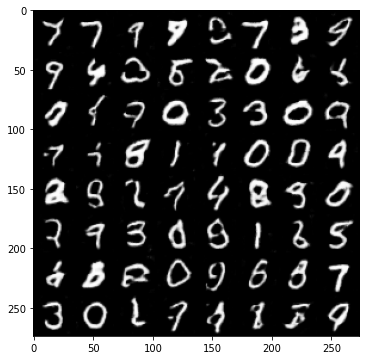

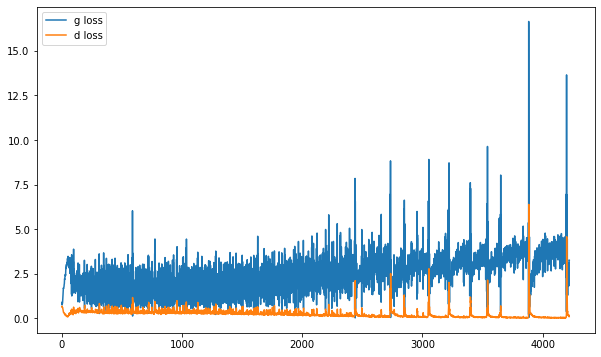

it: 4421; g_loss: 3.9185867309570312; d_loss: 0.03483251482248306; avg_real_score: 0.947778046131134; avg_fake_score: 0.030268510803580284: : 199it [00:12, 17.92it/s] 

epoch 9 generated images


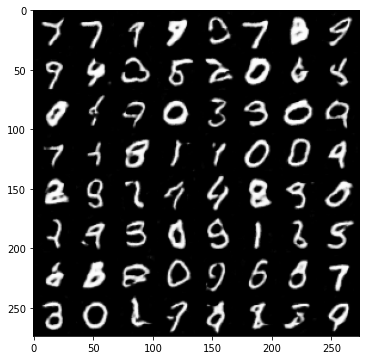

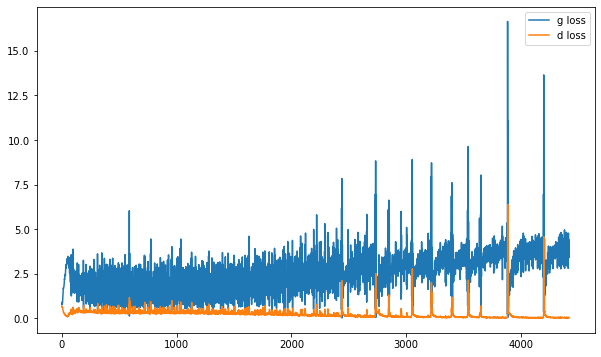

it: 4621; g_loss: 3.3685739040374756; d_loss: 0.056435711681842804; avg_real_score: 0.9285224080085754; avg_fake_score: 0.05151592195034027: : 399it [00:24, 17.44it/s]

epoch 9 generated images


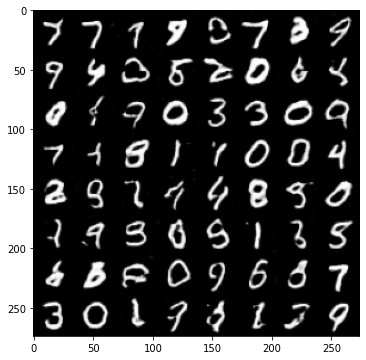

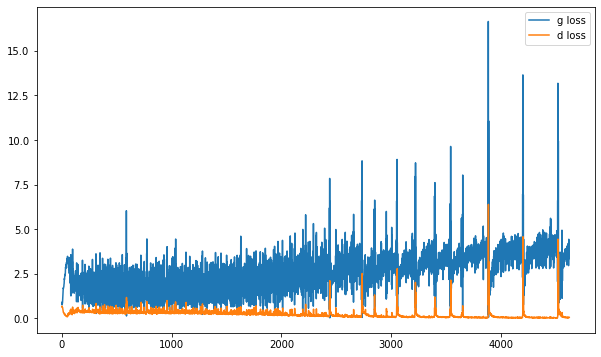

it: 4689; g_loss: 1.2620409727096558; d_loss: 0.2752577066421509; avg_real_score: 0.7014822959899902; avg_fake_score: 0.32372182607650757: : 469it [00:28, 16.32it/s]
it: 4690; g_loss: 3.2149817943573; d_loss: 0.28481364250183105; avg_real_score: 0.9391059279441833; avg_fake_score: 0.053178947418928146: : 0it [00:00, ?it/s]

epoch 10 generated images


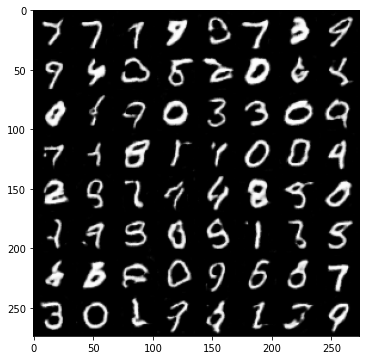

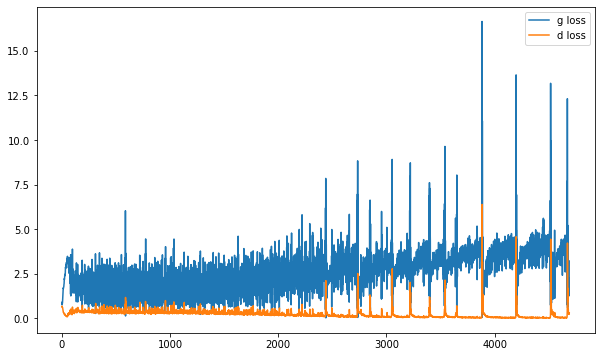

it: 4890; g_loss: 3.7625367641448975; d_loss: 0.040825530886650085; avg_real_score: 0.9531416893005371; avg_fake_score: 0.03630790114402771: : 199it [00:12, 17.51it/s]

epoch 10 generated images


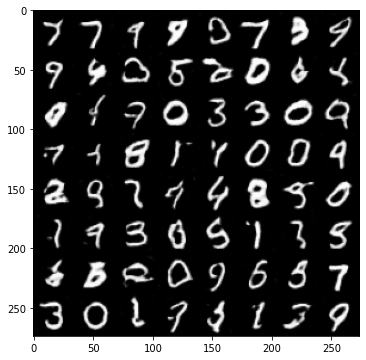

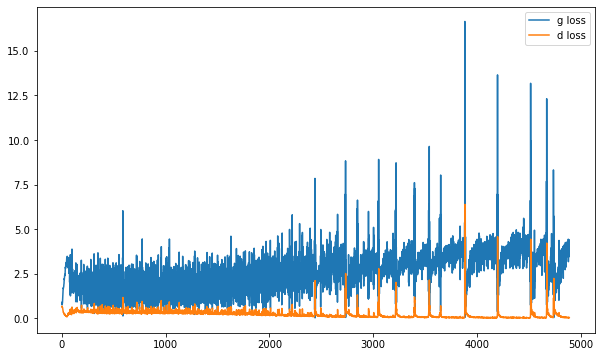

it: 5090; g_loss: 5.00311279296875; d_loss: 0.032223157584667206; avg_real_score: 0.9833387732505798; avg_fake_score: 0.011661073192954063: : 399it [00:24, 16.54it/s]  

epoch 10 generated images


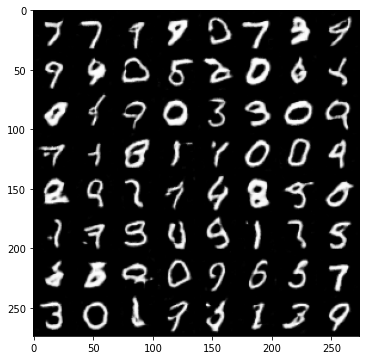

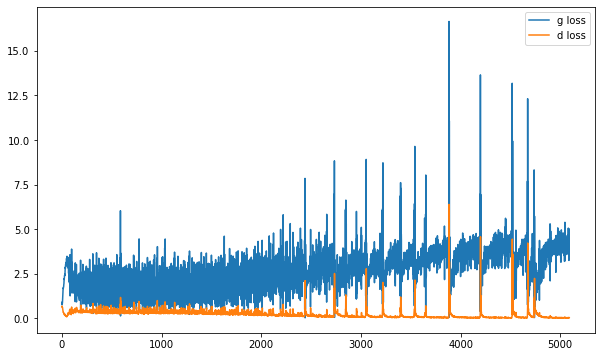

it: 5158; g_loss: 4.010858058929443; d_loss: 0.02648937702178955; avg_real_score: 0.9689130187034607; avg_fake_score: 0.02686913311481476: : 469it [00:29, 16.11it/s]
it: 5159; g_loss: 4.284461975097656; d_loss: 0.03536751866340637; avg_real_score: 0.9729941487312317; avg_fake_score: 0.02383795753121376: : 0it [00:00, ?it/s]

epoch 11 generated images


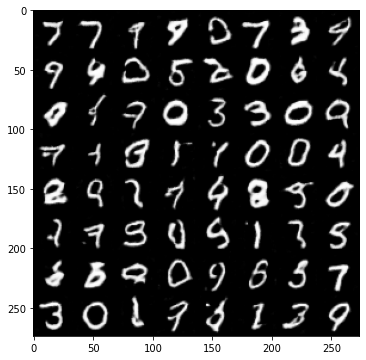

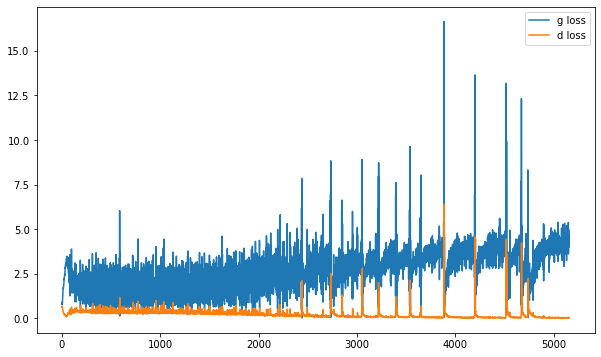

it: 5359; g_loss: 3.633723497390747; d_loss: 0.044136472046375275; avg_real_score: 0.9621279239654541; avg_fake_score: 0.042368754744529724: : 199it [00:12, 16.40it/s]

epoch 11 generated images


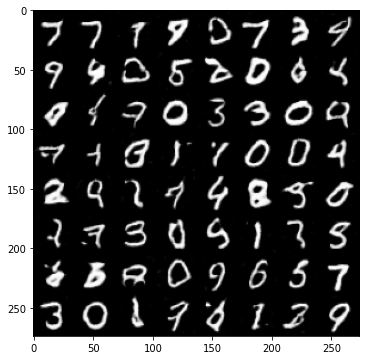

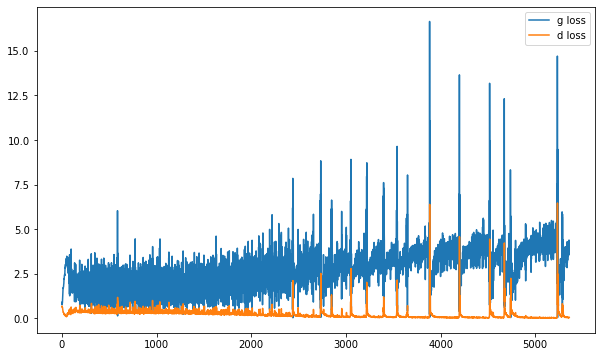

it: 5559; g_loss: 3.9758243560791016; d_loss: 0.022988207638263702; avg_real_score: 0.9716554880142212; avg_fake_score: 0.029493194073438644: : 399it [00:24, 15.53it/s]

epoch 11 generated images


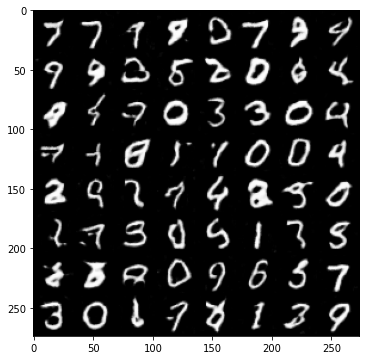

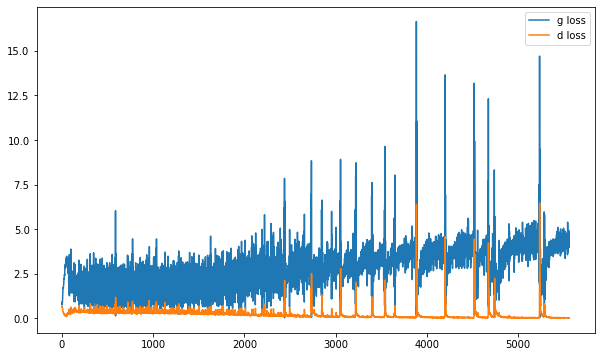

it: 5627; g_loss: 4.362120151519775; d_loss: 0.022752273827791214; avg_real_score: 0.9671761393547058; avg_fake_score: 0.023106930777430534: : 469it [00:29, 16.04it/s]
it: 5628; g_loss: 4.363973140716553; d_loss: 0.02581917494535446; avg_real_score: 0.9859572649002075; avg_fake_score: 0.01923389360308647: : 0it [00:00, ?it/s]

epoch 12 generated images


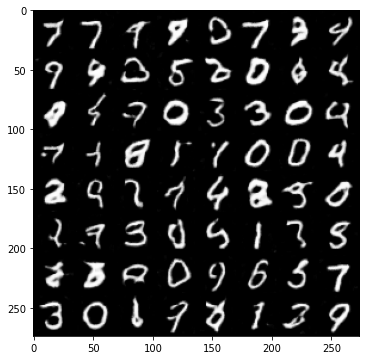

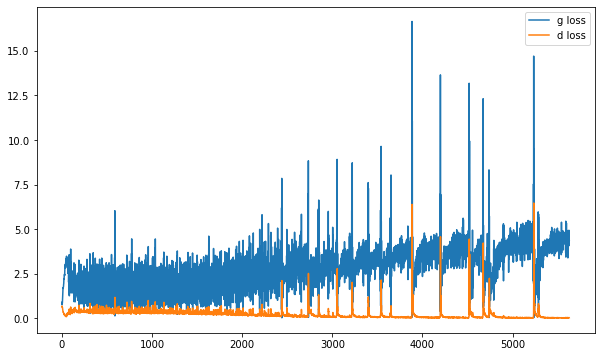

it: 5828; g_loss: 3.527409315109253; d_loss: 0.043284669518470764; avg_real_score: 0.9348845481872559; avg_fake_score: 0.04081752523779869: : 199it [00:12, 16.55it/s] 

epoch 12 generated images


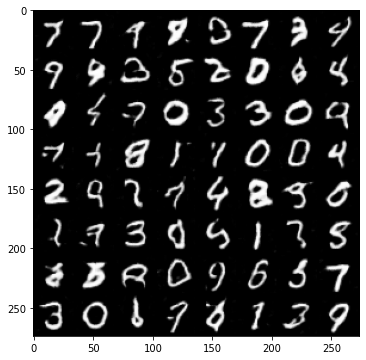

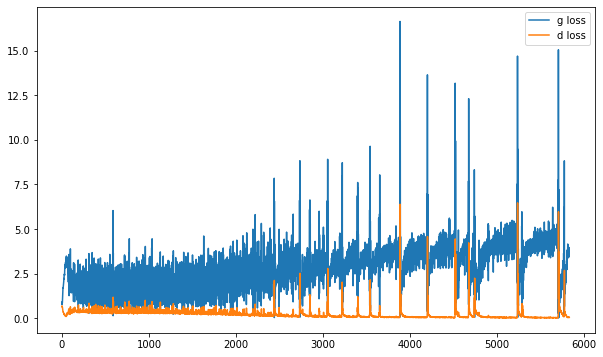

it: 6028; g_loss: 5.156999588012695; d_loss: 0.014634314924478531; avg_real_score: 0.9809377789497375; avg_fake_score: 0.010954196564853191: : 399it [00:24, 16.95it/s]

epoch 12 generated images


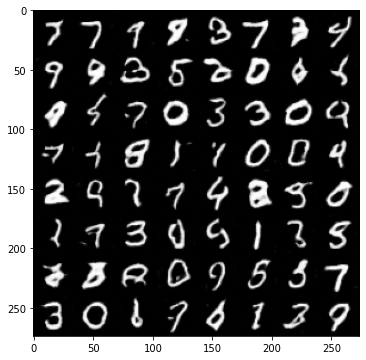

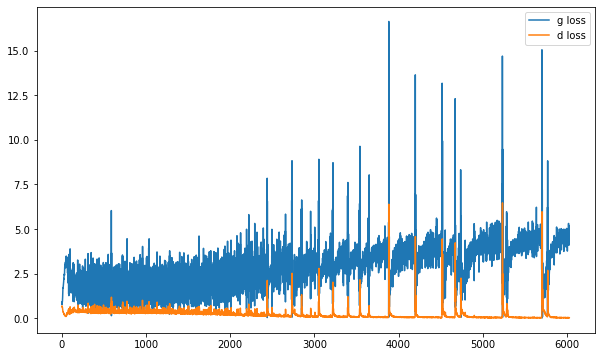

it: 6096; g_loss: 5.082148551940918; d_loss: 0.019256632775068283; avg_real_score: 0.9759580492973328; avg_fake_score: 0.01091014500707388: : 469it [00:28, 16.25it/s]
it: 6097; g_loss: 4.906299114227295; d_loss: 0.01454015914350748; avg_real_score: 0.9806381464004517; avg_fake_score: 0.012803081423044205: : 0it [00:00, ?it/s]

epoch 13 generated images


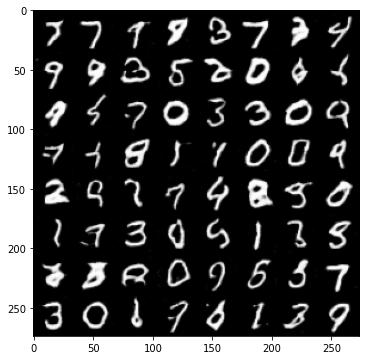

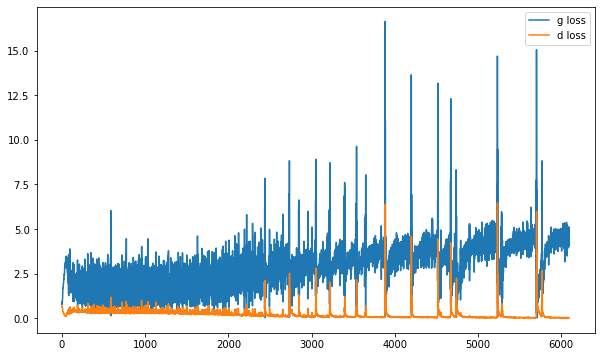

it: 6297; g_loss: 2.556565046310425; d_loss: 0.37036317586898804; avg_real_score: 0.8568086624145508; avg_fake_score: 0.10378637164831161: : 199it [00:12, 17.14it/s]

epoch 13 generated images


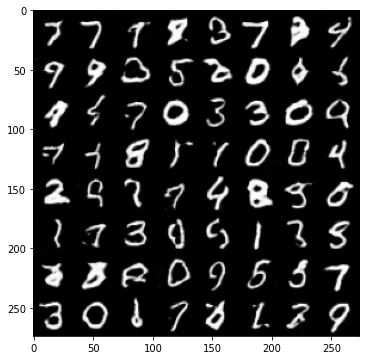

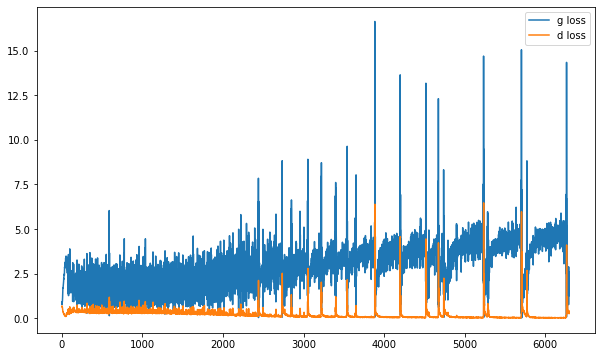

it: 6497; g_loss: 4.3492584228515625; d_loss: 0.019218076020479202; avg_real_score: 0.9725107550621033; avg_fake_score: 0.021380379796028137: : 399it [00:24, 16.75it/s]

epoch 13 generated images


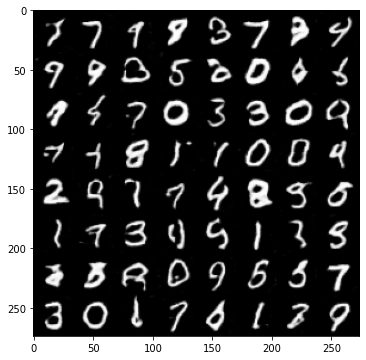

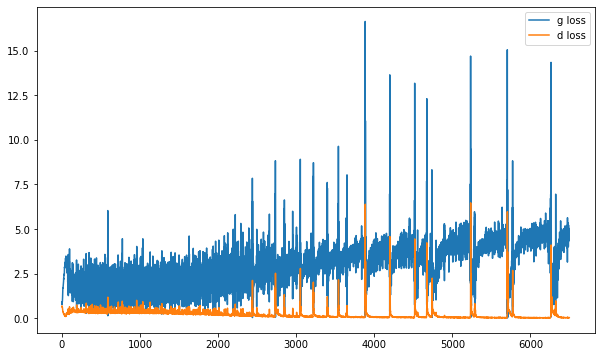

it: 6565; g_loss: 4.732297420501709; d_loss: 0.015420838259160519; avg_real_score: 0.9813364744186401; avg_fake_score: 0.016426827758550644: : 469it [00:28, 16.37it/s]
it: 6566; g_loss: 4.3946943283081055; d_loss: 0.017819073051214218; avg_real_score: 0.9772711992263794; avg_fake_score: 0.02016959711909294: : 0it [00:00, ?it/s]

epoch 14 generated images


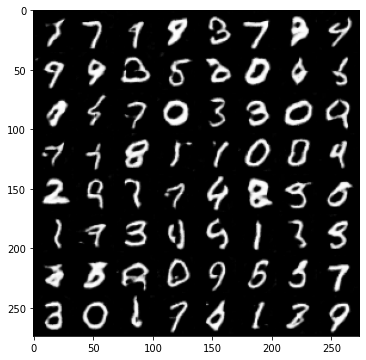

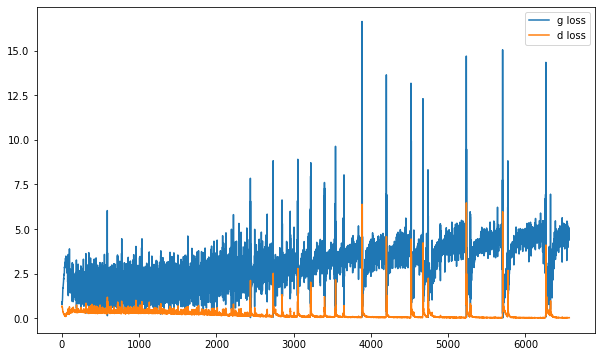

it: 6766; g_loss: 4.718040466308594; d_loss: 0.02460503950715065; avg_real_score: 0.9898247122764587; avg_fake_score: 0.016194432973861694: : 199it [00:12, 17.28it/s]

epoch 14 generated images


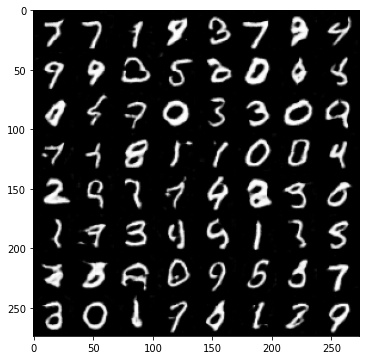

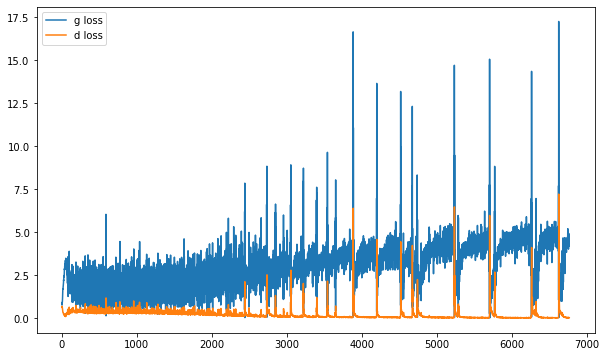

it: 6966; g_loss: 4.682211875915527; d_loss: 0.017629817128181458; avg_real_score: 0.9843785762786865; avg_fake_score: 0.017084863036870956: : 399it [00:24, 17.71it/s]

epoch 14 generated images


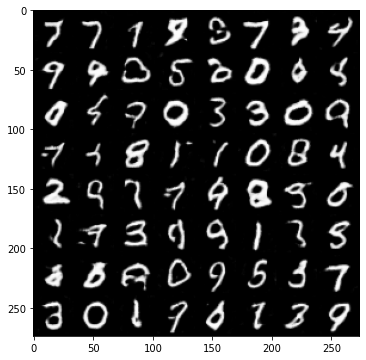

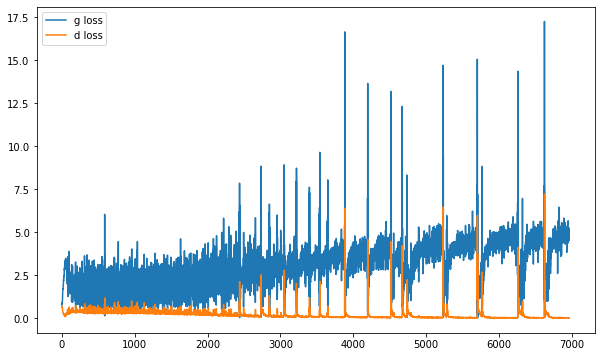

it: 7034; g_loss: 5.346192359924316; d_loss: 0.016684532165527344; avg_real_score: 0.9895572066307068; avg_fake_score: 0.008154413662850857: : 469it [00:28, 16.27it/s]


In [ ]:
nb_epochs = 15

g_losses = []
d_losses = []


nz = 100
ngf = 32
ndf = 32

nchannels= 1 
lr_d = 0.0002
lr_g = 0.0005
beta1= 0.5
display_freq = 200

netD = Discriminator(ndf, nchannels).to(device)
netG = Generator(nz, ngf).to(device)

# netD.apply(weights_init)
# netG.apply(weights_init)

g_opt = torch.optim.Adam(netG.parameters(), lr=lr_g, betas=(beta1, 0.999))
d_opt = torch.optim.Adam(netD.parameters(), lr=lr_d, betas=(beta1, 0.999))
j = 0


z_test = sample_z(64, nz) # we generate the noise only once for testing

for epoch in range(nb_epochs):
    
    # train
    pbar = tqdm(enumerate(dataloader))
    for i, batch in pbar:
        im, _ = batch # we don't care about the label for unconditional generation
        im = im.to(device)
        
        cur_batch_size = im.shape[0]  
        
        # 1. sample a z vector 
        z = sample_z(cur_batch_size, nz)
        
        # 2. Generate a fake image

        fake_im = netG(z)

        # 3. Classify real image with D
        
        real_logits = netD(im)


        # 4. Classify fake image with D
       
        fake_logits = netD(fake_im.detach())
         
        ###
        ### Discriminator
        ###
        d_loss = criterion(real_logits, get_labels_one(cur_batch_size).to(device))
        d_loss = (d_loss + criterion(fake_logits, get_labels_zero(cur_batch_size).to(device)))/2
        d_opt.zero_grad()
        d_loss.backward() # we need to retain graph=True to be able to calculate the gradient in the g backprop
        d_opt.step()

        
        ###
        ### Generator
        ###
        
        fake_logits = netD(fake_im)
        g_loss = criterion(fake_logits, get_labels_one(cur_batch_size).to(device)) 
        g_opt.zero_grad()
        g_loss.backward()
        g_opt.step()
        
                
        d_losses.append(d_loss.item())
        g_losses.append(g_loss.item())
        
        avg_real_score = torch.mean(real_logits).item()
        avg_fake_score = torch.mean(fake_logits).item()


        pbar.set_description(f"it: {j}; g_loss: {g_loss}; d_loss: {d_loss}; avg_real_score: {avg_real_score}; avg_fake_score: {avg_fake_score}")
        if i % display_freq == 0:

            fake_im = netG(z_test)
            
            un_norm = renorm(fake_im) # for visualization
            
            grid = torchvision.utils.make_grid(un_norm, nrow=8)
            pil_grid = to_pil(grid)  
            
            print("epoch", epoch, "generated images")
            plt.imshow(pil_grid)
            plt.show()
            
            plt.plot(range(len(g_losses)), g_losses, label='g loss')
            plt.plot(range(len(g_losses)), d_losses, label='d loss')
            
            plt.legend()
            plt.show()  
        j += 1

##Change learning **rate**

it: 0; g_loss: 9.31322685637781e-10; d_loss: 0.6940228939056396; avg_real_score: 0.42308712005615234; avg_fake_score: 1.0: : 0it [00:00, ?it/s]

epoch 0 generated images


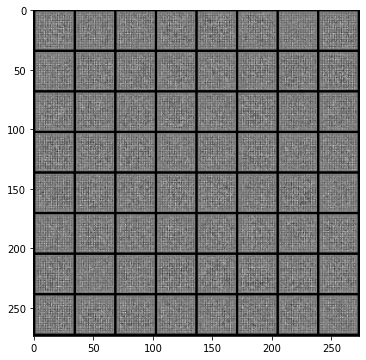

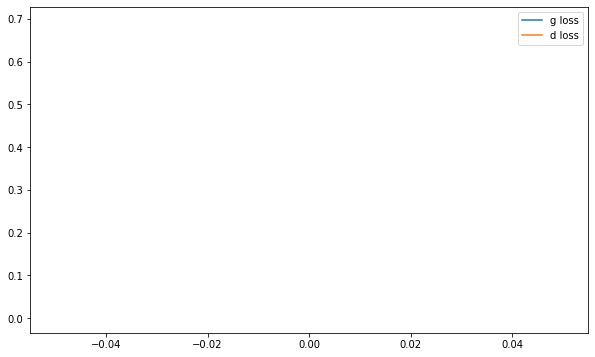

it: 200; g_loss: 0.0; d_loss: 50.0; avg_real_score: 1.0; avg_fake_score: 1.0: : 198it [00:10, 19.52it/s]

epoch 0 generated images


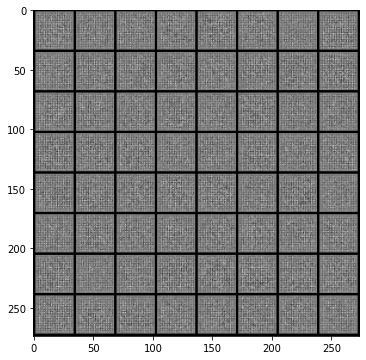

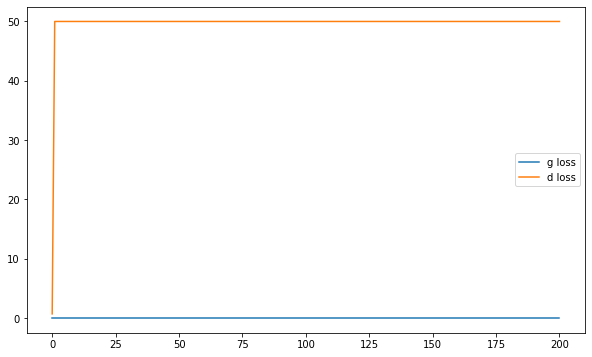

it: 400; g_loss: 96.94422912597656; d_loss: 50.5521240234375; avg_real_score: 0.9765625; avg_fake_score: 0.0234375: : 398it [00:21, 20.14it/s]

epoch 0 generated images


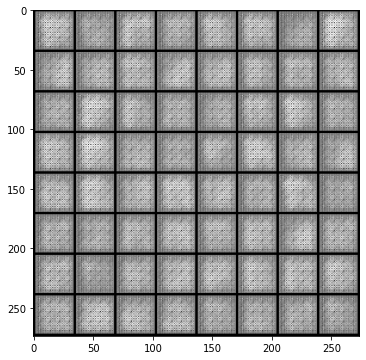

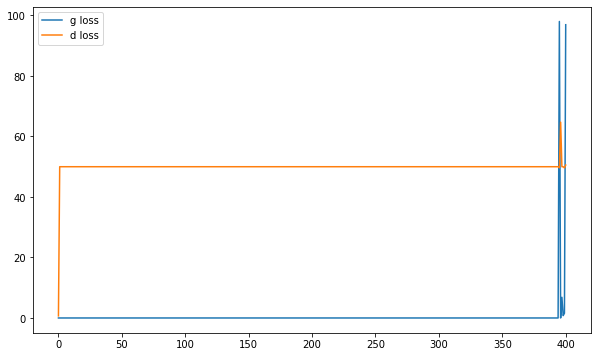

it: 468; g_loss: 100.0; d_loss: 50.0; avg_real_score: 0.0; avg_fake_score: 0.0: : 469it [00:25, 18.56it/s]
it: 469; g_loss: 100.0; d_loss: 50.0; avg_real_score: 0.0; avg_fake_score: 0.0: : 0it [00:00, ?it/s]

epoch 1 generated images


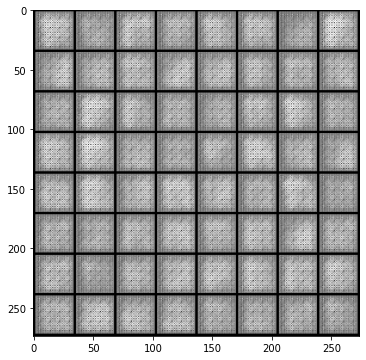

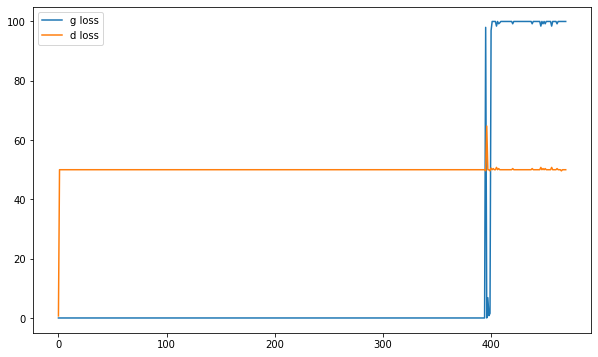

it: 669; g_loss: 100.0; d_loss: 50.0; avg_real_score: 0.0; avg_fake_score: 0.0: : 199it [00:10, 19.11it/s]

epoch 1 generated images


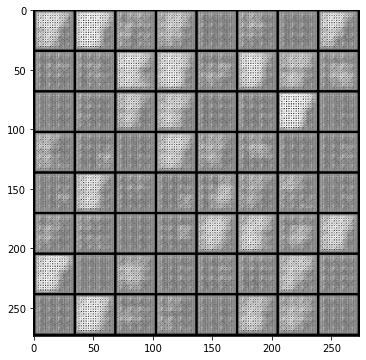

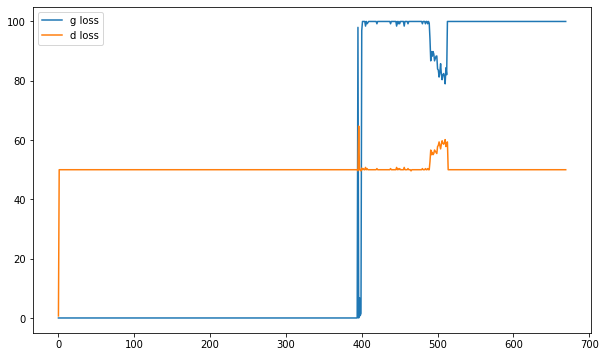

it: 869; g_loss: 100.0; d_loss: 50.0; avg_real_score: 0.0; avg_fake_score: 0.0: : 400it [00:21, 19.09it/s]

epoch 1 generated images


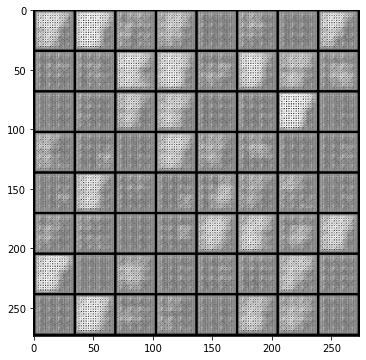

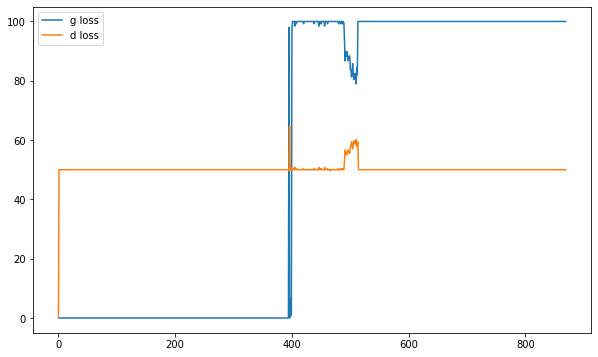

it: 937; g_loss: 100.0; d_loss: 50.0; avg_real_score: 0.0; avg_fake_score: 0.0: : 469it [00:25, 18.23it/s]
it: 938; g_loss: 100.0; d_loss: 50.0; avg_real_score: 0.0; avg_fake_score: 0.0: : 0it [00:00, ?it/s]

epoch 2 generated images


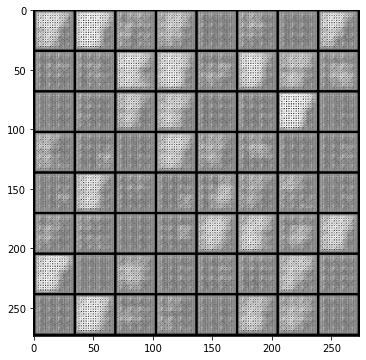

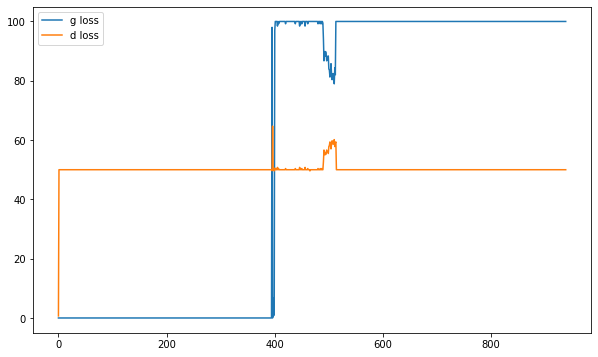

it: 1138; g_loss: 100.0; d_loss: 50.0; avg_real_score: 0.0; avg_fake_score: 0.0: : 199it [00:11, 19.27it/s]

epoch 2 generated images


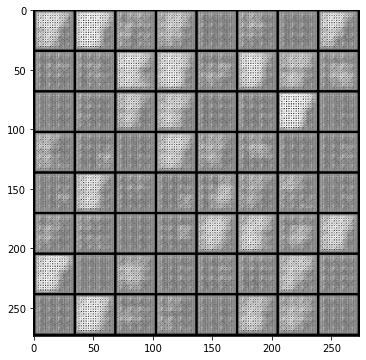

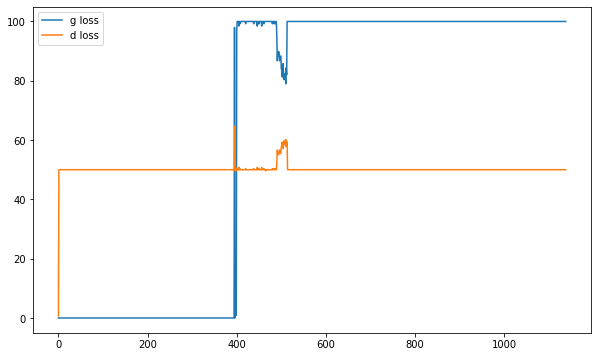

it: 1338; g_loss: 100.0; d_loss: 50.0; avg_real_score: 0.0; avg_fake_score: 0.0: : 399it [00:22, 18.65it/s]

epoch 2 generated images


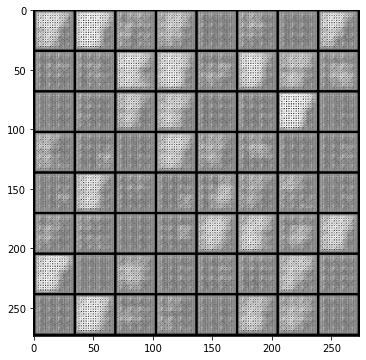

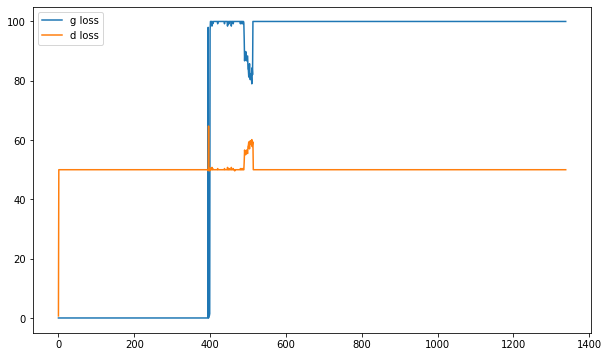

it: 1406; g_loss: 100.0; d_loss: 50.0; avg_real_score: 0.0; avg_fake_score: 0.0: : 469it [00:26, 17.60it/s]
it: 1407; g_loss: 100.0; d_loss: 50.0; avg_real_score: 0.0; avg_fake_score: 0.0: : 0it [00:00, ?it/s]

epoch 3 generated images


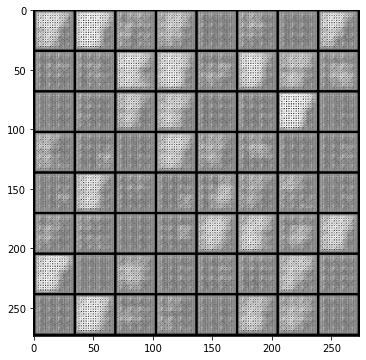

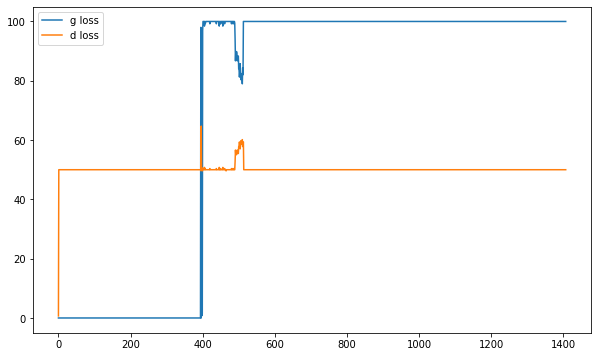

it: 1607; g_loss: 100.0; d_loss: 50.0; avg_real_score: 0.0; avg_fake_score: 0.0: : 199it [00:11, 17.44it/s]

epoch 3 generated images


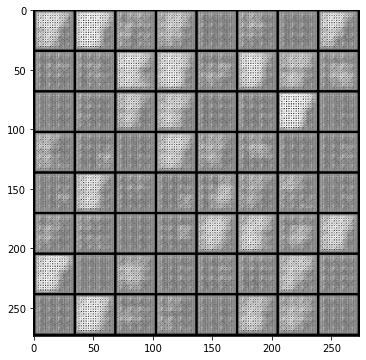

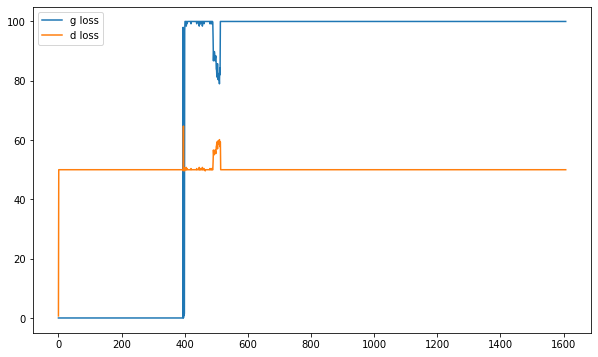

it: 1807; g_loss: 100.0; d_loss: 50.0; avg_real_score: 0.0; avg_fake_score: 0.0: : 399it [00:23, 17.27it/s]

epoch 3 generated images


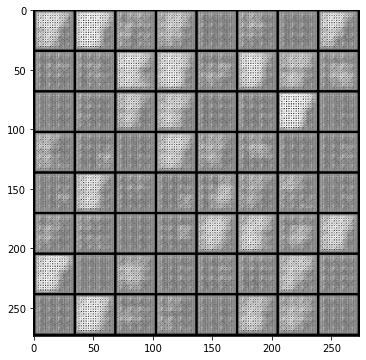

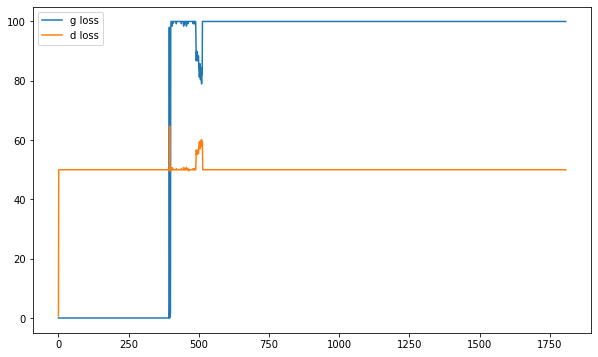

it: 1875; g_loss: 100.0; d_loss: 50.0; avg_real_score: 0.0; avg_fake_score: 0.0: : 469it [00:28, 16.65it/s]
it: 1876; g_loss: 100.0; d_loss: 50.0; avg_real_score: 0.0; avg_fake_score: 0.0: : 0it [00:00, ?it/s]

epoch 4 generated images


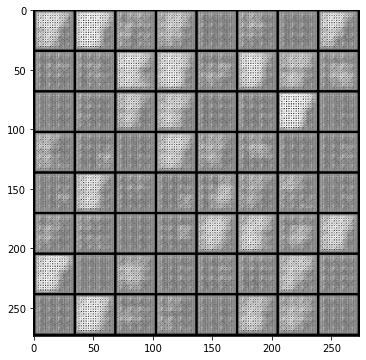

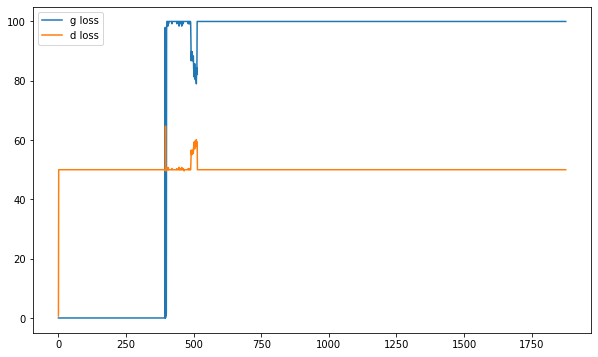

it: 2076; g_loss: 100.0; d_loss: 50.0; avg_real_score: 0.0; avg_fake_score: 0.0: : 199it [00:12, 16.97it/s]

epoch 4 generated images


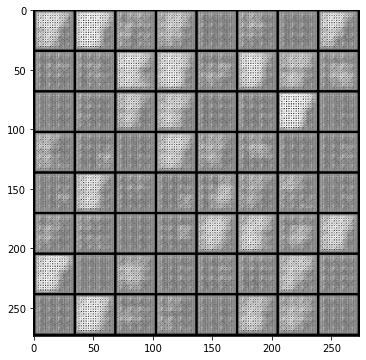

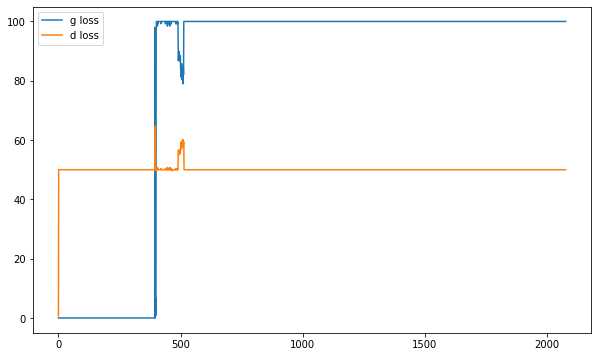

it: 2276; g_loss: 100.0; d_loss: 50.0; avg_real_score: 0.0; avg_fake_score: 0.0: : 399it [00:24, 17.42it/s]

epoch 4 generated images


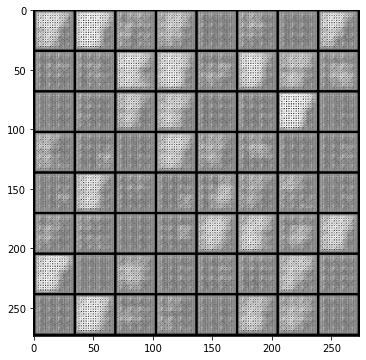

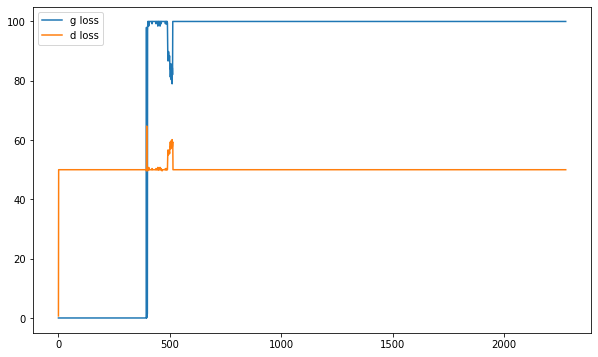

it: 2344; g_loss: 100.0; d_loss: 50.0; avg_real_score: 0.0; avg_fake_score: 0.0: : 469it [00:28, 16.33it/s]
it: 2345; g_loss: 100.0; d_loss: 50.0; avg_real_score: 0.0; avg_fake_score: 0.0: : 0it [00:00, ?it/s]

epoch 5 generated images


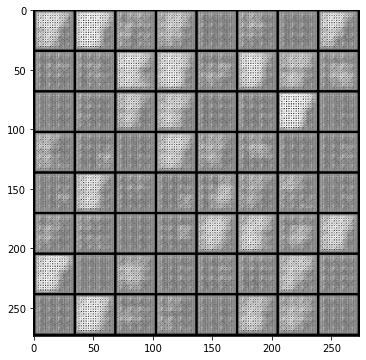

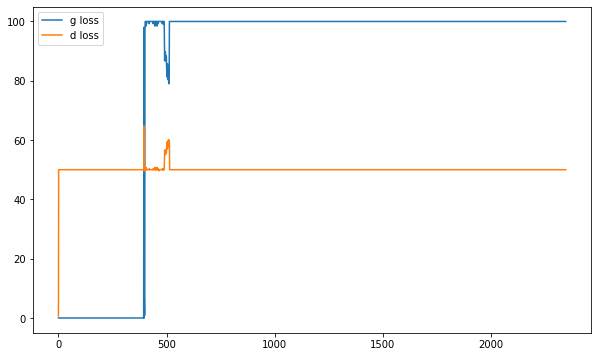

it: 2545; g_loss: 100.0; d_loss: 50.0; avg_real_score: 0.0; avg_fake_score: 0.0: : 199it [00:12, 17.38it/s]

epoch 5 generated images


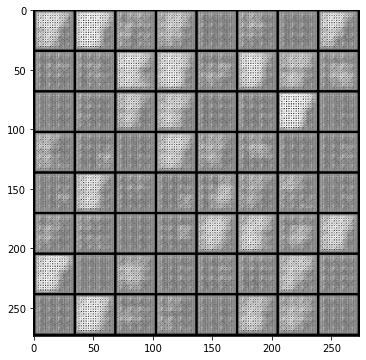

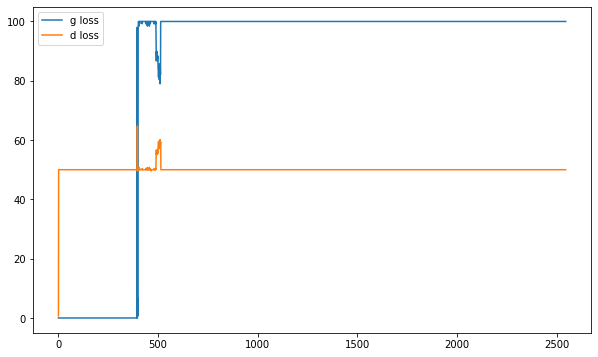

it: 2745; g_loss: 100.0; d_loss: 50.0; avg_real_score: 0.0; avg_fake_score: 0.0: : 399it [00:24, 16.95it/s]

epoch 5 generated images


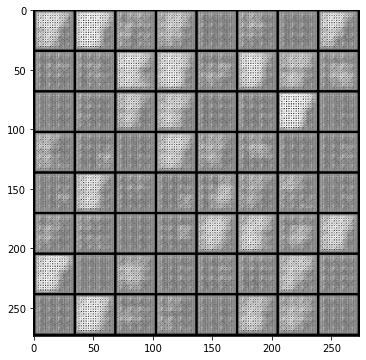

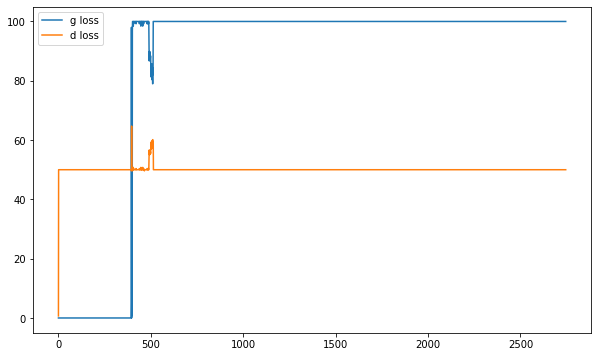

it: 2813; g_loss: 100.0; d_loss: 50.0; avg_real_score: 0.0; avg_fake_score: 0.0: : 469it [00:28, 16.17it/s]
it: 2814; g_loss: 100.0; d_loss: 50.0; avg_real_score: 0.0; avg_fake_score: 0.0: : 0it [00:00, ?it/s]

epoch 6 generated images


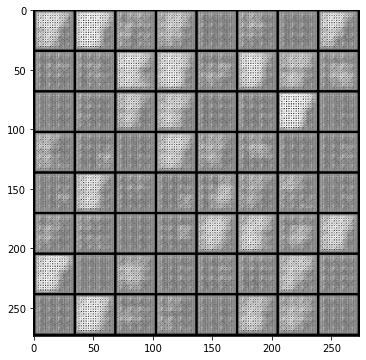

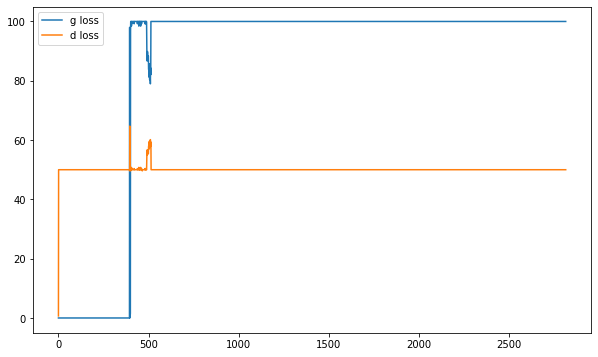

it: 3014; g_loss: 100.0; d_loss: 50.0; avg_real_score: 0.0; avg_fake_score: 0.0: : 199it [00:12, 17.36it/s]

epoch 6 generated images


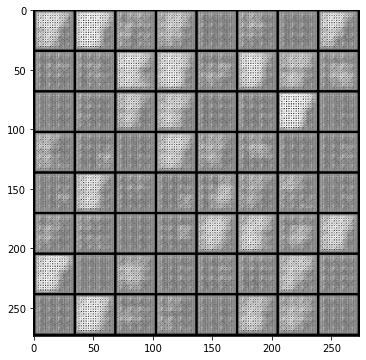

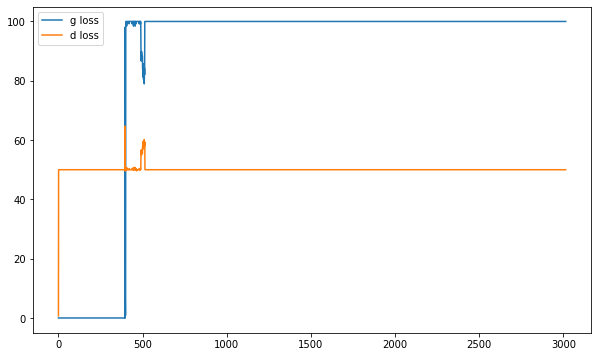

it: 3214; g_loss: 100.0; d_loss: 50.0; avg_real_score: 0.0; avg_fake_score: 0.0: : 399it [00:24, 17.03it/s]

epoch 6 generated images


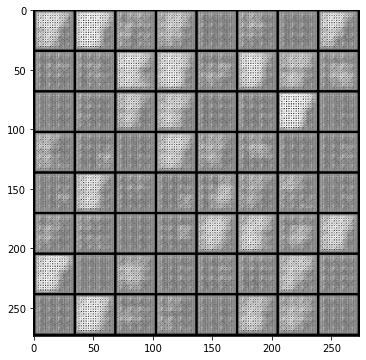

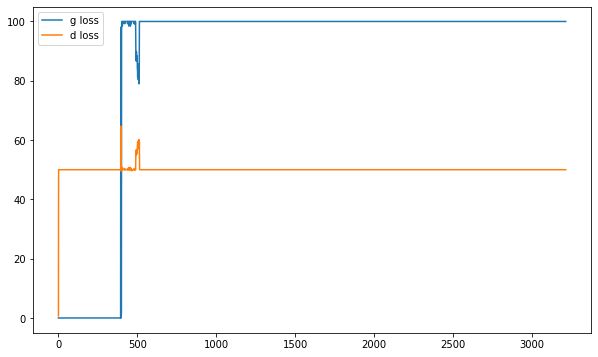

it: 3282; g_loss: 100.0; d_loss: 50.0; avg_real_score: 0.0; avg_fake_score: 0.0: : 469it [00:29, 16.13it/s]
it: 3283; g_loss: 100.0; d_loss: 50.0; avg_real_score: 0.0; avg_fake_score: 0.0: : 0it [00:00, ?it/s]

epoch 7 generated images


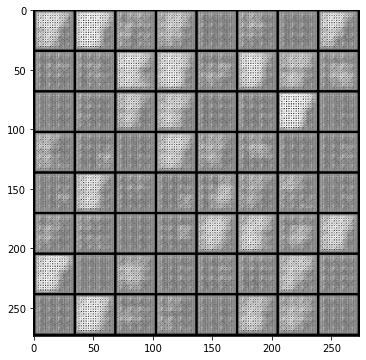

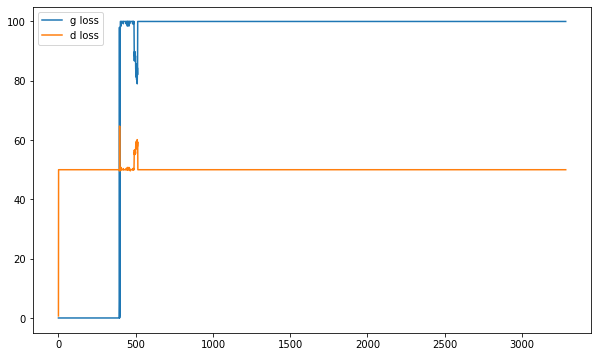

it: 3483; g_loss: 100.0; d_loss: 50.0; avg_real_score: 0.0; avg_fake_score: 0.0: : 199it [00:12, 17.20it/s]

epoch 7 generated images


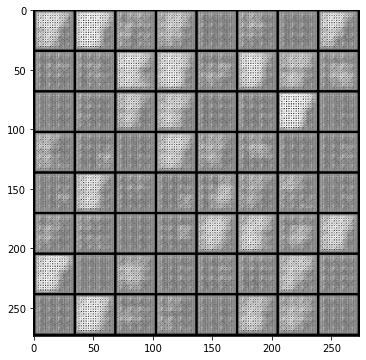

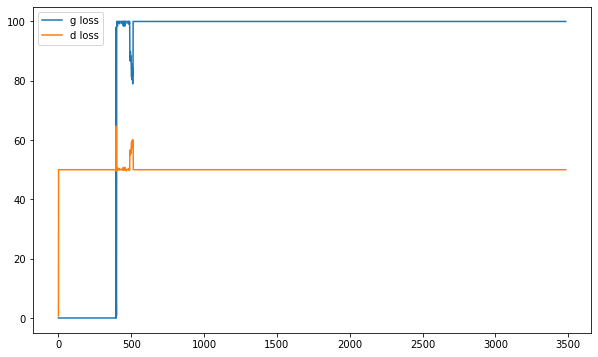

it: 3683; g_loss: 100.0; d_loss: 50.0; avg_real_score: 0.0; avg_fake_score: 0.0: : 399it [00:24, 17.72it/s]

epoch 7 generated images


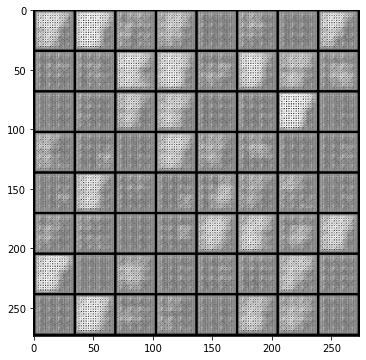

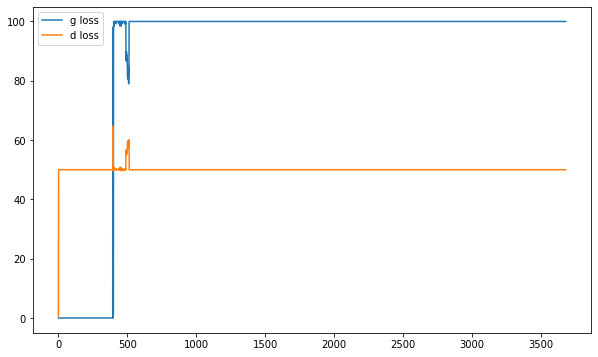

it: 3751; g_loss: 100.0; d_loss: 50.0; avg_real_score: 0.0; avg_fake_score: 0.0: : 469it [00:29, 16.16it/s]
it: 3752; g_loss: 100.0; d_loss: 50.0; avg_real_score: 0.0; avg_fake_score: 0.0: : 0it [00:00, ?it/s]

epoch 8 generated images


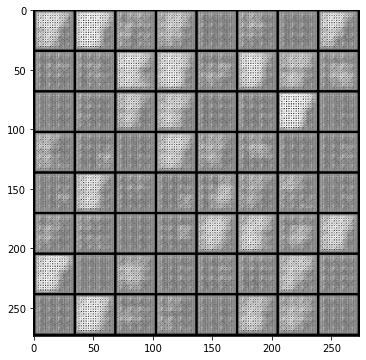

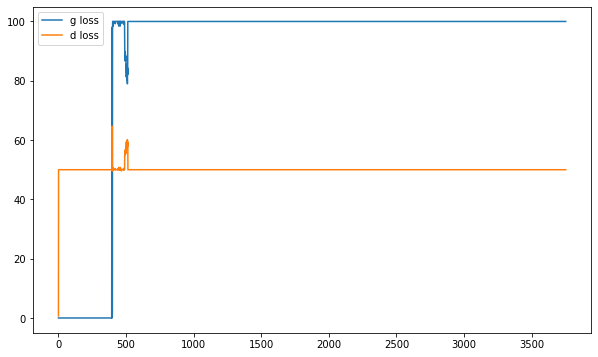

it: 3952; g_loss: 100.0; d_loss: 50.0; avg_real_score: 0.0; avg_fake_score: 0.0: : 199it [00:12, 17.74it/s]

epoch 8 generated images


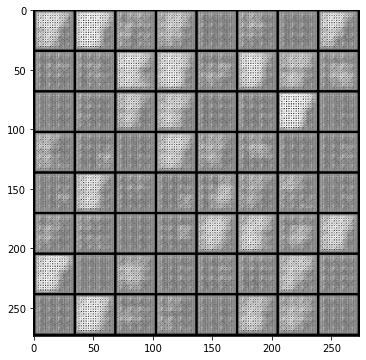

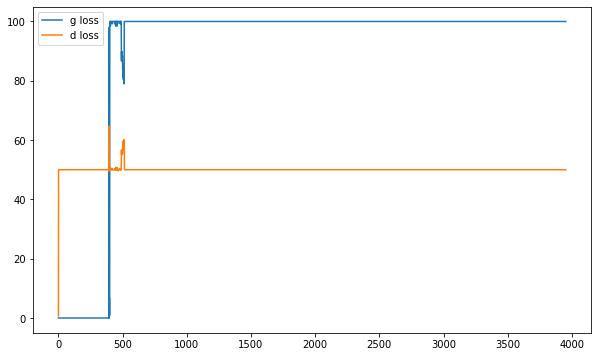

it: 4152; g_loss: 100.0; d_loss: 50.0; avg_real_score: 0.0; avg_fake_score: 0.0: : 399it [00:24, 17.08it/s]

epoch 8 generated images


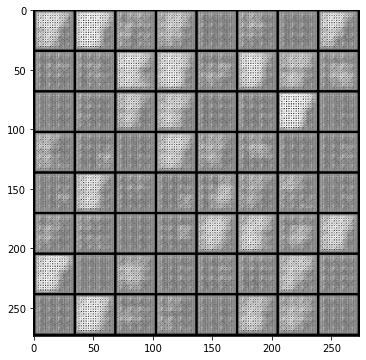

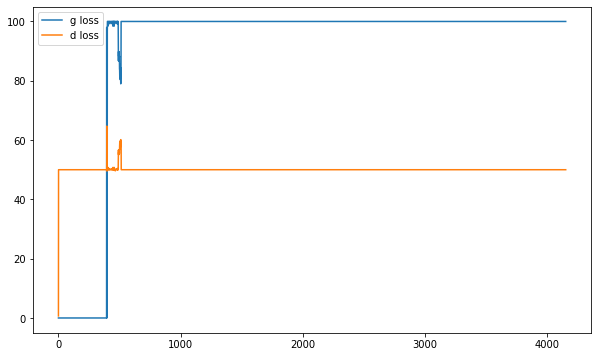

it: 4220; g_loss: 100.0; d_loss: 50.0; avg_real_score: 0.0; avg_fake_score: 0.0: : 469it [00:28, 16.26it/s]
it: 4221; g_loss: 100.0; d_loss: 50.0; avg_real_score: 0.0; avg_fake_score: 0.0: : 0it [00:00, ?it/s]

epoch 9 generated images


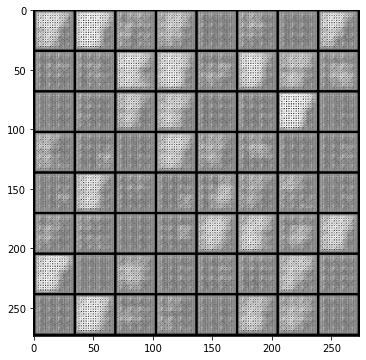

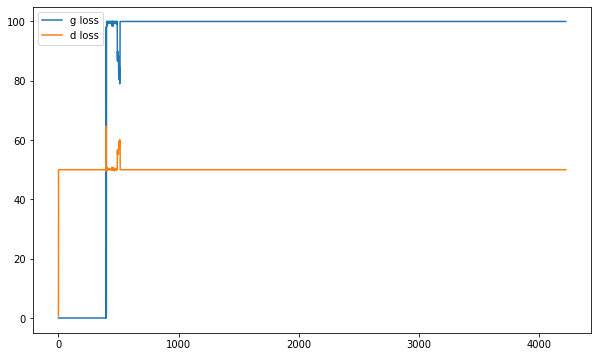

it: 4421; g_loss: 100.0; d_loss: 50.0; avg_real_score: 0.0; avg_fake_score: 0.0: : 199it [00:12, 16.90it/s]

epoch 9 generated images


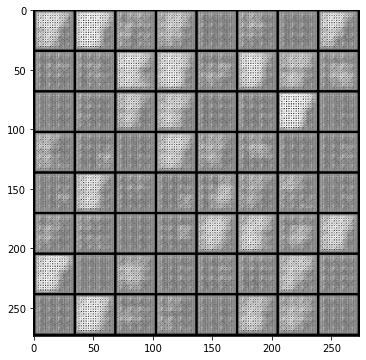

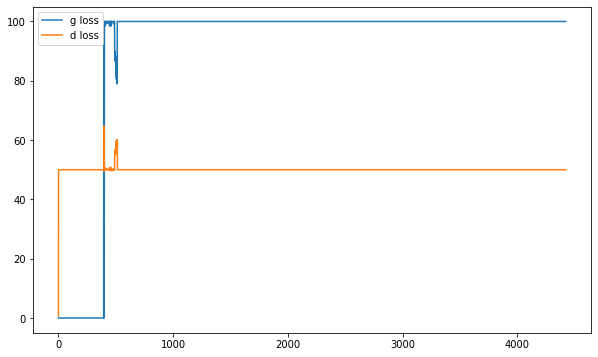

it: 4621; g_loss: 100.0; d_loss: 50.0; avg_real_score: 0.0; avg_fake_score: 0.0: : 399it [00:24, 16.80it/s]

epoch 9 generated images


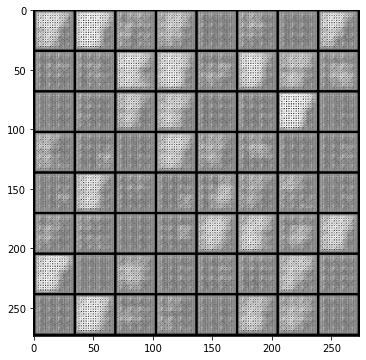

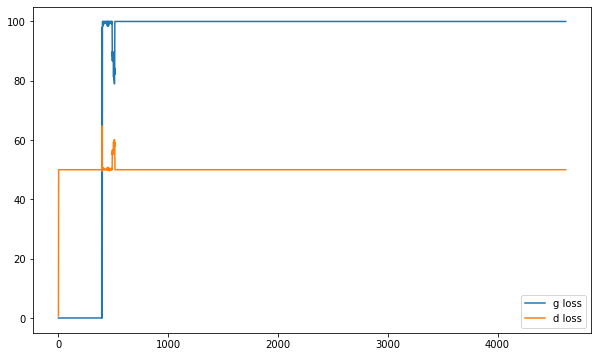

it: 4689; g_loss: 100.0; d_loss: 50.0; avg_real_score: 0.0; avg_fake_score: 0.0: : 469it [00:29, 16.09it/s]
it: 4690; g_loss: 100.0; d_loss: 50.0; avg_real_score: 0.0; avg_fake_score: 0.0: : 0it [00:00, ?it/s]

epoch 10 generated images


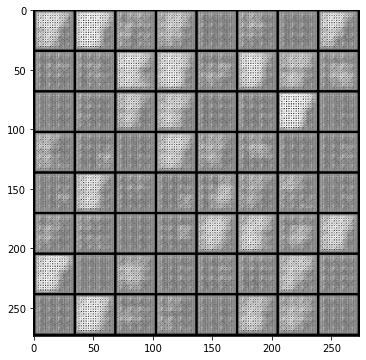

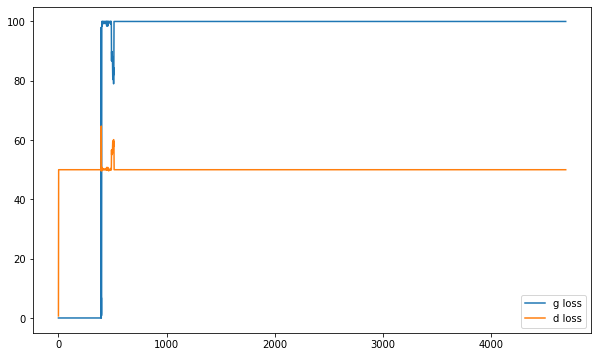

it: 4890; g_loss: 100.0; d_loss: 50.0; avg_real_score: 0.0; avg_fake_score: 0.0: : 199it [00:12, 17.74it/s]

epoch 10 generated images


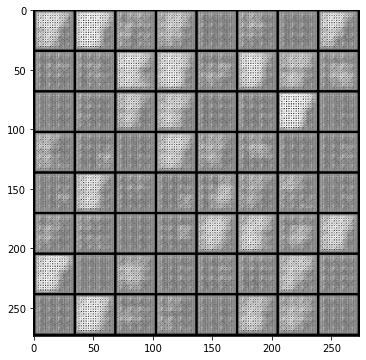

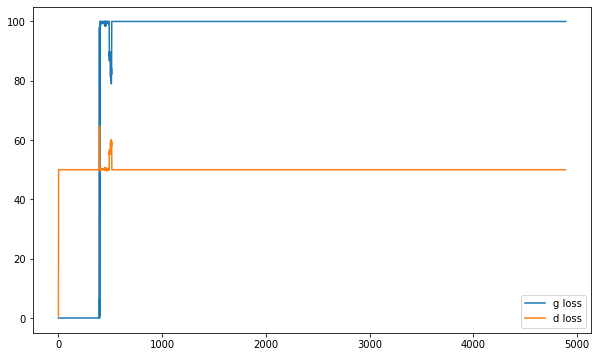

it: 5090; g_loss: 100.0; d_loss: 50.0; avg_real_score: 0.0; avg_fake_score: 0.0: : 399it [00:24, 17.73it/s]

epoch 10 generated images


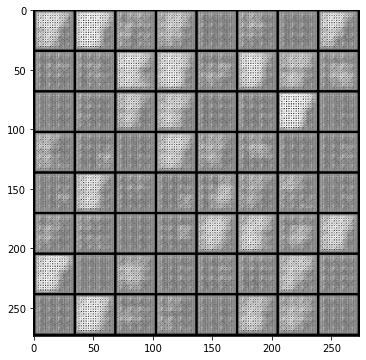

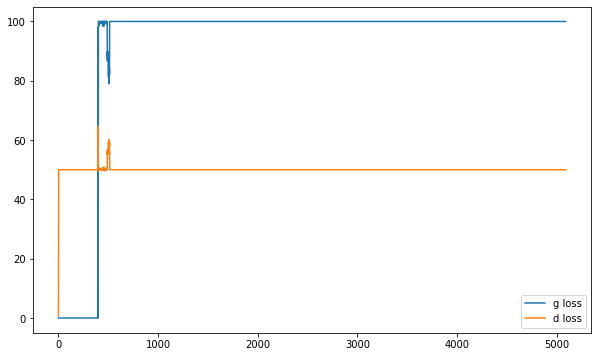

it: 5158; g_loss: 100.0; d_loss: 50.0; avg_real_score: 0.0; avg_fake_score: 0.0: : 469it [00:28, 16.26it/s]
it: 5159; g_loss: 100.0; d_loss: 50.0; avg_real_score: 0.0; avg_fake_score: 0.0: : 0it [00:00, ?it/s]

epoch 11 generated images


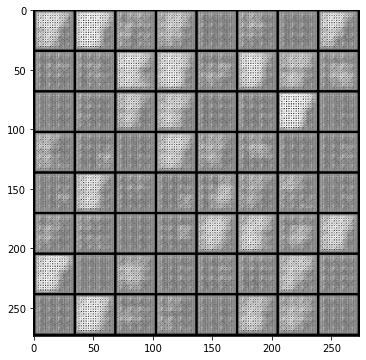

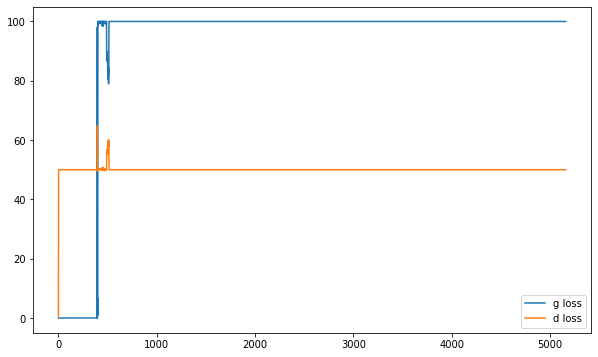

it: 5359; g_loss: 100.0; d_loss: 50.0; avg_real_score: 0.0; avg_fake_score: 0.0: : 199it [00:11, 17.06it/s]

epoch 11 generated images


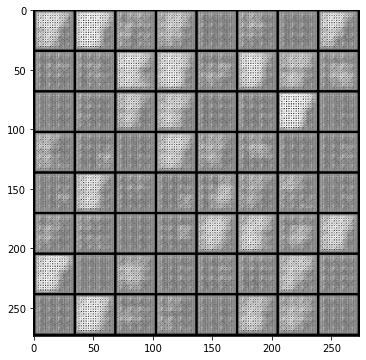

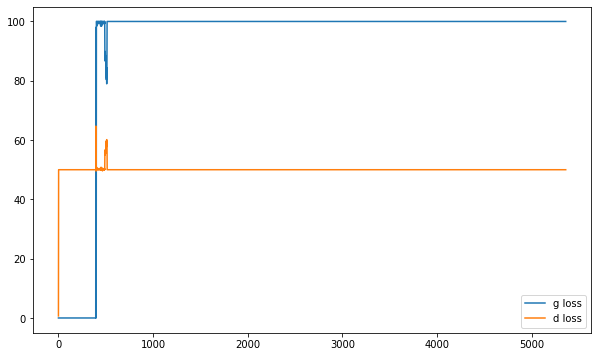

it: 5559; g_loss: 100.0; d_loss: 50.0; avg_real_score: 0.0; avg_fake_score: 0.0: : 399it [00:24, 16.79it/s]

epoch 11 generated images


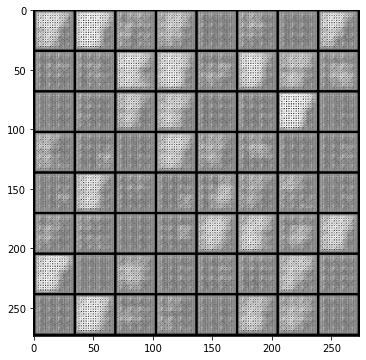

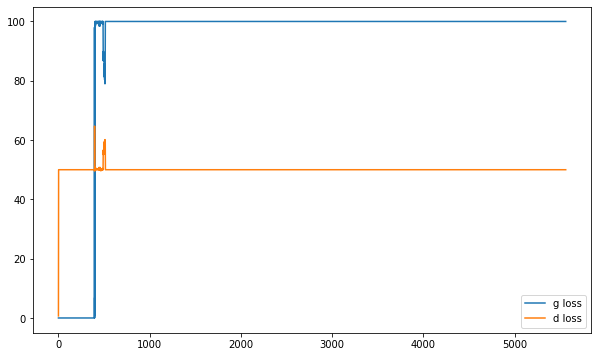

it: 5627; g_loss: 100.0; d_loss: 50.0; avg_real_score: 0.0; avg_fake_score: 0.0: : 469it [00:28, 16.40it/s]
it: 5628; g_loss: 100.0; d_loss: 50.0; avg_real_score: 0.0; avg_fake_score: 0.0: : 0it [00:00, ?it/s]

epoch 12 generated images


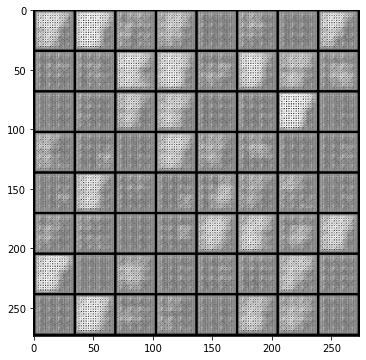

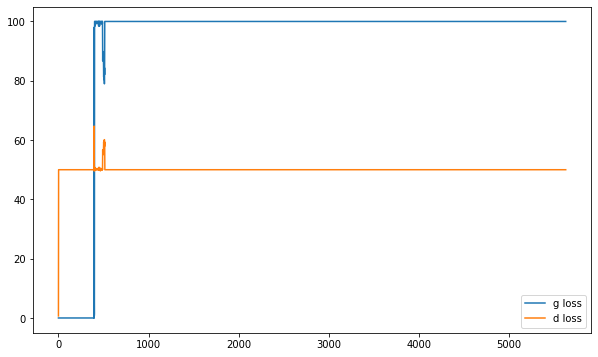

it: 5828; g_loss: 100.0; d_loss: 50.0; avg_real_score: 0.0; avg_fake_score: 0.0: : 199it [00:11, 17.99it/s]

epoch 12 generated images


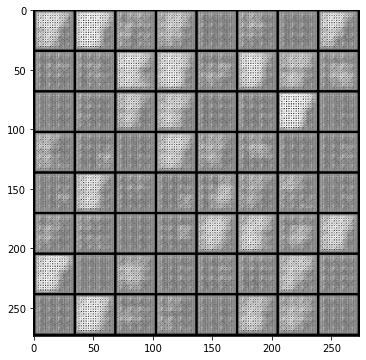

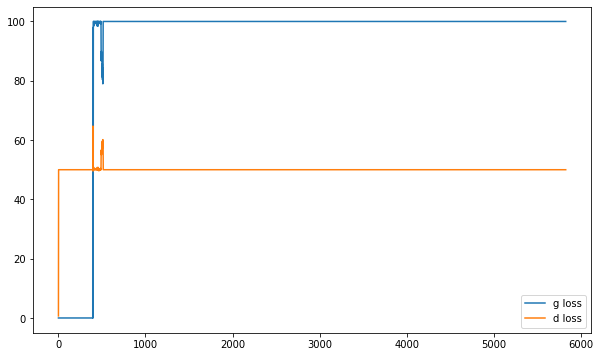

it: 6028; g_loss: 100.0; d_loss: 50.0; avg_real_score: 0.0; avg_fake_score: 0.0: : 399it [00:23, 17.94it/s]

epoch 12 generated images


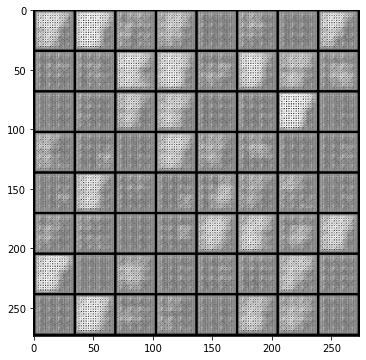

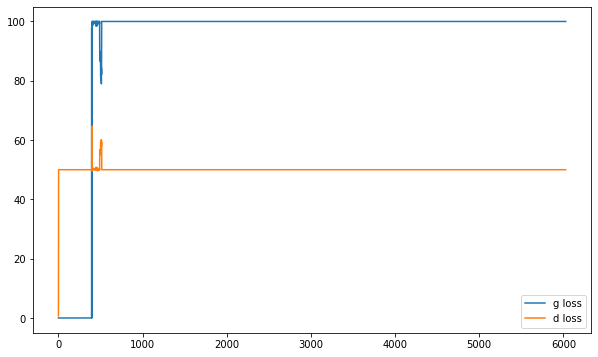

it: 6096; g_loss: 100.0; d_loss: 50.0; avg_real_score: 0.0; avg_fake_score: 0.0: : 469it [00:28, 16.48it/s]
it: 6097; g_loss: 100.0; d_loss: 50.0; avg_real_score: 0.0; avg_fake_score: 0.0: : 0it [00:00, ?it/s]

epoch 13 generated images


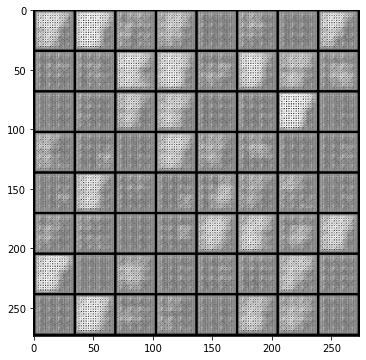

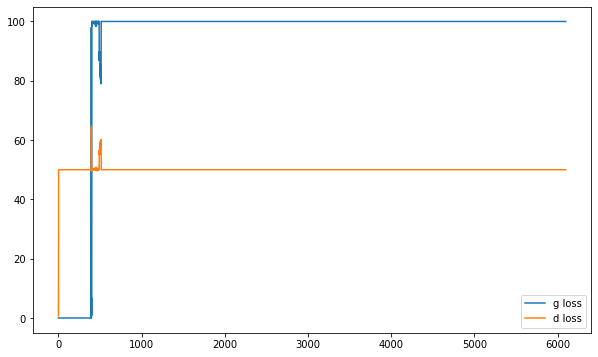

it: 6297; g_loss: 100.0; d_loss: 50.0; avg_real_score: 0.0; avg_fake_score: 0.0: : 199it [00:12, 17.16it/s]

epoch 13 generated images


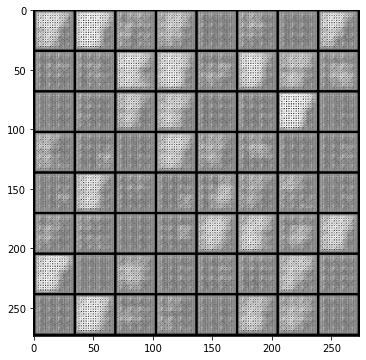

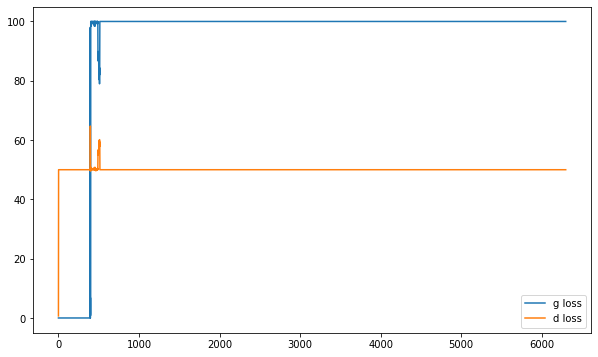

it: 6497; g_loss: 100.0; d_loss: 50.0; avg_real_score: 0.0; avg_fake_score: 0.0: : 399it [00:24, 17.88it/s]

epoch 13 generated images


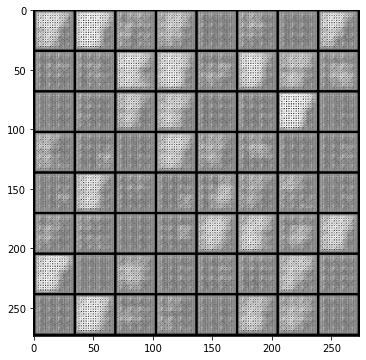

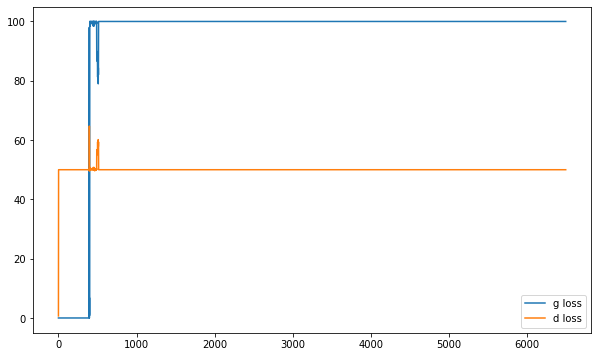

it: 6565; g_loss: 100.0; d_loss: 50.0; avg_real_score: 0.0; avg_fake_score: 0.0: : 469it [00:28, 16.40it/s]
it: 6566; g_loss: 100.0; d_loss: 50.0; avg_real_score: 0.0; avg_fake_score: 0.0: : 0it [00:00, ?it/s]

epoch 14 generated images


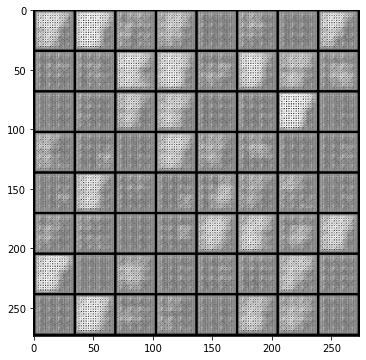

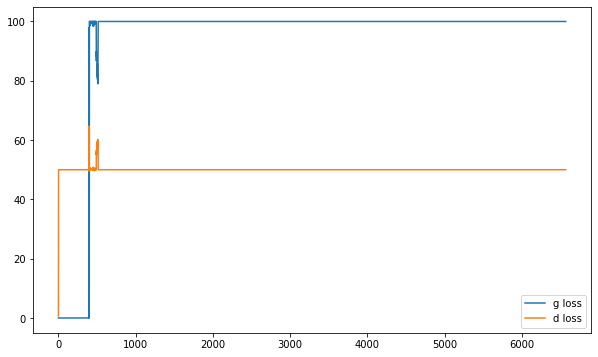

it: 6766; g_loss: 100.0; d_loss: 50.0; avg_real_score: 0.0; avg_fake_score: 0.0: : 199it [00:12, 17.30it/s]

epoch 14 generated images


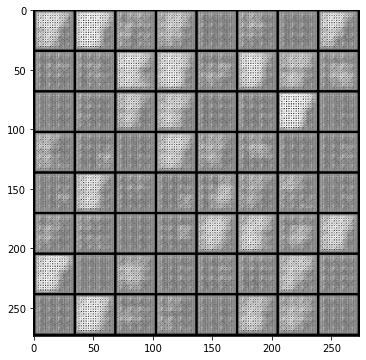

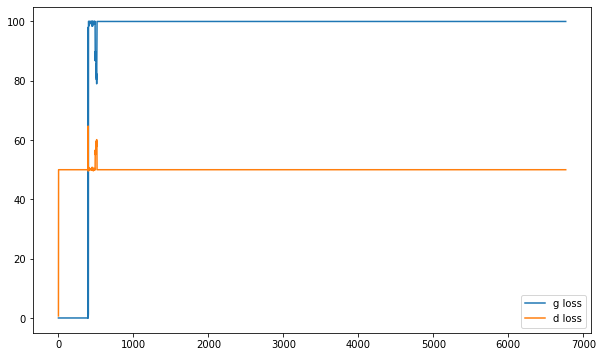

it: 6966; g_loss: 100.0; d_loss: 50.0; avg_real_score: 0.0; avg_fake_score: 0.0: : 399it [00:24, 17.07it/s]

epoch 14 generated images


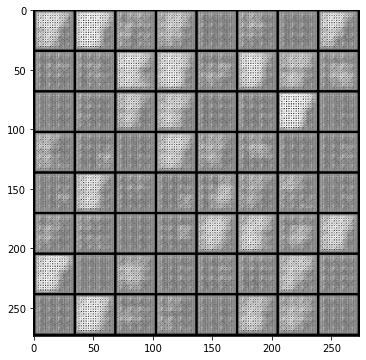

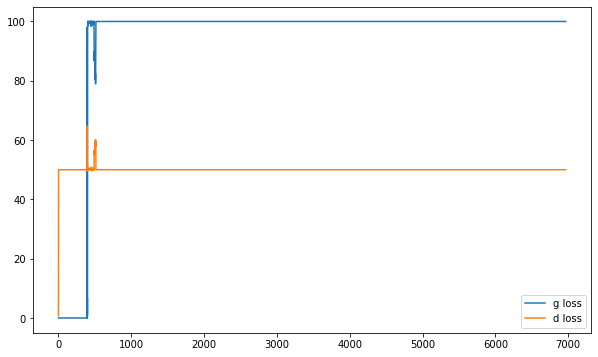

it: 7034; g_loss: 100.0; d_loss: 50.0; avg_real_score: 0.0; avg_fake_score: 0.0: : 469it [00:28, 16.41it/s]


In [ ]:
nb_epochs = 15

g_losses = []
d_losses = []


nz = 100
ngf = 32
ndf = 32

nchannels= 1 
lr_d = 0.2
lr_g = 0.0005
beta1= 0.5
display_freq = 200

netD = Discriminator(ndf, nchannels).to(device)
netG = Generator(nz, ngf).to(device)

netD.apply(weights_init)
netG.apply(weights_init)

g_opt = torch.optim.Adam(netG.parameters(), lr=lr_g, betas=(beta1, 0.999))
d_opt = torch.optim.Adam(netD.parameters(), lr=lr_d, betas=(beta1, 0.999))
j = 0


z_test = sample_z(64, nz) # we generate the noise only once for testing

for epoch in range(nb_epochs):
    
    # train
    pbar = tqdm(enumerate(dataloader))
    for i, batch in pbar:
        im, _ = batch # we don't care about the label for unconditional generation
        im = im.to(device)
        
        cur_batch_size = im.shape[0]  
        
        # 1. sample a z vector 
        z = sample_z(cur_batch_size, nz)
        
        # 2. Generate a fake image

        fake_im = netG(z)

        # 3. Classify real image with D
        
        real_logits = netD(im)


        # 4. Classify fake image with D
       
        fake_logits = netD(fake_im.detach())
         
        ###
        ### Discriminator
        ###
        d_loss = criterion(real_logits, get_labels_one(cur_batch_size).to(device))
        d_loss = (d_loss + criterion(fake_logits, get_labels_zero(cur_batch_size).to(device)))/2
        d_opt.zero_grad()
        d_loss.backward() # we need to retain graph=True to be able to calculate the gradient in the g backprop
        d_opt.step()

        
        ###
        ### Generator
        ###
        
        fake_logits = netD(fake_im)
        g_loss = criterion(fake_logits, get_labels_one(cur_batch_size).to(device)) 
        g_opt.zero_grad()
        g_loss.backward()
        g_opt.step()
        
                
        d_losses.append(d_loss.item())
        g_losses.append(g_loss.item())
        
        avg_real_score = torch.mean(real_logits).item()
        avg_fake_score = torch.mean(fake_logits).item()


        pbar.set_description(f"it: {j}; g_loss: {g_loss}; d_loss: {d_loss}; avg_real_score: {avg_real_score}; avg_fake_score: {avg_fake_score}")
        if i % display_freq == 0:

            fake_im = netG(z_test)
            
            un_norm = renorm(fake_im) # for visualization
            
            grid = torchvision.utils.make_grid(un_norm, nrow=8)
            pil_grid = to_pil(grid)  
            
            print("epoch", epoch, "generated images")
            plt.imshow(pil_grid)
            plt.show()
            
            plt.plot(range(len(g_losses)), g_losses, label='g loss')
            plt.plot(range(len(g_losses)), d_losses, label='d loss')
            
            plt.legend()
            plt.show()  
        j += 1

In [ ]:
nb_epochs = 15

g_losses = []
d_losses = []


nz = 100
ngf = 32
ndf = 32

nchannels= 1 
lr_d = 0.0002
lr_g = 0.5
beta1= 0.5
display_freq = 200

netD = Discriminator(ndf, nchannels).to(device)
netG = Generator(nz, ngf).to(device)

netD.apply(weights_init)
netG.apply(weights_init)

g_opt = torch.optim.Adam(netG.parameters(), lr=lr_g, betas=(beta1, 0.999))
d_opt = torch.optim.Adam(netD.parameters(), lr=lr_d, betas=(beta1, 0.999))
j = 0


z_test = sample_z(64, nz) # we generate the noise only once for testing

for epoch in range(nb_epochs):
    
    # train
    pbar = tqdm(enumerate(dataloader))
    for i, batch in pbar:
        im, _ = batch # we don't care about the label for unconditional generation
        im = im.to(device)
        
        cur_batch_size = im.shape[0]  
        
        # 1. sample a z vector 
        z = sample_z(cur_batch_size, nz)
        
        # 2. Generate a fake image

        fake_im = netG(z)

        # 3. Classify real image with D
        
        real_logits = netD(im)


        # 4. Classify fake image with D
       
        fake_logits = netD(fake_im.detach())
         
        ###
        ### Discriminator
        ###
        d_loss = criterion(real_logits, get_labels_one(cur_batch_size).to(device))
        d_loss = (d_loss + criterion(fake_logits, get_labels_zero(cur_batch_size).to(device)))/2
        d_opt.zero_grad()
        d_loss.backward() # we need to retain graph=True to be able to calculate the gradient in the g backprop
        d_opt.step()

        
        ###
        ### Generator
        ###
        
        fake_logits = netD(fake_im)
        g_loss = criterion(fake_logits, get_labels_one(cur_batch_size).to(device)) 
        g_opt.zero_grad()
        g_loss.backward()
        g_opt.step()
        
                
        d_losses.append(d_loss.item())
        g_losses.append(g_loss.item())
        
        avg_real_score = torch.mean(real_logits).item()
        avg_fake_score = torch.mean(fake_logits).item()


        pbar.set_description(f"it: {j}; g_loss: {g_loss}; d_loss: {d_loss}; avg_real_score: {avg_real_score}; avg_fake_score: {avg_fake_score}")
        if i % display_freq == 0:

            fake_im = netG(z_test)
            
            un_norm = renorm(fake_im) # for visualization
            
            grid = torchvision.utils.make_grid(un_norm, nrow=8)
            pil_grid = to_pil(grid)  
            
            print("epoch", epoch, "generated images")
            plt.imshow(pil_grid)
            plt.show()
            
            plt.plot(range(len(g_losses)), g_losses, label='g loss')
            plt.plot(range(len(g_losses)), d_losses, label='d loss')
            
            plt.legend()
            plt.show()  
        j += 1

## nz = 1000

it: 0; g_loss: 0.8978123664855957; d_loss: 0.7609984278678894; avg_real_score: 0.565537691116333; avg_fake_score: 0.4270501136779785: : 0it [00:00, ?it/s]

epoch 0 generated images


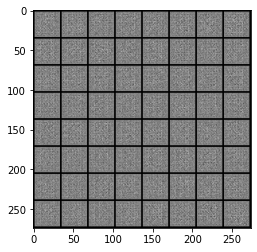

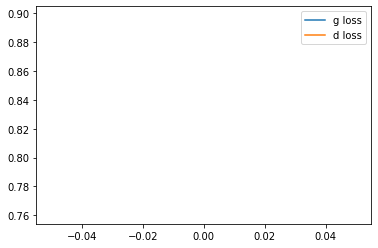

it: 200; g_loss: 1.8295104503631592; d_loss: 0.23131822049617767; avg_real_score: 0.753217339515686; avg_fake_score: 0.18186242878437042: : 199it [00:14, 13.87it/s]

epoch 0 generated images


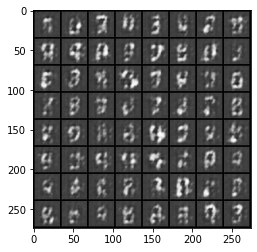

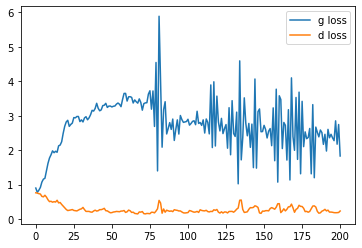

it: 400; g_loss: 8.055845260620117; d_loss: 0.6284283399581909; avg_real_score: 0.9943305253982544; avg_fake_score: 0.00045261805644258857: : 399it [00:29, 13.91it/s]

epoch 0 generated images


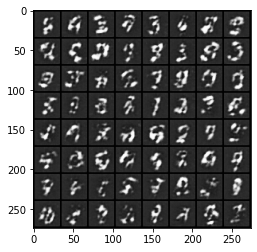

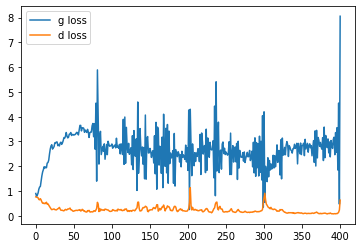

it: 468; g_loss: 2.8705527782440186; d_loss: 0.08657406270503998; avg_real_score: 0.9224163293838501; avg_fake_score: 0.0665636882185936: : 469it [00:34, 13.46it/s]
it: 469; g_loss: 2.6086831092834473; d_loss: 0.08837206661701202; avg_real_score: 0.9082857966423035; avg_fake_score: 0.08905905485153198: : 0it [00:00, ?it/s]

epoch 1 generated images


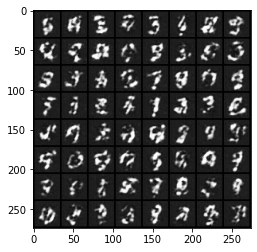

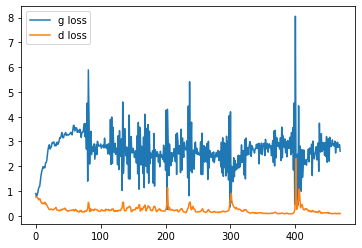

it: 669; g_loss: 1.8603030443191528; d_loss: 0.1837129294872284; avg_real_score: 0.8107680678367615; avg_fake_score: 0.17233788967132568: : 199it [00:15, 13.15it/s]

epoch 1 generated images


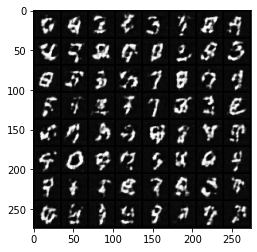

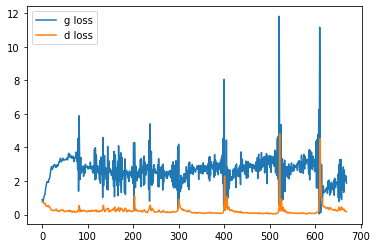

it: 869; g_loss: 2.087634563446045; d_loss: 0.417277067899704; avg_real_score: 0.5425162315368652; avg_fake_score: 0.14396440982818604: : 399it [00:30, 13.35it/s] 

epoch 1 generated images


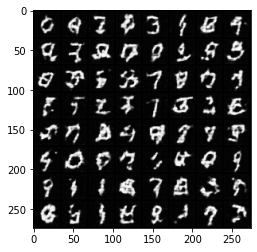

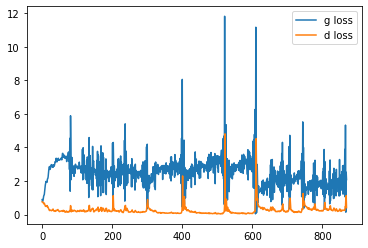

it: 937; g_loss: 2.3064141273498535; d_loss: 0.23002217710018158; avg_real_score: 0.82654869556427; avg_fake_score: 0.11988237500190735: : 469it [00:36, 13.00it/s]
it: 938; g_loss: 1.5866031646728516; d_loss: 0.2587914764881134; avg_real_score: 0.7599347829818726; avg_fake_score: 0.23093554377555847: : 0it [00:00, ?it/s]

epoch 2 generated images


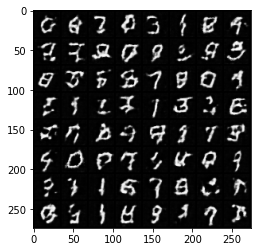

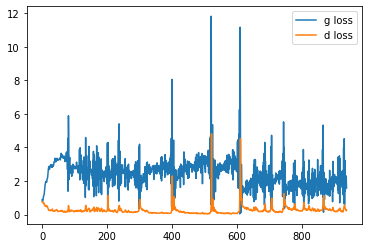

it: 1138; g_loss: 0.9885028600692749; d_loss: 0.3243311047554016; avg_real_score: 0.591578483581543; avg_fake_score: 0.3986172378063202: : 199it [00:15, 13.05it/s]   

epoch 2 generated images


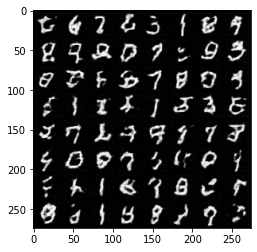

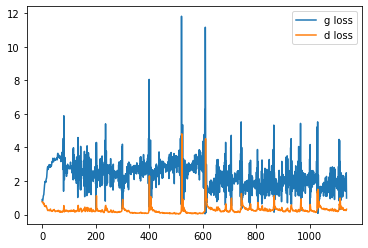

it: 1338; g_loss: 1.3819975852966309; d_loss: 0.35876867175102234; avg_real_score: 0.538129448890686; avg_fake_score: 0.2823658883571625: : 399it [00:31, 13.08it/s]  

epoch 2 generated images


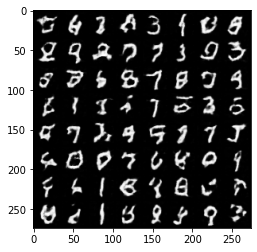

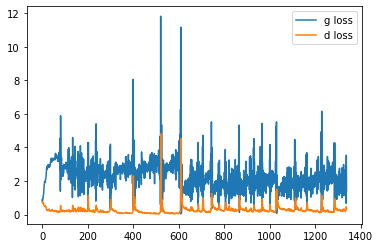

it: 1406; g_loss: 2.373990774154663; d_loss: 0.14410042762756348; avg_real_score: 0.8586406111717224; avg_fake_score: 0.12176130712032318: : 469it [00:37, 12.57it/s]
it: 1407; g_loss: 2.62917160987854; d_loss: 0.14067062735557556; avg_real_score: 0.8996145129203796; avg_fake_score: 0.09181658178567886: : 0it [00:00, ?it/s]

epoch 3 generated images


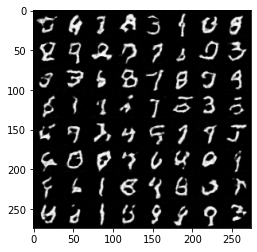

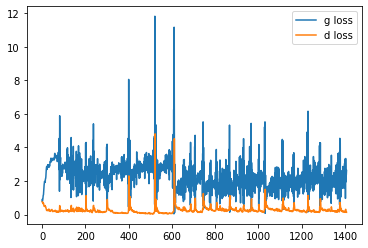

it: 1607; g_loss: 2.1168131828308105; d_loss: 0.12678509950637817; avg_real_score: 0.8431639671325684; avg_fake_score: 0.143528014421463: : 199it [00:16, 12.62it/s]  

epoch 3 generated images


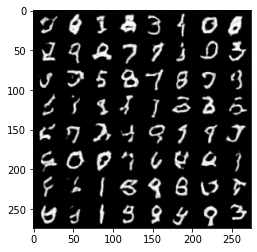

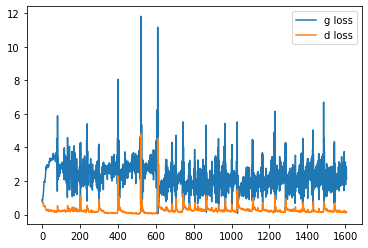

it: 1807; g_loss: 2.300004482269287; d_loss: 0.2962396740913391; avg_real_score: 0.8344684839248657; avg_fake_score: 0.12404760718345642: : 399it [00:32, 12.52it/s] 

epoch 3 generated images


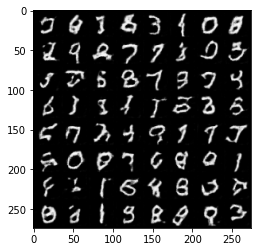

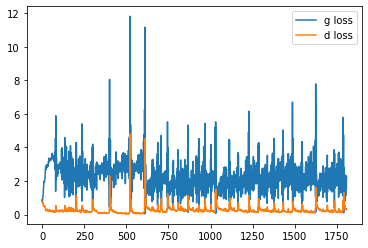

it: 1875; g_loss: 3.9129443168640137; d_loss: 0.33382055163383484; avg_real_score: 0.9602819681167603; avg_fake_score: 0.025915756821632385: : 469it [00:38, 12.20it/s]
it: 1876; g_loss: 1.3933100700378418; d_loss: 0.2914187014102936; avg_real_score: 0.6020854711532593; avg_fake_score: 0.2834296226501465: : 0it [00:00, ?it/s]

epoch 4 generated images


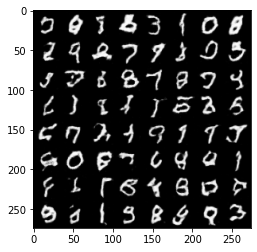

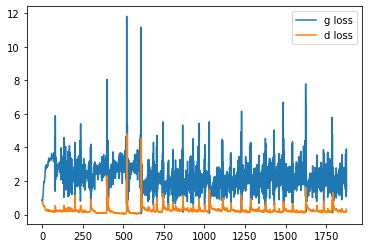

it: 2076; g_loss: 1.582749843597412; d_loss: 0.2156142145395279; avg_real_score: 0.7297557592391968; avg_fake_score: 0.2508806586265564: : 199it [00:16, 12.54it/s]    

epoch 4 generated images


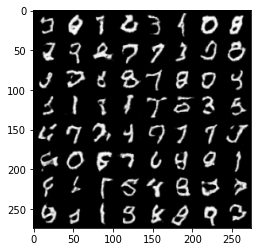

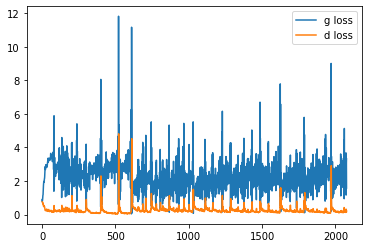

it: 2276; g_loss: 1.6249709129333496; d_loss: 0.2596471309661865; avg_real_score: 0.6989148855209351; avg_fake_score: 0.24307243525981903: : 399it [00:33, 12.38it/s] 

epoch 4 generated images


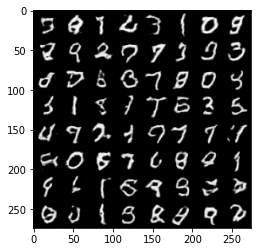

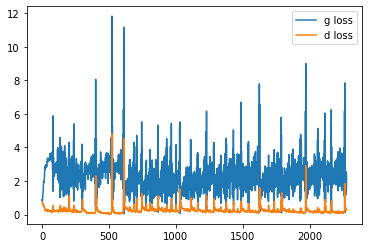

it: 2344; g_loss: 3.4985618591308594; d_loss: 0.15396219491958618; avg_real_score: 0.9555289149284363; avg_fake_score: 0.03948133438825607: : 469it [00:39, 11.95it/s]
it: 2345; g_loss: 2.751497745513916; d_loss: 0.15087492763996124; avg_real_score: 0.8327574729919434; avg_fake_score: 0.08421702682971954: : 0it [00:00, ?it/s]

epoch 5 generated images


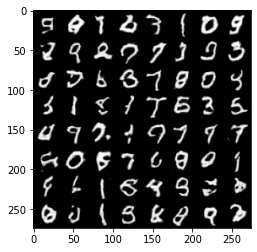

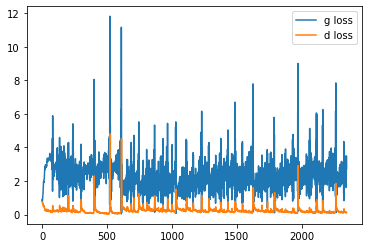

it: 2545; g_loss: 2.390936851501465; d_loss: 0.11567115038633347; avg_real_score: 0.8933559656143188; avg_fake_score: 0.11639764904975891: : 199it [00:17, 11.69it/s] 

epoch 5 generated images


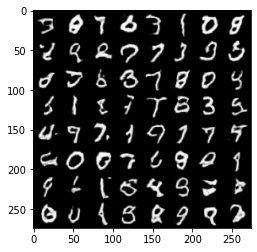

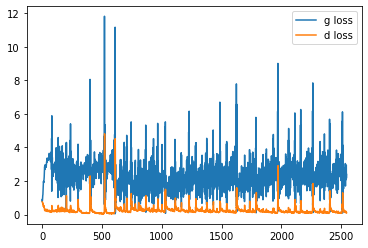

it: 2745; g_loss: 1.6594722270965576; d_loss: 0.16945835947990417; avg_real_score: 0.7675149440765381; avg_fake_score: 0.22301621735095978: : 399it [00:34, 11.71it/s]

epoch 5 generated images


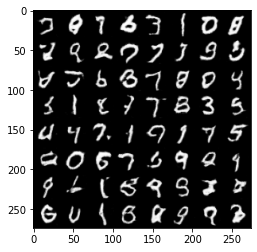

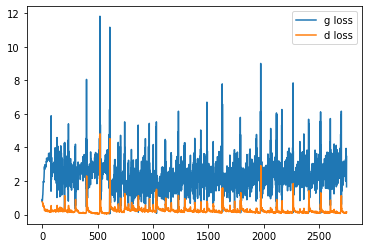

it: 2813; g_loss: 3.7433719635009766; d_loss: 0.07236440479755402; avg_real_score: 0.9637176990509033; avg_fake_score: 0.03516549989581108: : 469it [00:40, 11.58it/s]
it: 2814; g_loss: 2.2657203674316406; d_loss: 0.10848438739776611; avg_real_score: 0.8668203353881836; avg_fake_score: 0.12995880842208862: : 0it [00:00, ?it/s]

epoch 6 generated images


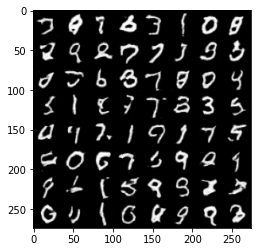

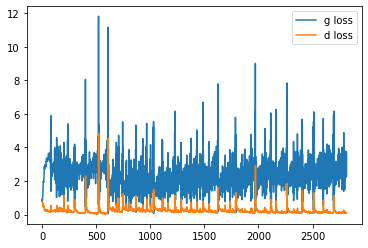

it: 3014; g_loss: 3.3267364501953125; d_loss: 0.12645165622234344; avg_real_score: 0.9500178098678589; avg_fake_score: 0.048016928136348724: : 199it [00:17, 11.50it/s]

epoch 6 generated images


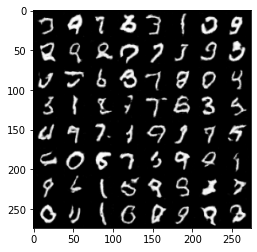

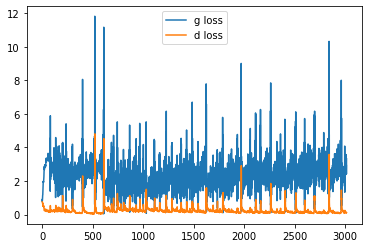

it: 3214; g_loss: 2.8911001682281494; d_loss: 0.09141269326210022; avg_real_score: 0.9430136680603027; avg_fake_score: 0.07722751796245575: : 399it [00:34, 11.74it/s]

epoch 6 generated images


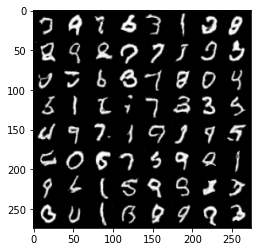

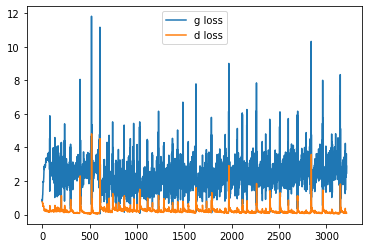

it: 3282; g_loss: 3.676872968673706; d_loss: 0.04735179990530014; avg_real_score: 0.963036060333252; avg_fake_score: 0.04143279418349266: : 469it [00:41, 11.43it/s]
it: 3283; g_loss: 2.2924201488494873; d_loss: 0.08696343004703522; avg_real_score: 0.8984702825546265; avg_fake_score: 0.13483375310897827: : 0it [00:00, ?it/s]

epoch 7 generated images


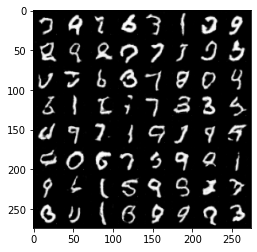

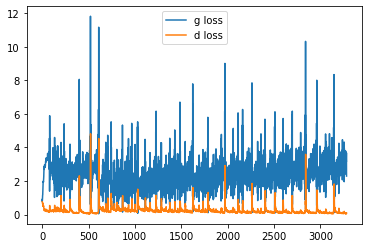

it: 3483; g_loss: 2.8209385871887207; d_loss: 0.06964486092329025; avg_real_score: 0.9176604151725769; avg_fake_score: 0.07919415831565857: : 200it [00:17, 11.52it/s]

epoch 7 generated images


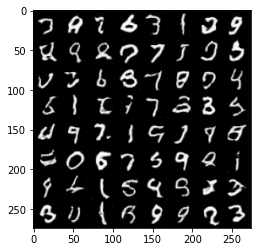

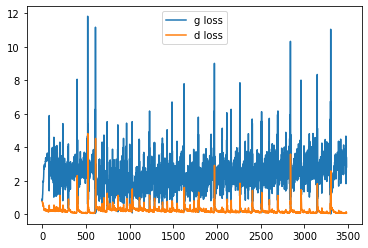

it: 3683; g_loss: 2.514885425567627; d_loss: 0.13844479620456696; avg_real_score: 0.8218532800674438; avg_fake_score: 0.10994742810726166: : 400it [00:35, 11.65it/s]

epoch 7 generated images


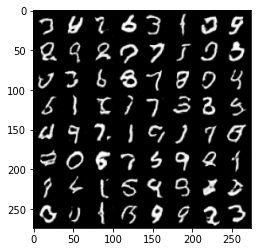

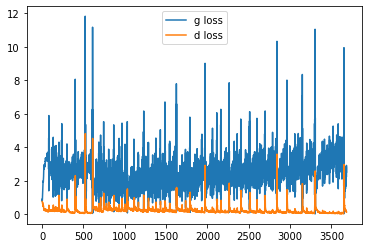

it: 3751; g_loss: 3.2500839233398438; d_loss: 0.05127819627523422; avg_real_score: 0.9664604663848877; avg_fake_score: 0.0505131259560585: : 469it [00:42, 11.14it/s]
it: 3752; g_loss: 3.8438658714294434; d_loss: 0.06400451064109802; avg_real_score: 0.9604201316833496; avg_fake_score: 0.030383028090000153: : 0it [00:00, ?it/s]

epoch 8 generated images


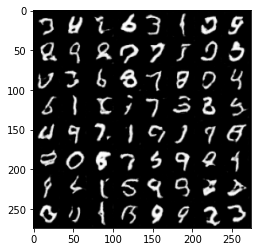

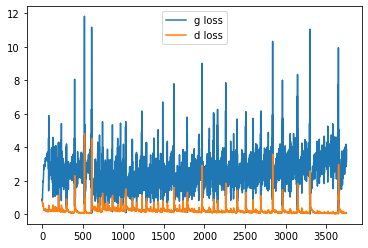

it: 3952; g_loss: 3.9728479385375977; d_loss: 0.03828416392207146; avg_real_score: 0.9652408957481384; avg_fake_score: 0.029586469754576683: : 200it [00:18, 11.50it/s]

epoch 8 generated images


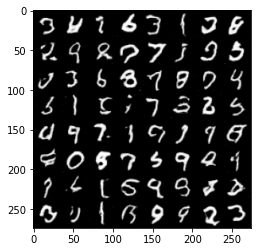

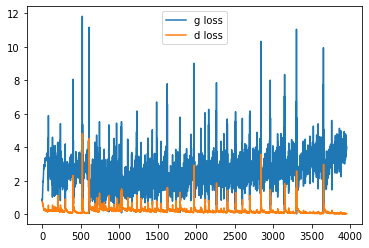

it: 4152; g_loss: 3.462738037109375; d_loss: 0.053311824798583984; avg_real_score: 0.9487401247024536; avg_fake_score: 0.044941991567611694: : 400it [00:36, 11.11it/s]

epoch 8 generated images


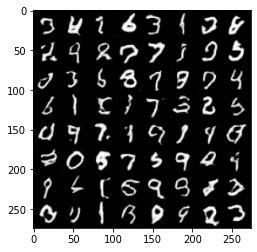

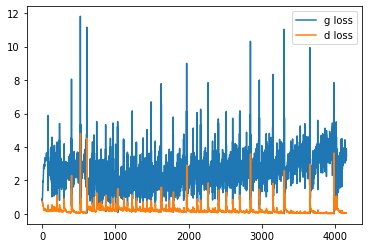

it: 4220; g_loss: 3.062363386154175; d_loss: 0.06347373127937317; avg_real_score: 0.896901547908783; avg_fake_score: 0.06978948414325714: : 469it [00:42, 10.96it/s]
it: 4221; g_loss: 3.904646873474121; d_loss: 0.05385223776102066; avg_real_score: 0.987644374370575; avg_fake_score: 0.034603945910930634: : 0it [00:00, ?it/s]

epoch 9 generated images


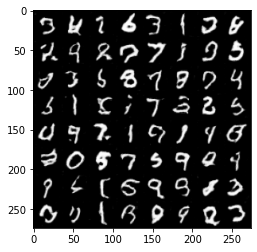

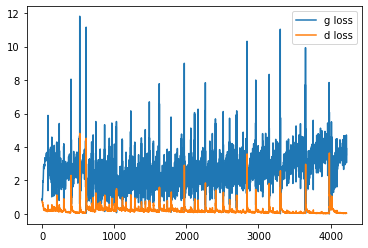

it: 4421; g_loss: 4.129443645477295; d_loss: 0.0512690469622612; avg_real_score: 0.9783316850662231; avg_fake_score: 0.02497890032827854: : 200it [00:18, 11.17it/s]  

epoch 9 generated images


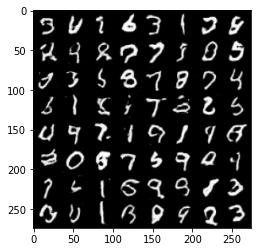

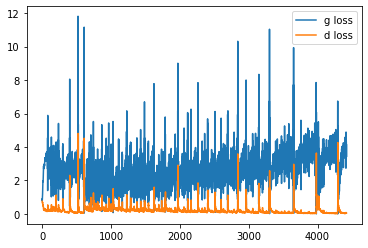

it: 4621; g_loss: 3.4375791549682617; d_loss: 0.0474129244685173; avg_real_score: 0.9421557784080505; avg_fake_score: 0.04834648594260216: : 400it [00:36, 11.22it/s]

epoch 9 generated images


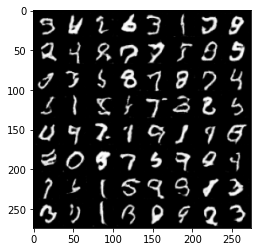

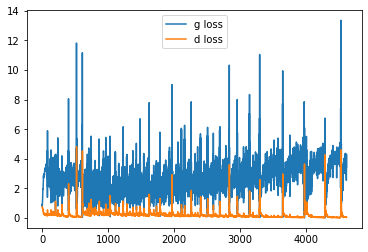

it: 4689; g_loss: 4.200654029846191; d_loss: 0.026148386299610138; avg_real_score: 0.9778760671615601; avg_fake_score: 0.022909898310899734: : 469it [00:43, 10.79it/s]
it: 4690; g_loss: 5.069705009460449; d_loss: 0.013403242453932762; avg_real_score: 0.9867047071456909; avg_fake_score: 0.011215992271900177: : 0it [00:00, ?it/s]

epoch 10 generated images


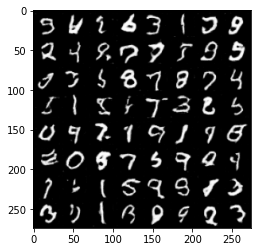

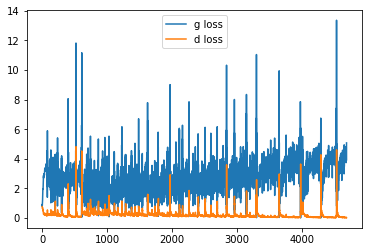

it: 4890; g_loss: 4.665332794189453; d_loss: 0.01822921633720398; avg_real_score: 0.9735307693481445; avg_fake_score: 0.01491640042513609: : 199it [00:18, 10.77it/s] 

epoch 10 generated images


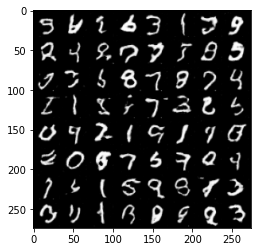

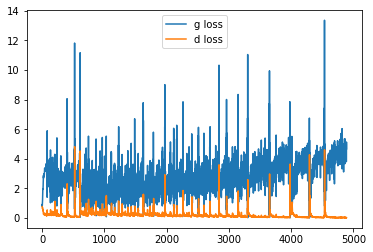

it: 5090; g_loss: 1.0057342052459717; d_loss: 0.44436702132225037; avg_real_score: 0.5215672254562378; avg_fake_score: 0.39918309450149536: : 400it [00:37, 10.95it/s]

epoch 10 generated images


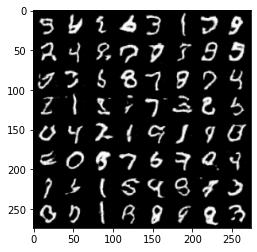

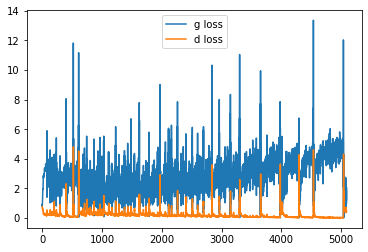

it: 5158; g_loss: 1.8855092525482178; d_loss: 0.324966698884964; avg_real_score: 0.6382583379745483; avg_fake_score: 0.19044610857963562: : 469it [00:44, 10.54it/s]
it: 5159; g_loss: 1.351290225982666; d_loss: 0.32822632789611816; avg_real_score: 0.732656717300415; avg_fake_score: 0.3004424571990967: : 0it [00:00, ?it/s]

epoch 11 generated images


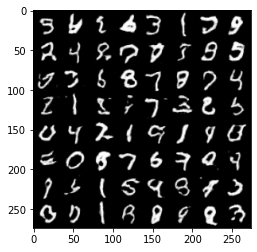

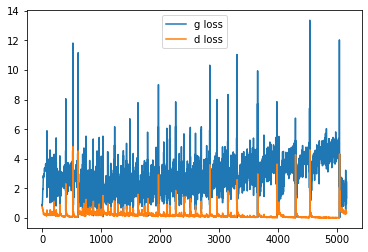

it: 5359; g_loss: 1.6372556686401367; d_loss: 0.27909553050994873; avg_real_score: 0.676436185836792; avg_fake_score: 0.23889175057411194: : 199it [00:19, 10.80it/s]

epoch 11 generated images


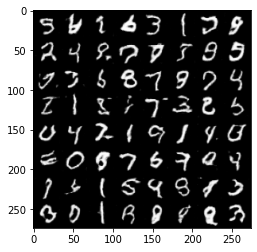

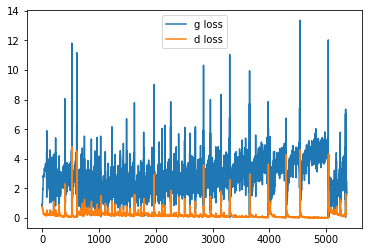

it: 5559; g_loss: 4.251892566680908; d_loss: 0.019422704353928566; avg_real_score: 0.9780804514884949; avg_fake_score: 0.021511562168598175: : 400it [00:38, 10.44it/s]

epoch 11 generated images


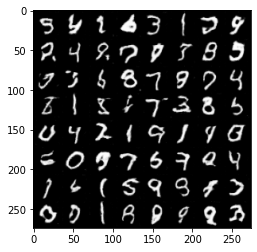

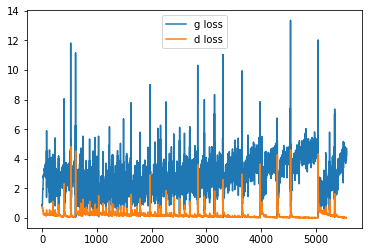

it: 5627; g_loss: 5.027549743652344; d_loss: 0.013182497583329678; avg_real_score: 0.9844409823417664; avg_fake_score: 0.010980186983942986: : 469it [00:45, 10.40it/s]
it: 5628; g_loss: 4.828400611877441; d_loss: 0.018191061913967133; avg_real_score: 0.98106849193573; avg_fake_score: 0.01561700738966465: : 0it [00:00, ?it/s]

epoch 12 generated images


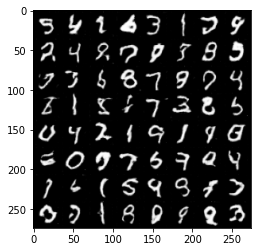

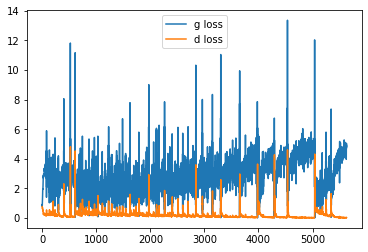

it: 5828; g_loss: 4.524344444274902; d_loss: 0.016929268836975098; avg_real_score: 0.9846172332763672; avg_fake_score: 0.017976121976971626: : 200it [00:19, 10.57it/s]

epoch 12 generated images


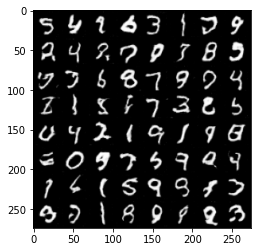

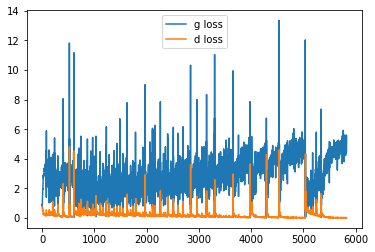

it: 6028; g_loss: 2.5288636684417725; d_loss: 0.1638595163822174; avg_real_score: 0.8525078296661377; avg_fake_score: 0.10653574019670486: : 399it [00:38, 10.71it/s]

epoch 12 generated images


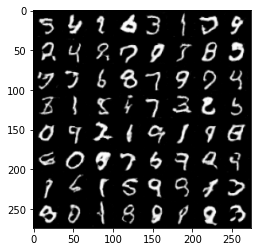

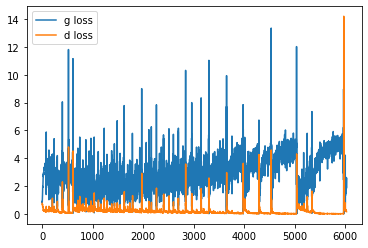

it: 6096; g_loss: 4.028127193450928; d_loss: 0.4051544666290283; avg_real_score: 0.9741355776786804; avg_fake_score: 0.025087689980864525: : 469it [00:45, 10.27it/s]
it: 6097; g_loss: 1.7900338172912598; d_loss: 0.31109675765037537; avg_real_score: 0.5923906564712524; avg_fake_score: 0.21361646056175232: : 0it [00:00, ?it/s]

epoch 13 generated images


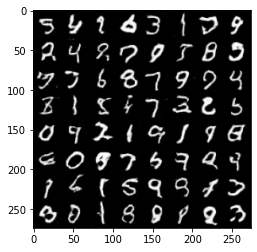

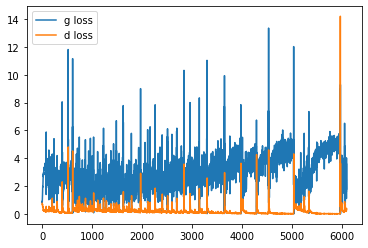

it: 6297; g_loss: 4.336026668548584; d_loss: 0.024725506082177162; avg_real_score: 0.9826542735099792; avg_fake_score: 0.02121402509510517: : 199it [00:19, 10.60it/s]

epoch 13 generated images


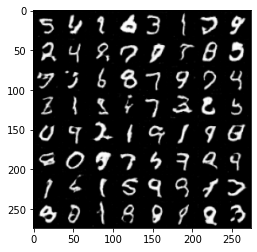

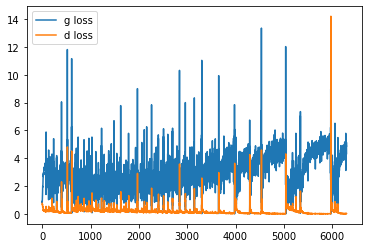

it: 6497; g_loss: 5.247922897338867; d_loss: 0.012171465903520584; avg_real_score: 0.9859340786933899; avg_fake_score: 0.00841033086180687: : 399it [00:38, 10.46it/s] 

epoch 13 generated images


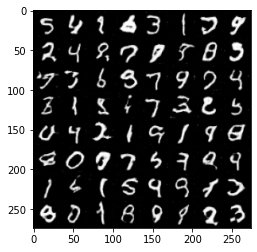

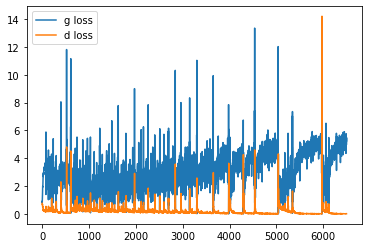

it: 6565; g_loss: 5.568460464477539; d_loss: 0.008900304324924946; avg_real_score: 0.9894601702690125; avg_fake_score: 0.006398829631507397: : 469it [00:45, 10.22it/s]
it: 6566; g_loss: 4.92330265045166; d_loss: 0.013729498721659184; avg_real_score: 0.9810574650764465; avg_fake_score: 0.013357095420360565: : 0it [00:00, ?it/s]

epoch 14 generated images


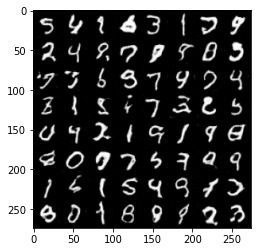

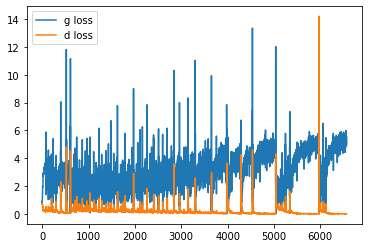

it: 6766; g_loss: 6.146285533905029; d_loss: 0.005205951631069183; avg_real_score: 0.9928558468818665; avg_fake_score: 0.0034522172063589096: : 200it [00:20, 10.51it/s]

epoch 14 generated images


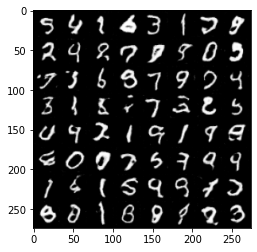

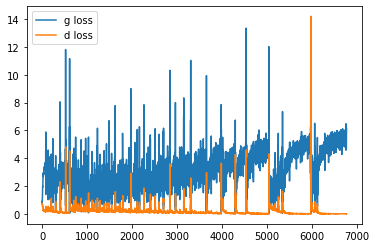

it: 6966; g_loss: 5.968373775482178; d_loss: 0.007467947900295258; avg_real_score: 0.9885708689689636; avg_fake_score: 0.004579707980155945: : 400it [00:41,  8.81it/s]

epoch 14 generated images


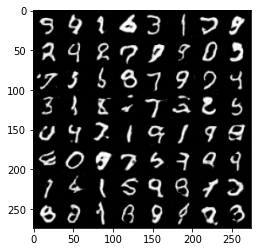

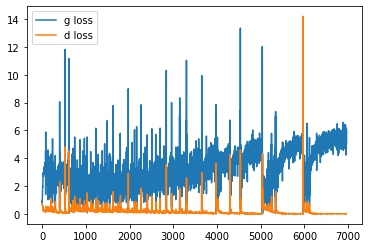

it: 7034; g_loss: 5.718127250671387; d_loss: 0.007528277579694986; avg_real_score: 0.9946660399436951; avg_fake_score: 0.007057216018438339: : 469it [00:49,  9.40it/s]


In [ ]:
nb_epochs = 15

g_losses = []
d_losses = []


nz = 1000
ngf = 32
ndf = 32

nchannels= 1 
lr_d = 0.0002
lr_g = 0.0005
beta1= 0.5
display_freq = 200

netD = Discriminator(ndf, nchannels).to(device)
netG = Generator(nz, ngf).to(device)

netD.apply(weights_init)
netG.apply(weights_init)

g_opt = torch.optim.Adam(netG.parameters(), lr=lr_g, betas=(beta1, 0.999))
d_opt = torch.optim.Adam(netD.parameters(), lr=lr_d, betas=(beta1, 0.999))
j = 0


z_test = sample_z(64, nz) # we generate the noise only once for testing

for epoch in range(nb_epochs):
    
    # train
    pbar = tqdm(enumerate(dataloader))
    for i, batch in pbar:
        im, _ = batch # we don't care about the label for unconditional generation
        im = im.to(device)
        
        cur_batch_size = im.shape[0]  
        
        # 1. sample a z vector 
        z = sample_z(cur_batch_size, nz)
        
        # 2. Generate a fake image

        fake_im = netG(z)

        # 3. Classify real image with D
        
        real_logits = netD(im)


        # 4. Classify fake image with D
       
        fake_logits = netD(fake_im.detach())
         
        ###
        ### Discriminator
        ###
        d_loss = criterion(real_logits, get_labels_one(cur_batch_size).to(device))
        d_loss = (d_loss + criterion(fake_logits, get_labels_zero(cur_batch_size).to(device)))/2
        d_opt.zero_grad()
        d_loss.backward() # we need to retain graph=True to be able to calculate the gradient in the g backprop
        d_opt.step()

        
        ###
        ### Generator
        ###
        
        fake_logits = netD(fake_im)
        g_loss = criterion(fake_logits, get_labels_one(cur_batch_size).to(device)) 
        g_opt.zero_grad()
        g_loss.backward()
        g_opt.step()
        
                
        d_losses.append(d_loss.item())
        g_losses.append(g_loss.item())
        
        avg_real_score = torch.mean(real_logits).item()
        avg_fake_score = torch.mean(fake_logits).item()


        pbar.set_description(f"it: {j}; g_loss: {g_loss}; d_loss: {d_loss}; avg_real_score: {avg_real_score}; avg_fake_score: {avg_fake_score}")
        if i % display_freq == 0:

            fake_im = netG(z_test)
            
            un_norm = renorm(fake_im) # for visualization
            
            grid = torchvision.utils.make_grid(un_norm, nrow=8)
            pil_grid = to_pil(grid)  
            
            print("epoch", epoch, "generated images")
            plt.imshow(pil_grid)
            plt.show()
            
            plt.plot(range(len(g_losses)), g_losses, label='g loss')
            plt.plot(range(len(g_losses)), d_losses, label='d loss')
            
            plt.legend()
            plt.show()  
        j += 1

##Pretrained GAN with two noise vectors

epoch 14 generated images


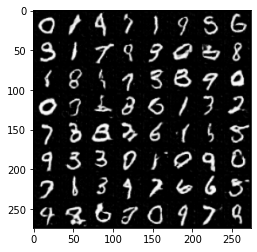

In [ ]:
alpha = 0.2
z_test1, z_test2 = sample_z(64, nz), sample_z(64, nz)
z_test = alpha*z_test1 + (1-alpha)*z_test2

fake_im = netG(z_test)
            
un_norm = renorm(fake_im) # for visualization

grid = torchvision.utils.make_grid(un_norm, nrow=8)
pil_grid = to_pil(grid)  

print("epoch", epoch, "generated images")
plt.imshow(pil_grid)
plt.show()

epoch 14 generated images


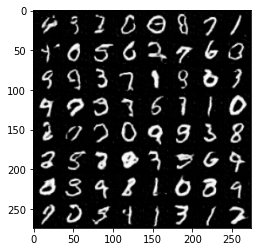

In [ ]:
alpha = 0.5
z_test1, z_test2 = sample_z(64, nz), sample_z(64, nz)
z_test = alpha*z_test1 + (1-alpha)*z_test2

fake_im = netG(z_test)
            
un_norm = renorm(fake_im) # for visualization

grid = torchvision.utils.make_grid(un_norm, nrow=8)
pil_grid = to_pil(grid)  

print("epoch", epoch, "generated images")
plt.imshow(pil_grid)
plt.show()

epoch 14 generated images


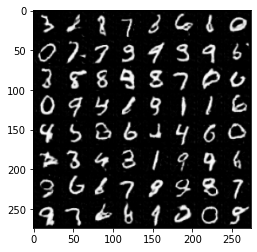

In [ ]:
fake_im = netG(z_test1)
            
un_norm = renorm(fake_im) # for visualization

grid = torchvision.utils.make_grid(un_norm, nrow=8)
pil_grid = to_pil(grid)  

print("epoch", epoch, "generated images")
plt.imshow(pil_grid)
plt.show()

epoch 14 generated images


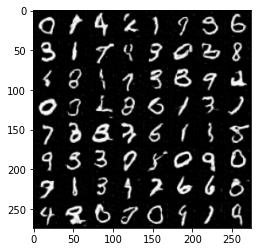

In [ ]:
fake_im = netG(z_test2)
            
un_norm = renorm(fake_im) # for visualization

grid = torchvision.utils.make_grid(un_norm, nrow=8)
pil_grid = to_pil(grid)  

print("epoch", epoch, "generated images")
plt.imshow(pil_grid)
plt.show()

## 64 x 64 images

# 4. Conditional GANs [BONUS]

A simple way to improve training performance and obtain control of the generation is to provide extra information into the Generator and the Discriminator, known as **Conditional GANs**. In this case, we will provide the class label (digit number of MNIST) into both the generator and the discriminator. This will help both of the networks.

## 4.1 Conditional Generator and Discriminator

Complete the ConditionalDiscriminator and ConditionalGenerator classes using your GAN building blocks (`get_upsampling_block` and `get_downsampling_block` functions).


### 4.1.1 Generator

In [ ]:
# GENERATOR

'''
The conditional generator needs the label information as well as the latent vector. We will combine the latent vector and the class information in the following way:

- The class information for the generator will be represented as a one-hot vector sized `[batch_size, 10]` (since there are 10 classes in MNIST)
- The latent vector for the generator will still be sized `[batch_size, nz]`

1. Transform both of these modalities into 'images' (by adding dimensions)
2. Like before, apply the first upscaling block to both of these 'images'. We will now have 2 separate blocks sized 

'''

class ConditionalGenerator(nn.Module):
    def __init__(self, nz, nc, ngf, nchannels=1):
        super().__init__()
        
        self.upscaling_z = get_upscaling_block(nz, ngf*8, 4, stride=1, padding=0)
        self.upscaling_c = get_upscaling_block(nc, ngf*8, 4, stride=1, padding=0)
        
        self.rest_model = nn.Sequential(
            get_upscaling_block(2*(ngf*8), ngf*8, 4, stride = 2, padding = 1),
            get_upscaling_block(ngf*8, ngf*4, 4, stride = 2, padding = 1),
            get_upscaling_block(ngf*4, nchannels, 4, stride = 2, padding = 1, last_layer=True),
        )
        
        
    def forward(self, x, y):
        x = x.unsqueeze(2).unsqueeze(2)
        y = y.unsqueeze(2).unsqueeze(2)
        x_ = self.upscaling_z(x)
        y_ = self.upscaling_c(y)

        cat = torch.cat((x_, y_), dim = 1)
        return self.rest_model(cat)

In [ ]:
nz = 100
z = torch.randn(10, nz)
y = torch.randn(10, 10)

In [ ]:
G = ConditionalGenerator(nz, 10, 16)

In [ ]:
G(z, y).size()

torch.Size([10, 1, 32, 32])

### 4.1.2 Discriminator

In [ ]:
# Discriminator

'''
The conditional discriminator needs the label information as well as the latent vector. We will combine the latent vector and the class information in the following way:

- The class information for the discriminator will be represented as a one-hot vector sized `[batch_size, 10]` (since there are 10 classes in MNIST)
- The latent vector for the generator will still be sized `[batch_size, nz]`

1. Transform both of these modalities into 'images' (by adding dimensions)
2. Like before, apply the first upscaling block to both of these 'images'. We will now have 2 separate blocks sized 

'''
    
class ConditionalDiscriminator(nn.Module):
    def __init__(self, ndf, nc, nchannels=1):
        super().__init__()
        self.downscale_x = get_downscaling_block(nchannels, ndf*2, 4, 2, 1, use_batch_norm=False)
        self.downscale_y = get_downscaling_block(nc, ndf*2, 4, 2, 1, use_batch_norm=False)
             
        self.rest = nn.Sequential(
            get_downscaling_block(ndf*4, ndf*4, 4, stride = 2, padding = 1),
            get_downscaling_block(ndf*4, ndf*8, 4, stride = 2, padding = 1),
            get_downscaling_block(ndf*8, nchannels, 4, stride = 1, padding = 0, is_last=True)
        )       
        
    def forward(self, x, y):
        y = y.unsqueeze(2).unsqueeze(2)
        y = y.expand(y.size(0), y.size(1), 32, 32)
        y = self.downscale_y(y)
        x = self.downscale_x(x)  
        cat = torch.cat((x, y), dim=1)
        return self.rest(cat).squeeze(1).squeeze(1) # remove spatial dimensions

In [ ]:
y = torch.randn(5, 10)
x = torch.randn(5, 1, 32, 32)
D = ConditionalDiscriminator(32, 10)

In [ ]:
D(x, y).size()

torch.Size([5, 64, 16, 16]) torch.Size([5, 64, 16, 16])
torch.Size([5, 128, 16, 16])


torch.Size([5, 1])

### 4.1.3 Sanity Checks

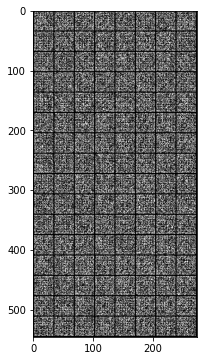

In [ ]:
# CONDITIONAL GENERATOR SANITY CHECKING

z = torch.randn(batch_size, nz)
y = F.one_hot(real_labels).float()

cG = ConditionalGenerator(nz=nz, ngf=16, nc=10)
x_fake = cG(z, y)
plt.imshow(transforms.ToPILImage()(make_grid(x_fake, nrow=8)))

In [ ]:
# Conditional Discriminator Sanity Checking

cD = ConditionalDiscriminator(ndf=32, nc=10, nchannels=1)
assert cD(real_batch, F.one_hot(real_labels).float()).shape == (real_batch.shape[0], 1)

## 4.2 Training

In [ ]:
nz = 100
ndf = 32
ngf = 32
nchannels= 1 
lr_d = 0.0002
lr_g = 0.0005
beta1= 0.5
display_freq = 200

nc= 10

netD = ConditionalDiscriminator(ndf, nc, nchannels=1).to(device)
netG = ConditionalGenerator(nz, nc, ngf).to(device)
        
netG.apply(weights_init)
netD.apply(weights_init)

g_opt = torch.optim.Adam(netG.parameters(), lr=lr_g, betas=(beta1, 0.999))
d_opt = torch.optim.Adam(netD.parameters(), lr=lr_d, betas=(beta1, 0.999))



it: 0; g_loss: 1.1169219017028809; d_loss: 0.826683759689331; avg_real_score: 0.49607765674591064; avg_fake_score: 0.37859046459198: : 0it [00:00, ?it/s]

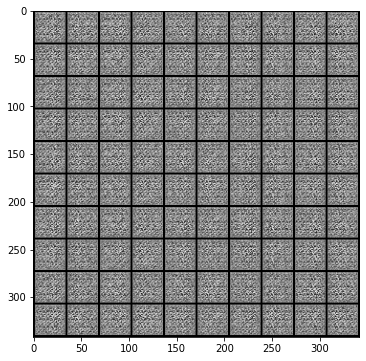

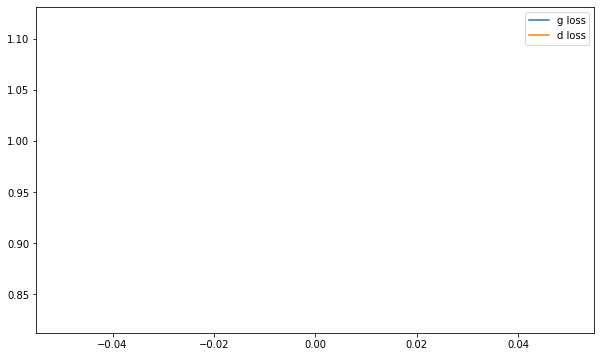

it: 200; g_loss: 1.4955799579620361; d_loss: 0.49316978454589844; avg_real_score: 0.5855462551116943; avg_fake_score: 0.23195329308509827: : 199it [00:19, 10.61it/s]

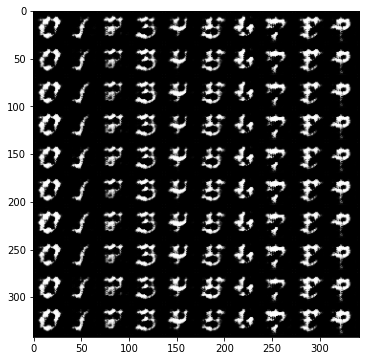

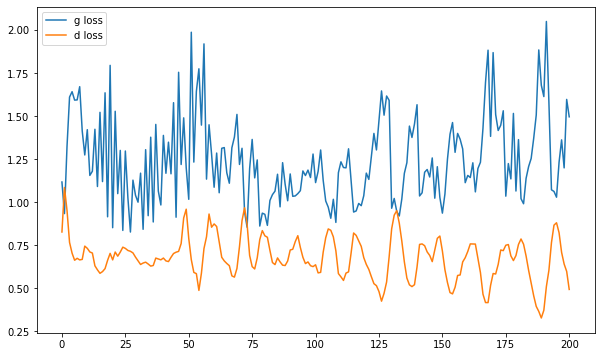

it: 400; g_loss: 1.5203437805175781; d_loss: 0.5945495367050171; avg_real_score: 0.5758320689201355; avg_fake_score: 0.23932531476020813: : 399it [00:38, 10.61it/s]

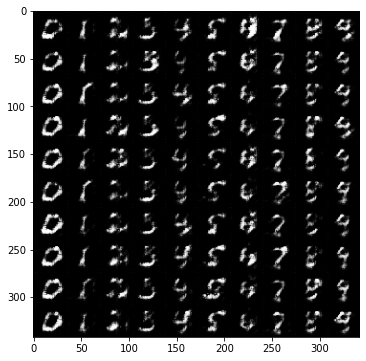

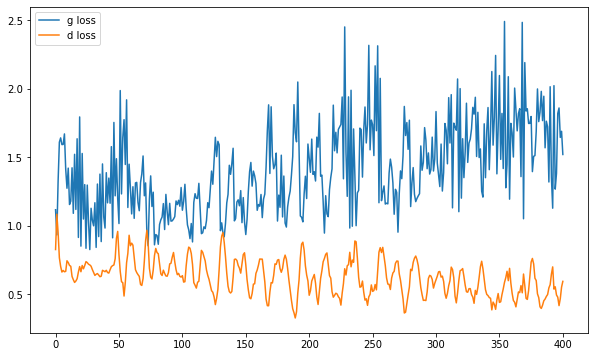

it: 468; g_loss: 1.835284948348999; d_loss: 0.5095875263214111; avg_real_score: 0.724945068359375; avg_fake_score: 0.18291108310222626: : 469it [00:45, 10.30it/s]
it: 469; g_loss: 1.4875179529190063; d_loss: 0.5270366668701172; avg_real_score: 0.5818405151367188; avg_fake_score: 0.24767355620861053: : 0it [00:00, ?it/s]

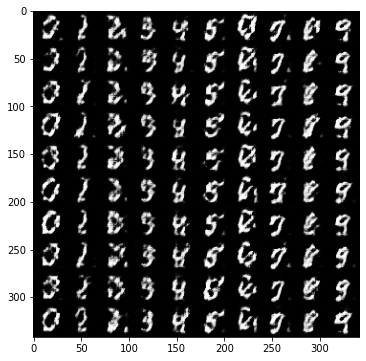

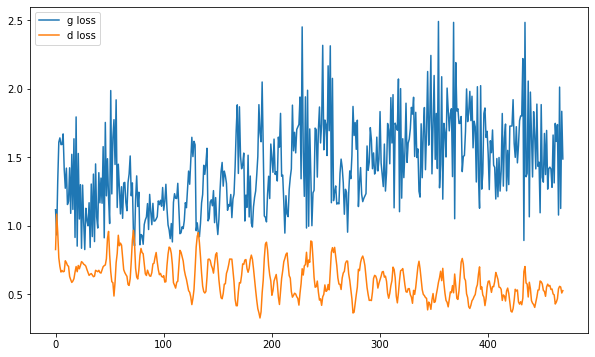

it: 669; g_loss: 0.7788958549499512; d_loss: 0.5811066031455994; avg_real_score: 0.48174744844436646; avg_fake_score: 0.47789937257766724: : 200it [00:19, 10.29it/s]

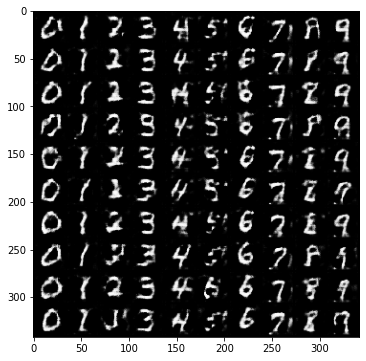

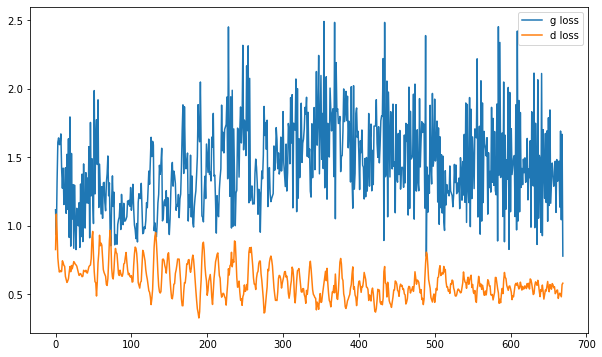

it: 869; g_loss: 1.579463243484497; d_loss: 0.5671791434288025; avg_real_score: 0.5966644883155823; avg_fake_score: 0.23715245723724365: : 400it [00:40, 10.27it/s]

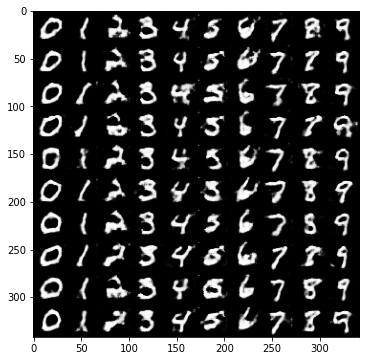

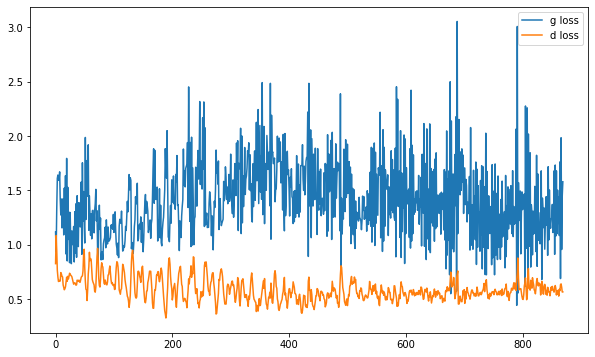

it: 937; g_loss: 0.7133984565734863; d_loss: 0.6324281692504883; avg_real_score: 0.4235134720802307; avg_fake_score: 0.5086855888366699: : 469it [00:47,  9.94it/s]
it: 938; g_loss: 1.5982005596160889; d_loss: 0.5901389718055725; avg_real_score: 0.7410722374916077; avg_fake_score: 0.2214958667755127: : 0it [00:00, ?it/s]

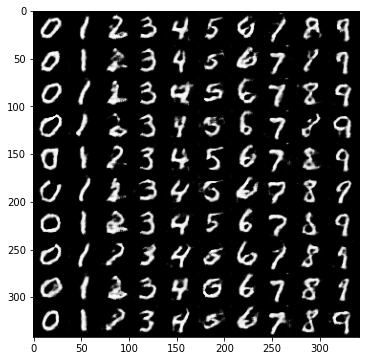

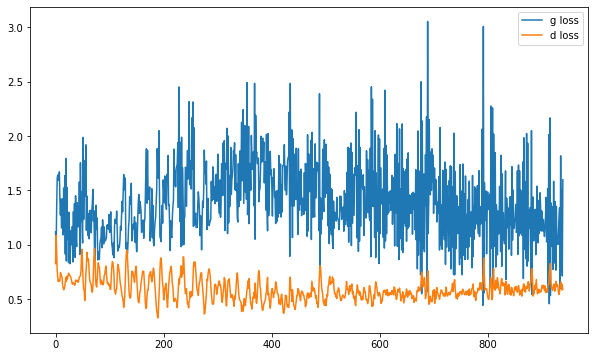

it: 1138; g_loss: 0.9562147259712219; d_loss: 0.6445625424385071; avg_real_score: 0.48988908529281616; avg_fake_score: 0.3961682617664337: : 200it [00:20,  9.70it/s]

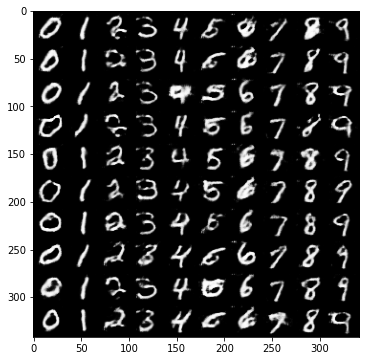

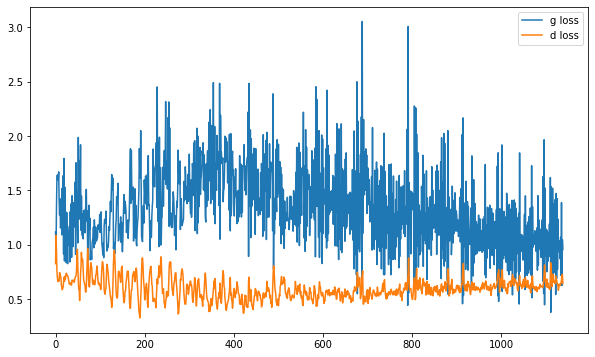

it: 1338; g_loss: 1.1309688091278076; d_loss: 0.6236920952796936; avg_real_score: 0.6662278771400452; avg_fake_score: 0.33688437938690186: : 400it [00:41,  9.70it/s]

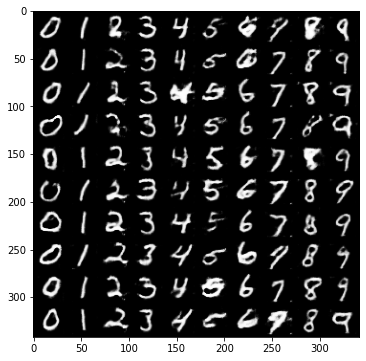

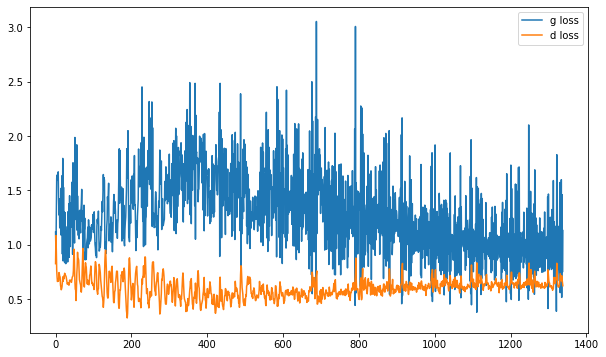

it: 1406; g_loss: 0.9086238741874695; d_loss: 0.6265740394592285; avg_real_score: 0.49622511863708496; avg_fake_score: 0.41617557406425476: : 469it [00:49,  9.57it/s]
it: 1407; g_loss: 0.867253303527832; d_loss: 0.583512544631958; avg_real_score: 0.5583984851837158; avg_fake_score: 0.43503302335739136: : 0it [00:00, ?it/s]

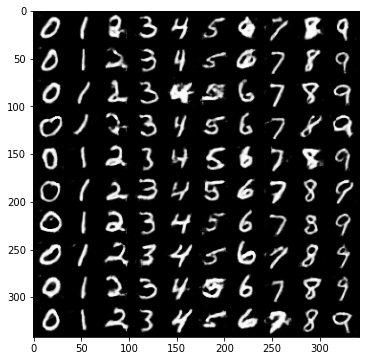

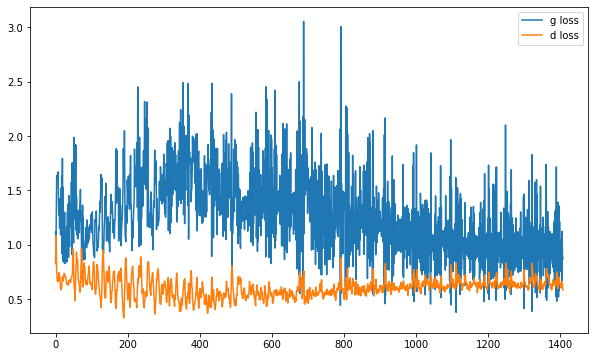

it: 1607; g_loss: 0.7168416976928711; d_loss: 0.6054205894470215; avg_real_score: 0.5265708565711975; avg_fake_score: 0.495363712310791: : 200it [00:21,  9.61it/s]

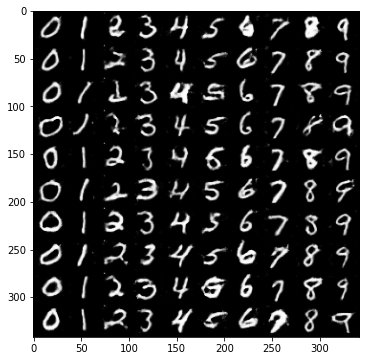

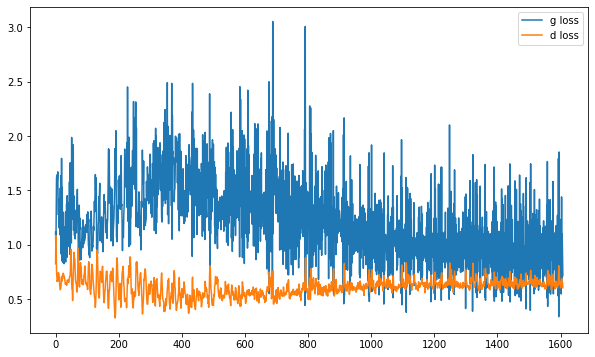

it: 1807; g_loss: 0.7256662845611572; d_loss: 0.6195172071456909; avg_real_score: 0.47905921936035156; avg_fake_score: 0.4933646023273468: : 400it [00:42,  9.40it/s]

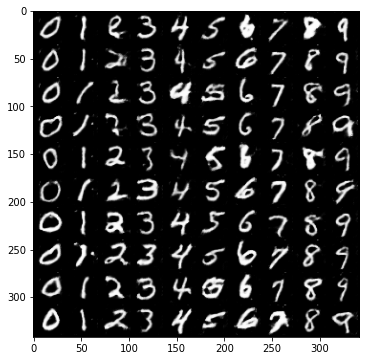

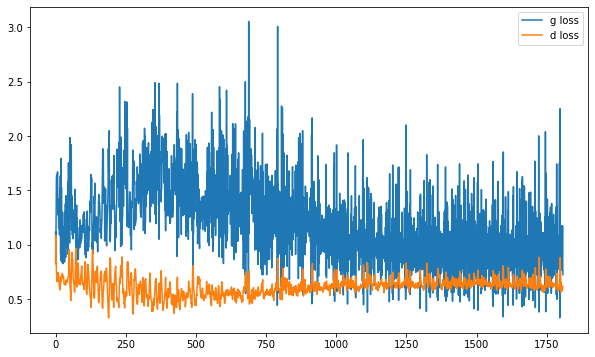

it: 1875; g_loss: 1.156303882598877; d_loss: 0.6218786835670471; avg_real_score: 0.6035596132278442; avg_fake_score: 0.3270413875579834: : 469it [00:50,  9.37it/s]
it: 1876; g_loss: 0.8027011156082153; d_loss: 0.6032623052597046; avg_real_score: 0.49606409668922424; avg_fake_score: 0.46157872676849365: : 0it [00:00, ?it/s]

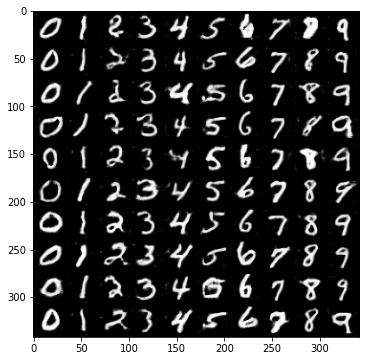

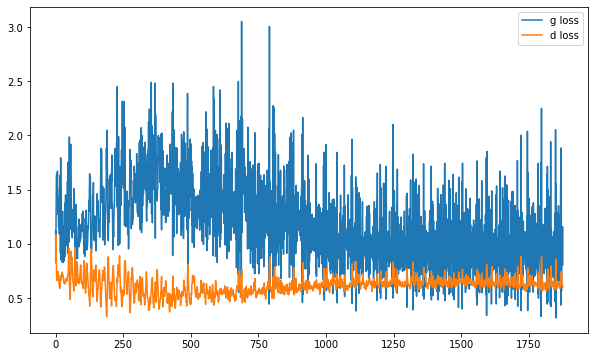

it: 2076; g_loss: 1.325228214263916; d_loss: 0.5766948461532593; avg_real_score: 0.6795815825462341; avg_fake_score: 0.27589380741119385: : 200it [00:21,  9.46it/s] 

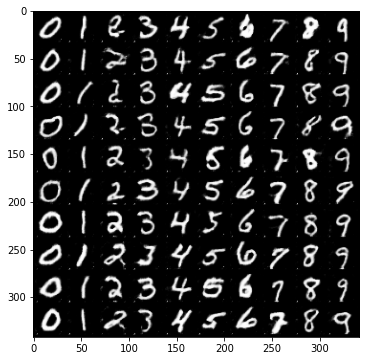

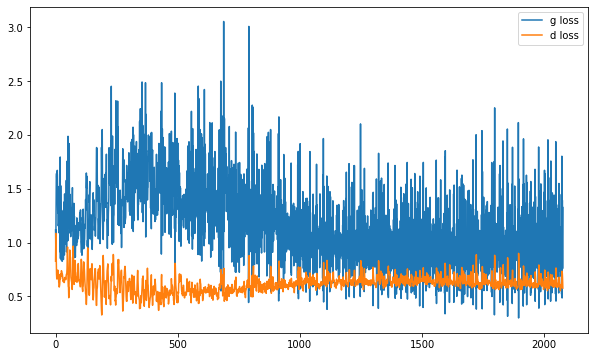

it: 2276; g_loss: 0.9620961546897888; d_loss: 0.5901384353637695; avg_real_score: 0.573817253112793; avg_fake_score: 0.3941884934902191: : 400it [00:42,  9.66it/s] 

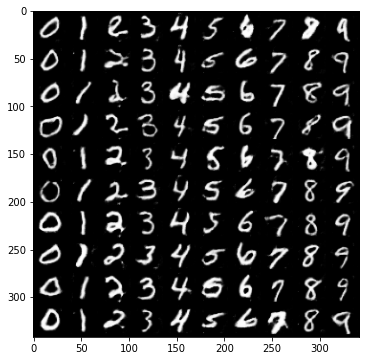

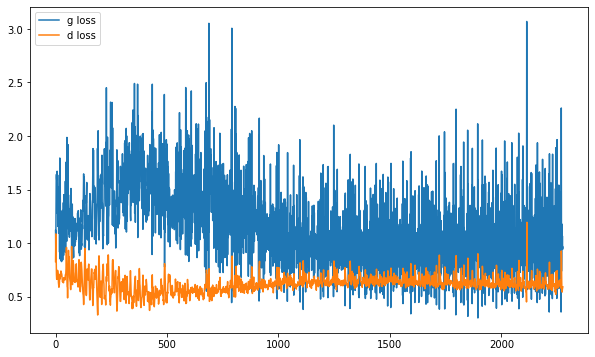

it: 2344; g_loss: 0.9947537183761597; d_loss: 0.5650332570075989; avg_real_score: 0.5355355143547058; avg_fake_score: 0.3801111578941345: : 469it [00:50,  9.32it/s]
it: 2345; g_loss: 0.7035767436027527; d_loss: 0.5542998313903809; avg_real_score: 0.5320218801498413; avg_fake_score: 0.5039077401161194: : 0it [00:00, ?it/s]

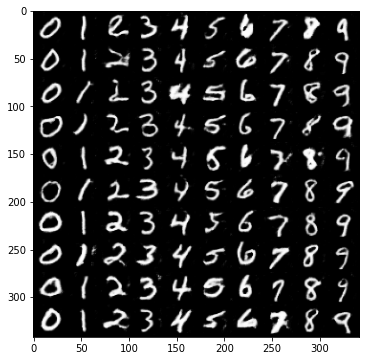

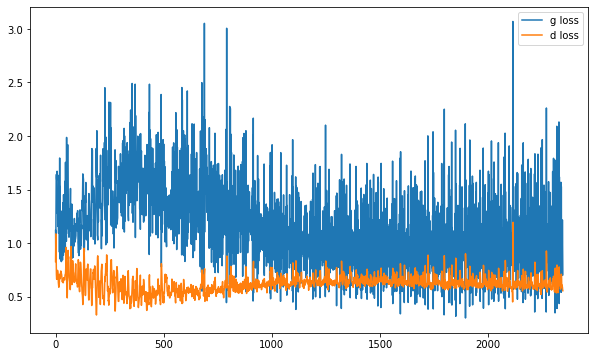

it: 2545; g_loss: 0.9415271282196045; d_loss: 0.5440287590026855; avg_real_score: 0.5560086965560913; avg_fake_score: 0.4043196737766266: : 200it [00:21,  9.35it/s] 

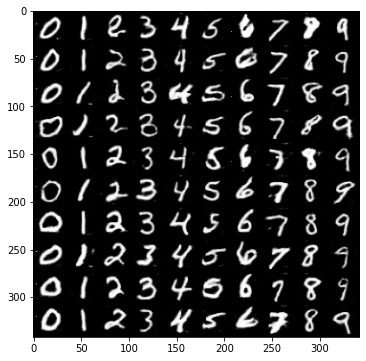

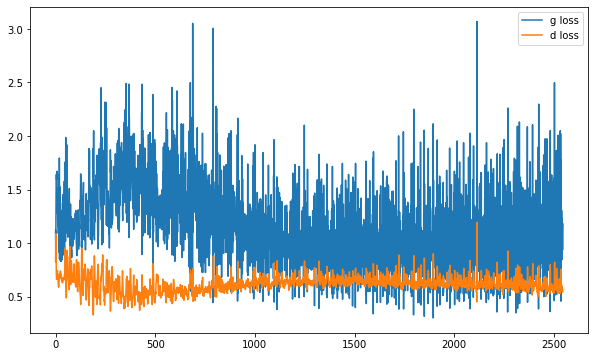

it: 2745; g_loss: 0.6322242021560669; d_loss: 0.6099021434783936; avg_real_score: 0.38686603307724; avg_fake_score: 0.5440253019332886: : 400it [00:43,  9.74it/s]   

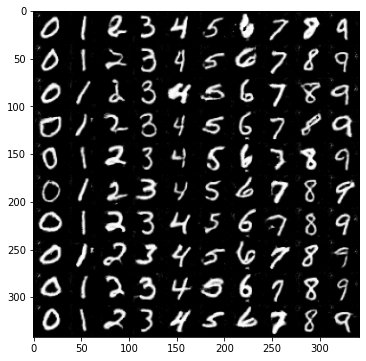

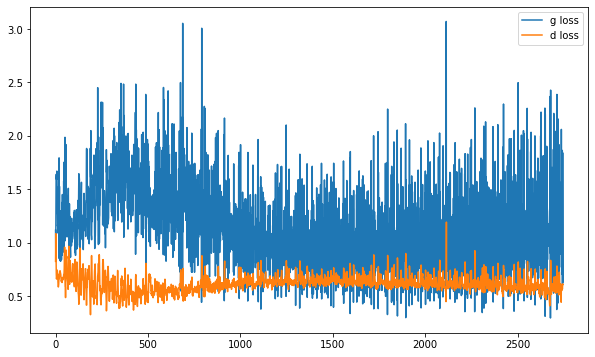

it: 2813; g_loss: 1.1923763751983643; d_loss: 0.5240867733955383; avg_real_score: 0.5695924758911133; avg_fake_score: 0.31937694549560547: : 469it [00:50,  9.28it/s]
it: 2814; g_loss: 0.9258202314376831; d_loss: 0.5458945035934448; avg_real_score: 0.5661670565605164; avg_fake_score: 0.41173055768013: : 0it [00:00, ?it/s]

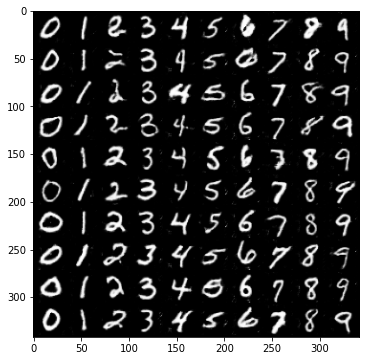

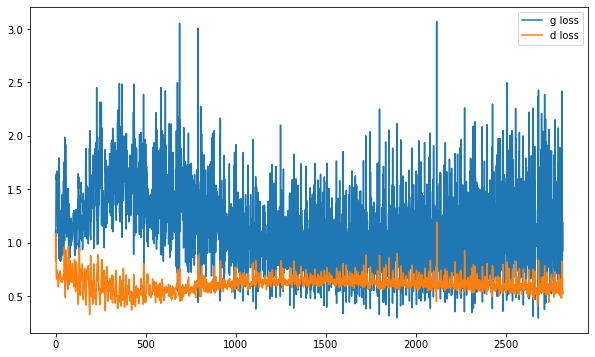

it: 3014; g_loss: 1.405463695526123; d_loss: 0.4749935269355774; avg_real_score: 0.6581684350967407; avg_fake_score: 0.2585856318473816: : 200it [00:21,  9.54it/s] 

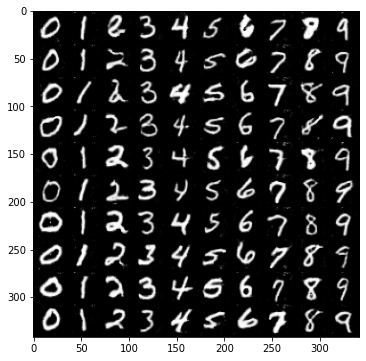

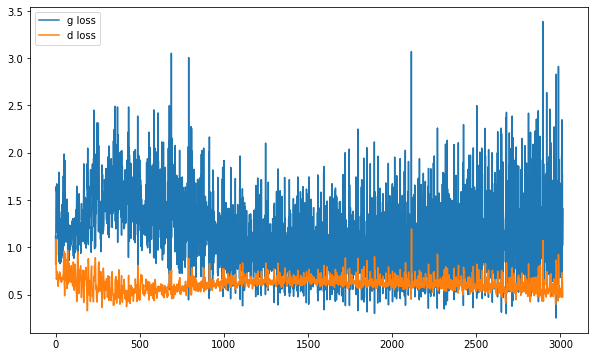

it: 3214; g_loss: 0.7038314342498779; d_loss: 0.5690725445747375; avg_real_score: 0.39886510372161865; avg_fake_score: 0.5075570344924927: : 400it [00:42,  9.51it/s]

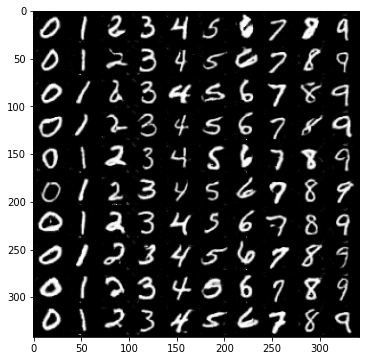

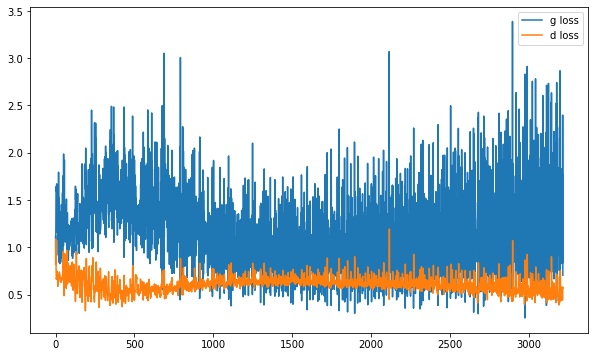

it: 3282; g_loss: 1.4461082220077515; d_loss: 0.442429780960083; avg_real_score: 0.6513494253158569; avg_fake_score: 0.2522212862968445: : 469it [00:50,  9.35it/s]
it: 3283; g_loss: 1.4091880321502686; d_loss: 0.4754866063594818; avg_real_score: 0.6509727239608765; avg_fake_score: 0.2604103684425354: : 0it [00:00, ?it/s]

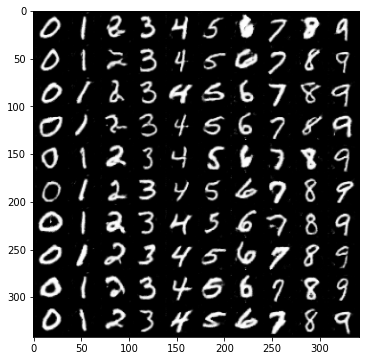

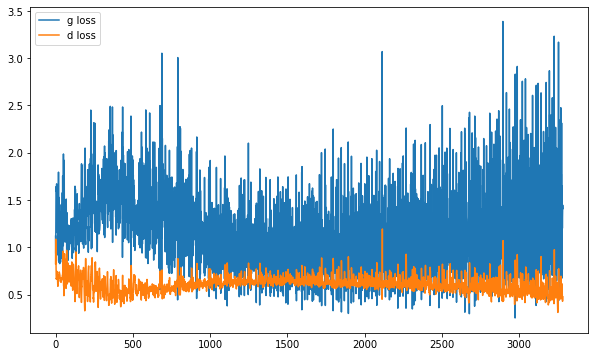

it: 3483; g_loss: 2.530578374862671; d_loss: 0.7026519775390625; avg_real_score: 0.8690311312675476; avg_fake_score: 0.09064094722270966: : 200it [00:21,  9.46it/s]

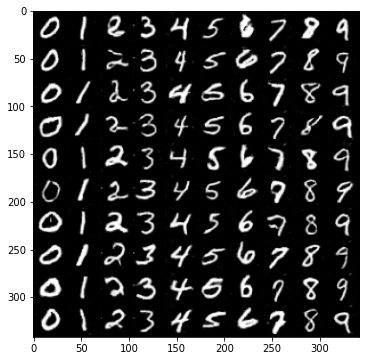

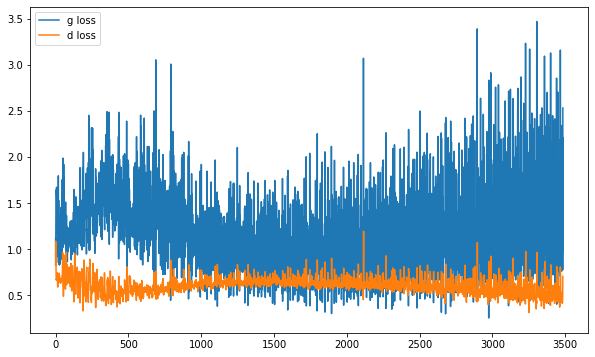

it: 3683; g_loss: 0.7478228807449341; d_loss: 0.38863083720207214; avg_real_score: 0.534050464630127; avg_fake_score: 0.4888916611671448: : 400it [00:42,  9.71it/s]

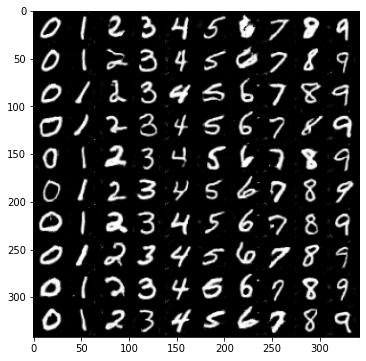

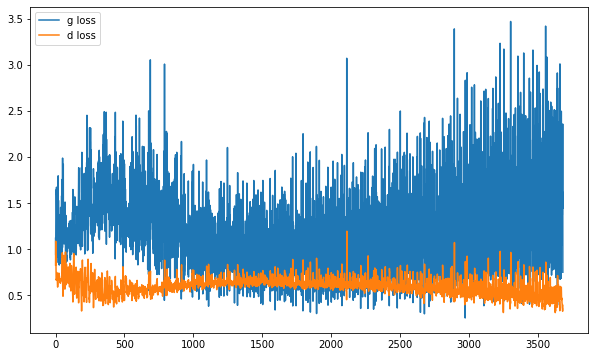

it: 3751; g_loss: 1.9841846227645874; d_loss: 0.41755032539367676; avg_real_score: 0.7819081544876099; avg_fake_score: 0.14947840571403503: : 469it [00:50,  9.33it/s]
it: 3752; g_loss: 1.5612549781799316; d_loss: 0.3554060757160187; avg_real_score: 0.6625607013702393; avg_fake_score: 0.23028819262981415: : 0it [00:00, ?it/s]

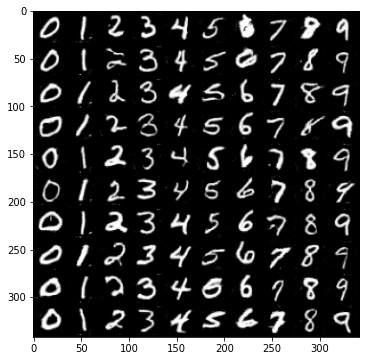

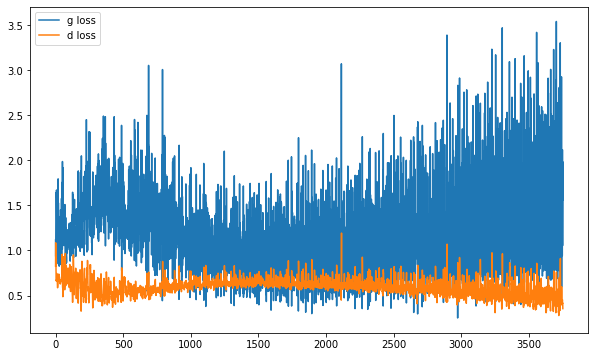

it: 3952; g_loss: 1.2077784538269043; d_loss: 0.3471810817718506; avg_real_score: 0.6305102109909058; avg_fake_score: 0.32117336988449097: : 200it [00:21,  9.45it/s]

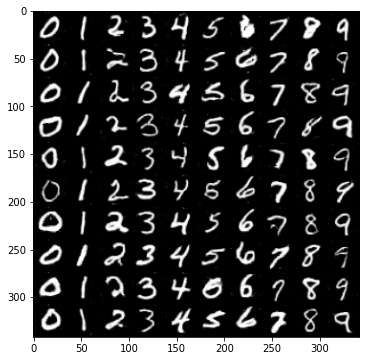

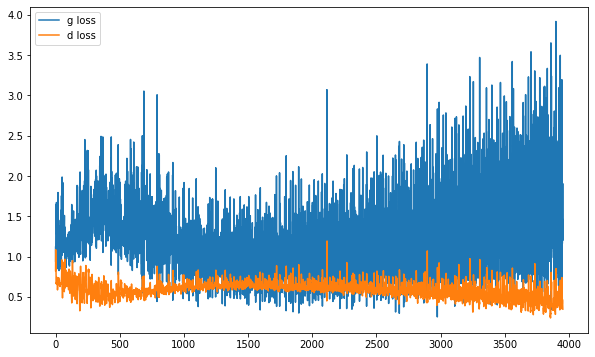

it: 4152; g_loss: 1.1713013648986816; d_loss: 0.40570762753486633; avg_real_score: 0.5587741136550903; avg_fake_score: 0.34684205055236816: : 400it [00:43,  9.51it/s]

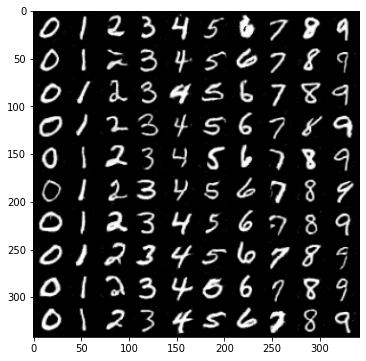

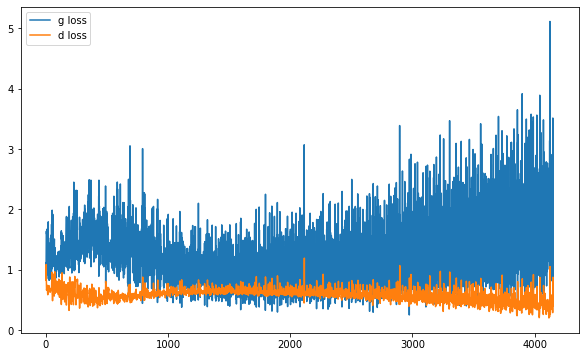

it: 4220; g_loss: 1.282609462738037; d_loss: 0.29289501905441284; avg_real_score: 0.7019345164299011; avg_fake_score: 0.29964160919189453: : 469it [00:50,  9.22it/s]
it: 4221; g_loss: 2.8259236812591553; d_loss: 0.3564346134662628; avg_real_score: 0.8858636617660522; avg_fake_score: 0.06770559400320053: : 0it [00:00, ?it/s]

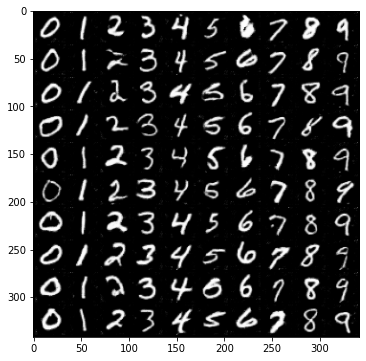

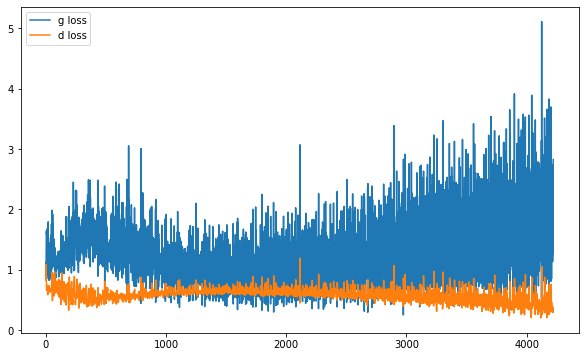

it: 4421; g_loss: 2.6436476707458496; d_loss: 0.6471678018569946; avg_real_score: 0.9370325803756714; avg_fake_score: 0.08486045897006989: : 200it [00:21,  9.51it/s]

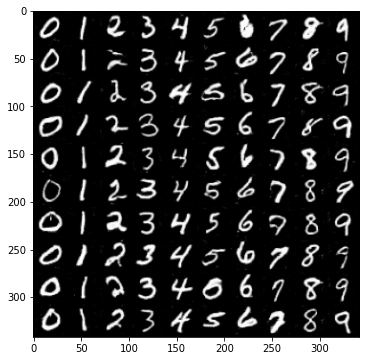

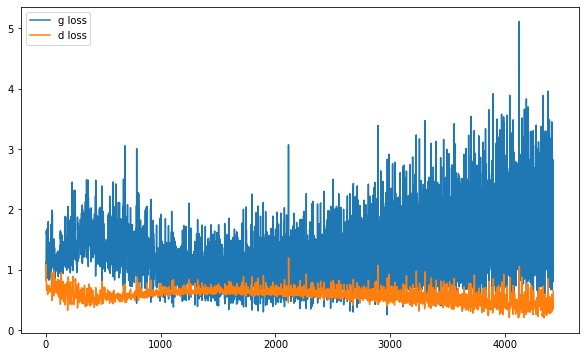

it: 4621; g_loss: 1.4045355319976807; d_loss: 0.31100594997406006; avg_real_score: 0.6710957288742065; avg_fake_score: 0.2763333022594452: : 400it [00:43,  9.70it/s]

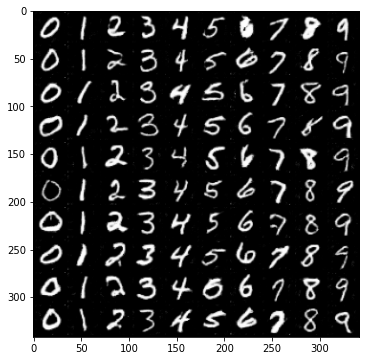

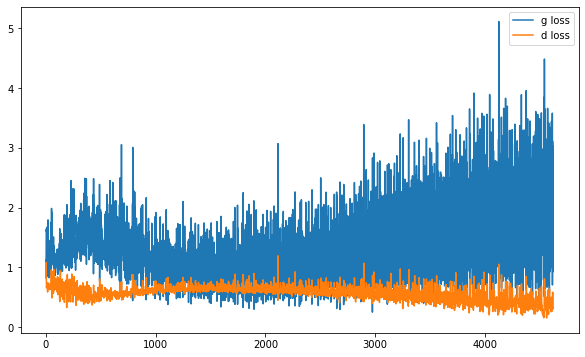

it: 4689; g_loss: 2.0949630737304688; d_loss: 0.19522982835769653; avg_real_score: 0.7607780694961548; avg_fake_score: 0.14217737317085266: : 469it [00:50,  9.27it/s]
it: 4690; g_loss: 1.8782756328582764; d_loss: 0.16820946335792542; avg_real_score: 0.8411312699317932; avg_fake_score: 0.17143204808235168: : 0it [00:00, ?it/s]

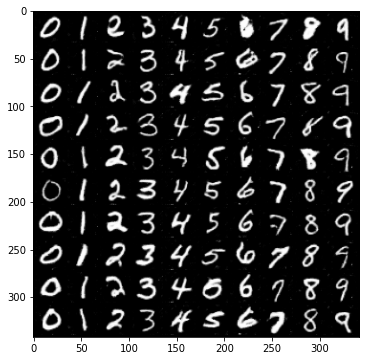

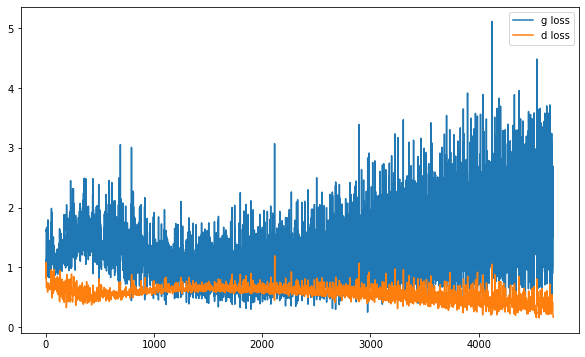

it: 4890; g_loss: 0.9517022371292114; d_loss: 0.3647598326206207; avg_real_score: 0.56801438331604; avg_fake_score: 0.4231778383255005: : 200it [00:21,  9.55it/s]   

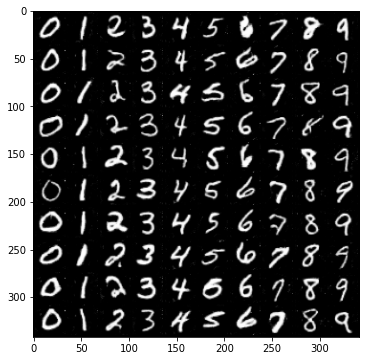

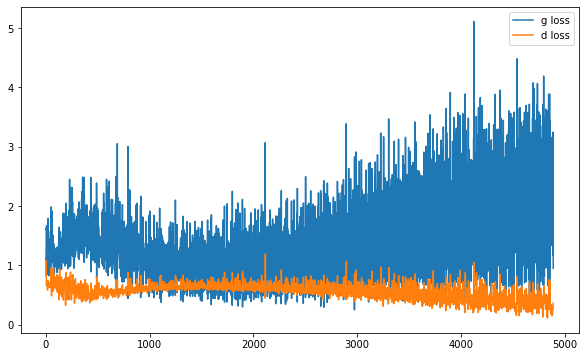

it: 5090; g_loss: 2.4017248153686523; d_loss: 0.3105389475822449; avg_real_score: 0.8176800012588501; avg_fake_score: 0.10874895751476288: : 400it [00:43,  9.60it/s]

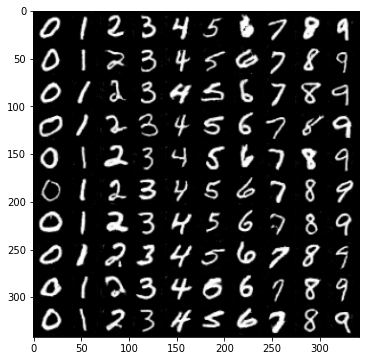

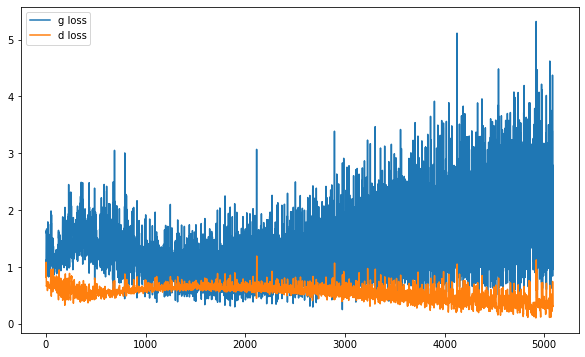

it: 5158; g_loss: 3.5084054470062256; d_loss: 0.18091514706611633; avg_real_score: 0.9410003423690796; avg_fake_score: 0.033919911831617355: : 469it [00:50,  9.21it/s]
it: 5159; g_loss: 2.5439107418060303; d_loss: 0.1444673091173172; avg_real_score: 0.8106293678283691; avg_fake_score: 0.0975167453289032: : 0it [00:00, ?it/s]

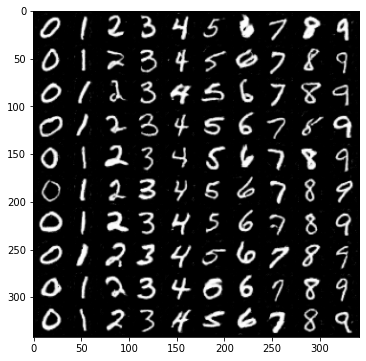

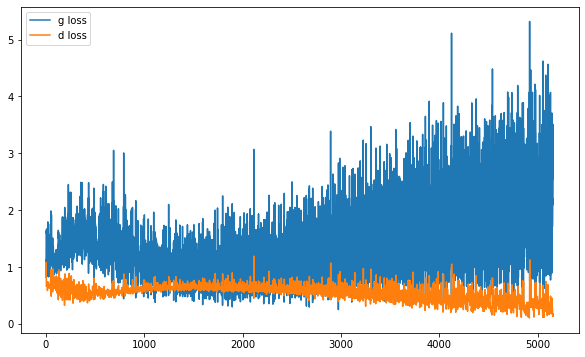

it: 5359; g_loss: 1.5226333141326904; d_loss: 0.33807456493377686; avg_real_score: 0.6541150808334351; avg_fake_score: 0.25324755907058716: : 200it [00:21,  9.56it/s]

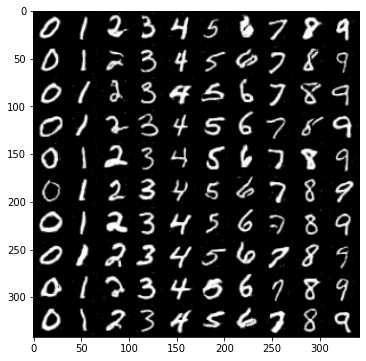

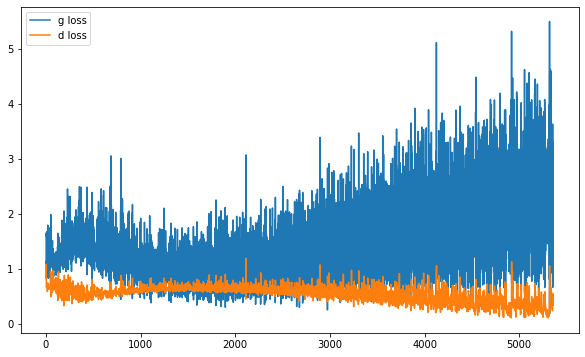

it: 5559; g_loss: 2.24570894241333; d_loss: 0.17580139636993408; avg_real_score: 0.889829158782959; avg_fake_score: 0.12743182480335236: : 400it [00:43,  9.52it/s]  

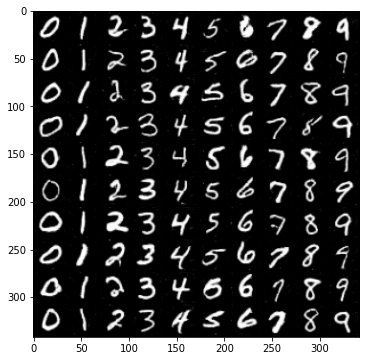

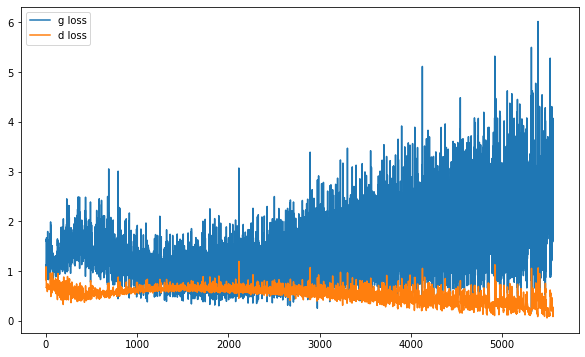

it: 5627; g_loss: 4.2858967781066895; d_loss: 0.2711114287376404; avg_real_score: 0.9303640127182007; avg_fake_score: 0.01724911667406559: : 469it [00:50,  9.20it/s]
it: 5628; g_loss: 1.318556547164917; d_loss: 0.328680157661438; avg_real_score: 0.5877541303634644; avg_fake_score: 0.3098360300064087: : 0it [00:00, ?it/s]

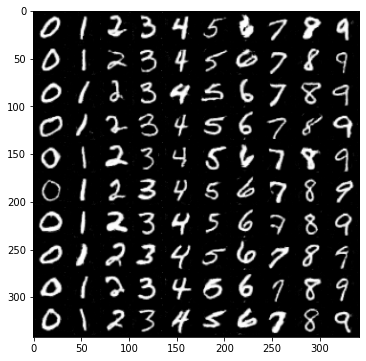

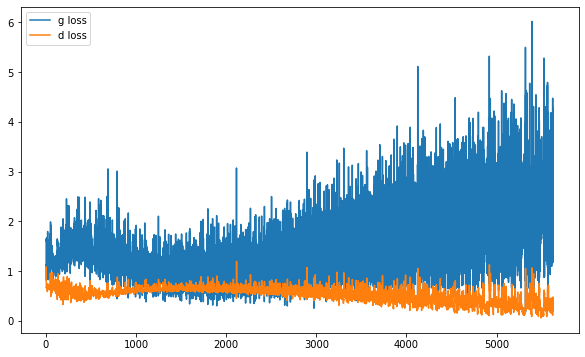

it: 5828; g_loss: 1.496131181716919; d_loss: 0.24568171799182892; avg_real_score: 0.7330939769744873; avg_fake_score: 0.2603720426559448: : 200it [00:21,  9.49it/s]

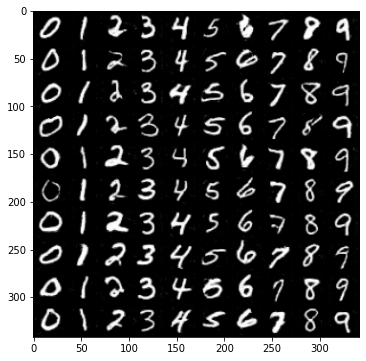

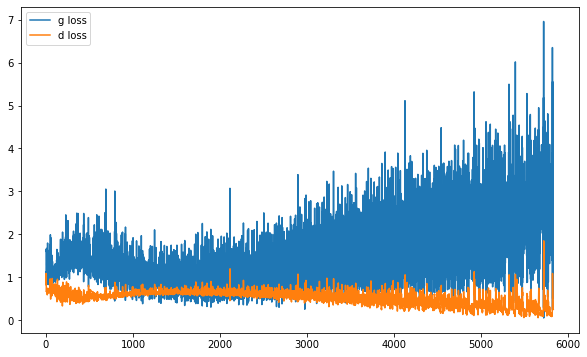

it: 6028; g_loss: 0.3210449814796448; d_loss: 0.7388064861297607; avg_real_score: 0.2797180414199829; avg_fake_score: 0.7559804916381836: : 400it [00:43,  9.79it/s] 

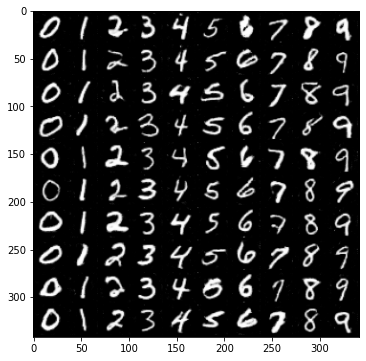

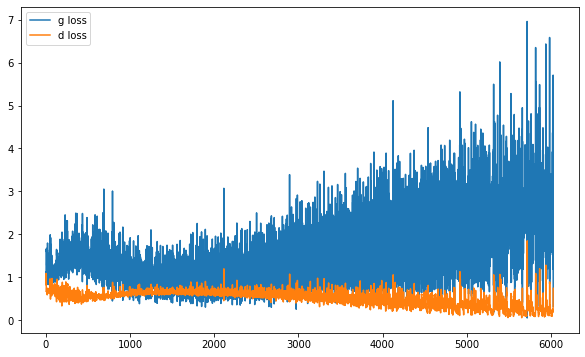

it: 6096; g_loss: 2.405106544494629; d_loss: 0.1465364396572113; avg_real_score: 0.8753064870834351; avg_fake_score: 0.10831614583730698: : 469it [00:50,  9.24it/s]
it: 6097; g_loss: 2.3778328895568848; d_loss: 0.1514292061328888; avg_real_score: 0.8668099641799927; avg_fake_score: 0.11392474919557571: : 0it [00:00, ?it/s]

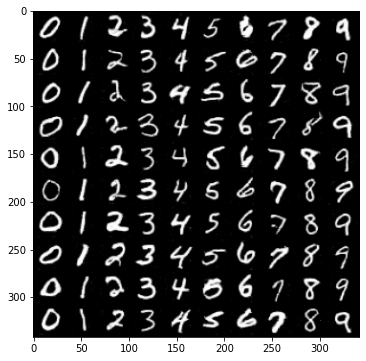

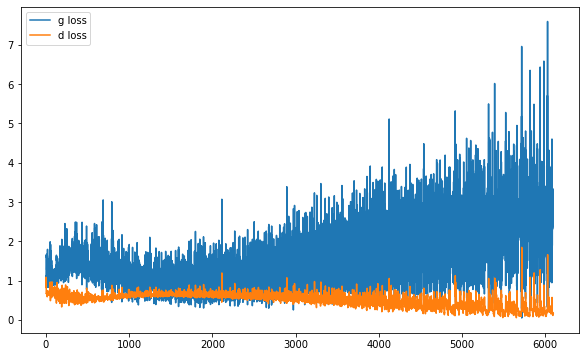

it: 6297; g_loss: 2.6331090927124023; d_loss: 0.09476669877767563; avg_real_score: 0.8835283517837524; avg_fake_score: 0.09311404824256897: : 200it [00:21,  9.47it/s]

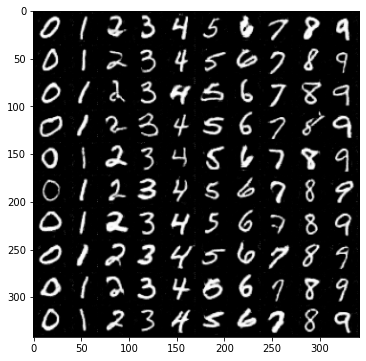

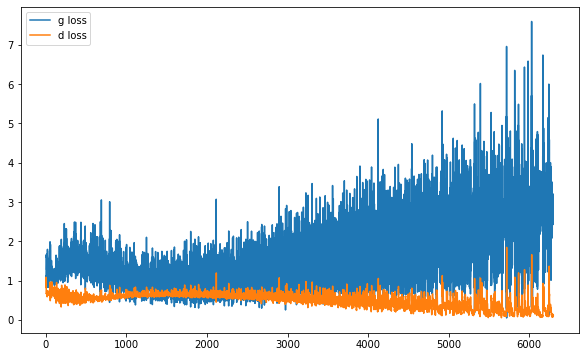

it: 6497; g_loss: 3.0513668060302734; d_loss: 0.09477238357067108; avg_real_score: 0.8910029530525208; avg_fake_score: 0.06312745809555054: : 400it [00:43,  9.39it/s] 

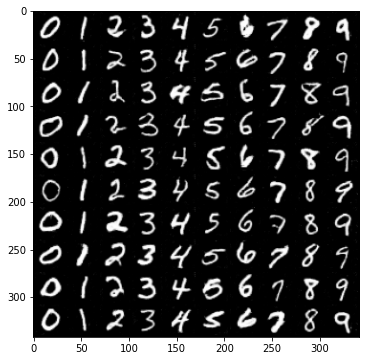

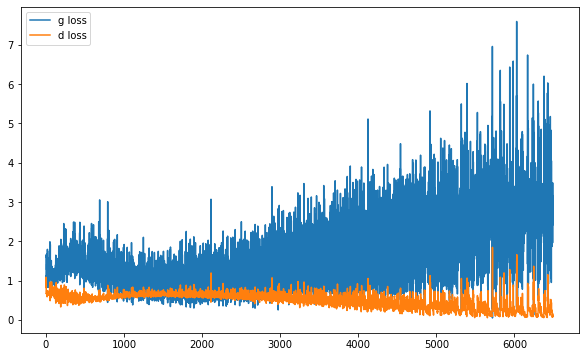

it: 6565; g_loss: 2.0370450019836426; d_loss: 0.1381426453590393; avg_real_score: 0.8092538118362427; avg_fake_score: 0.16287565231323242: : 469it [00:50,  9.21it/s]
it: 6566; g_loss: 3.5308103561401367; d_loss: 0.14875882863998413; avg_real_score: 0.9499932527542114; avg_fake_score: 0.03679323568940163: : 0it [00:00, ?it/s]

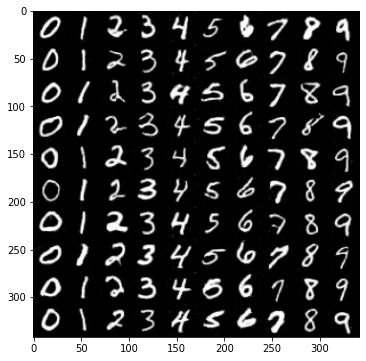

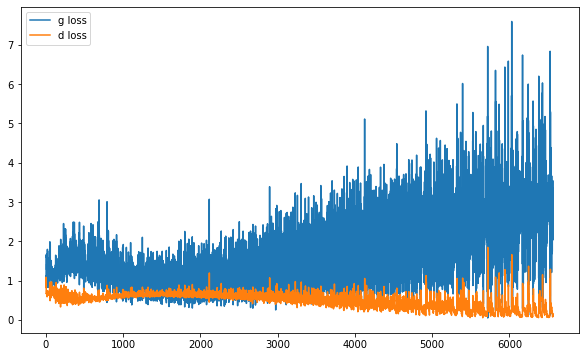

it: 6766; g_loss: 3.0713653564453125; d_loss: 0.05711077153682709; avg_real_score: 0.9179700613021851; avg_fake_score: 0.062241584062576294: : 200it [00:21,  9.72it/s]

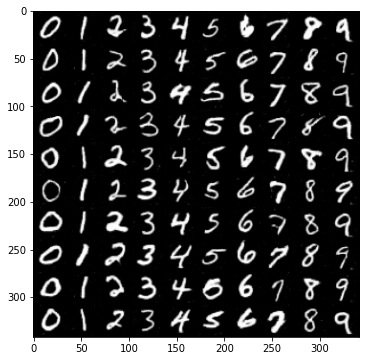

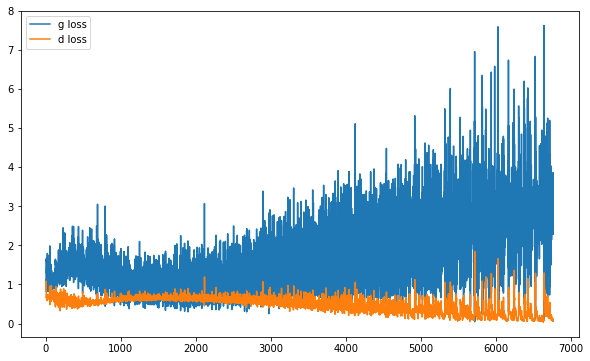

it: 6966; g_loss: 4.125519752502441; d_loss: 0.08582007139921188; avg_real_score: 0.9665945768356323; avg_fake_score: 0.02223622053861618: : 400it [00:43,  9.47it/s] 

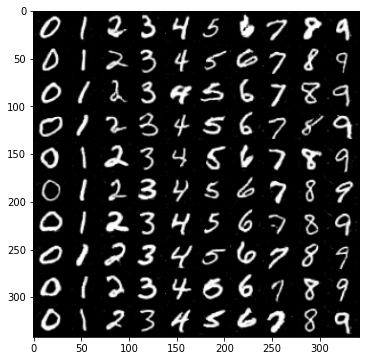

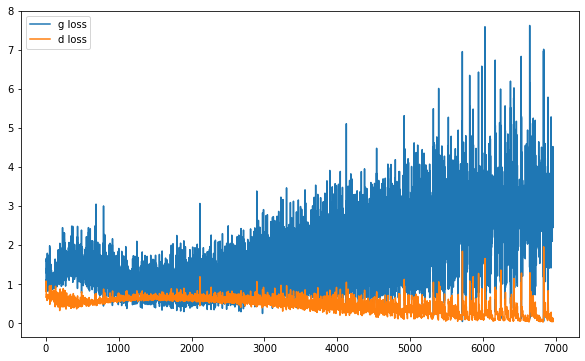

it: 7034; g_loss: 2.23836350440979; d_loss: 0.4273664951324463; avg_real_score: 0.7332741618156433; avg_fake_score: 0.13329584896564484: : 469it [00:51,  9.19it/s]


In [ ]:
nb_epochs = 15

g_losses = []
d_losses = []

j = 0

z_test = sample_z(100, nz)  # we generate the noise only once for testing

for epoch in range(nb_epochs):
    
    pbar = tqdm(enumerate(dataloader))
    for i, batch in pbar:
        im, labels = batch 
        im = im.to(device)
        
        
        y = F.one_hot(labels).float().to(device)
        
        cur_batch_size = im.shape[0]  
        
        
         # 1. sample a z vector 
        z = sample_z(cur_batch_size, nz)
        
        # 2. Generate a fake image

        fake_im = netG(z, y)

        # 3. Classify real image with D
        
        real_logits = netD(im, y)


        # 4. Classify fake image with D
       
        fake_logits = netD(fake_im.detach(), y)
         
        ###, 
        ### Discriminator
        ###
        d_loss = criterion(real_logits, get_labels_one(cur_batch_size).to(device))
        d_loss = (d_loss + criterion(fake_logits, get_labels_zero(cur_batch_size).to(device)))/2
        d_opt.zero_grad()
        d_loss.backward() # we need to retain graph=True to be able to calculate the gradient in the g backprop
        d_opt.step()

        
        ###
        ### Generator
        ###
        
        fake_logits = netD(fake_im, y)
        g_loss = criterion(fake_logits, get_labels_one(cur_batch_size).to(device)) 
        g_opt.zero_grad()
        g_loss.backward()
        g_opt.step()
        
        
        # Save Metrics
        
        d_losses.append(d_loss.item())
        g_losses.append(g_loss.item())
        
        avg_real_score = real_logits.mean().item()
        avg_fake_score = fake_logits.mean().item()

        pbar.set_description(f"it: {j}; g_loss: {g_loss}; d_loss: {d_loss}; avg_real_score: {avg_real_score}; avg_fake_score: {avg_fake_score}")
        
        if i % display_freq == 0:
            labels = torch.arange(0, 10).expand(size=(10, 10)).flatten().to(device)
            y = F.one_hot(labels).float().to(device)
            fake_im = netG(z_test, y)
            
            un_norm = renorm(fake_im) # for visualization
            
            grid = torchvision.utils.make_grid(un_norm, nrow=10)
            pil_grid = to_pil(grid)  
            
            plt.imshow(pil_grid)
            plt.show()
            
            
            plt.plot(range(len(g_losses)), g_losses, label='g loss')
            plt.plot(range(len(g_losses)), d_losses, label='d loss')
            
            plt.legend()
            plt.show()
            
        j += 1
            

tensor([0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 0, 1, 2, 3,
        4, 5, 6, 7, 8, 9, 0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 0, 1, 2, 3, 4, 5, 6, 7,
        8, 9, 0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 0, 1,
        2, 3, 4, 5, 6, 7, 8, 9, 0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 0, 1, 2, 3, 4, 5,
        6, 7, 8, 9], device='cuda:0') tensor([[1., 0., 0., 0., 0., 0., 0., 0., 0., 0.],
        [0., 1., 0., 0., 0., 0., 0., 0., 0., 0.],
        [0., 0., 1., 0., 0., 0., 0., 0., 0., 0.],
        [0., 0., 0., 1., 0., 0., 0., 0., 0., 0.],
        [0., 0., 0., 0., 1., 0., 0., 0., 0., 0.],
        [0., 0., 0., 0., 0., 1., 0., 0., 0., 0.],
        [0., 0., 0., 0., 0., 0., 1., 0., 0., 0.],
        [0., 0., 0., 0., 0., 0., 0., 1., 0., 0.],
        [0., 0., 0., 0., 0., 0., 0., 0., 1., 0.],
        [0., 0., 0., 0., 0., 0., 0., 0., 0., 1.],
        [1., 0., 0., 0., 0., 0., 0., 0., 0., 0.],
        [0., 1., 0., 0., 0., 0., 0., 0., 0., 0.],
        [0., 0., 1., 0., 0., 0., 0., 0., 0

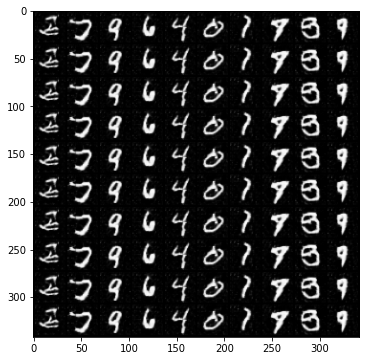

In [ ]:
labels = torch.arange(0, 10).expand(size=(10, 10)).flatten().to(device)
y = F.one_hot(labels).float().to(device)
fake_im = netG(z_test, y)
print(labels, y)
un_norm = renorm(fake_im) # for visualization

grid = torchvision.utils.make_grid(un_norm, nrow=10)
pil_grid = to_pil(grid)  

plt.imshow(pil_grid)
plt.show()

## 4.2 Testing
Visualization of the impact of z on generation. All digits in the same column have the same noise vector z.

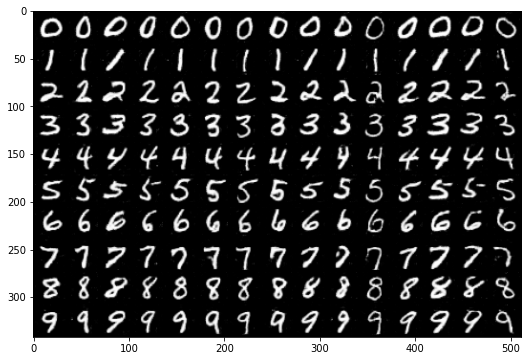

In [ ]:
n_ex = 15
n_classes = 10

z = sample_z(n_ex, nz).repeat(n_classes, 1) #.expand(10, nz)

netG.eval()

labels = torch.arange(n_classes).unsqueeze(0).reshape(-1, 1).repeat(1, n_ex).flatten().to(device)

ys = F.one_hot(labels).float()
fake_ims = netG(z, ys)

un_norm= renorm(fake_ims) # for visualization
grid = torchvision.utils.make_grid(un_norm, nrow=n_ex)
pil_grid = to_pil(grid)  

plt.imshow(pil_grid)
plt.show()
